# Sensor_TP Classification problem

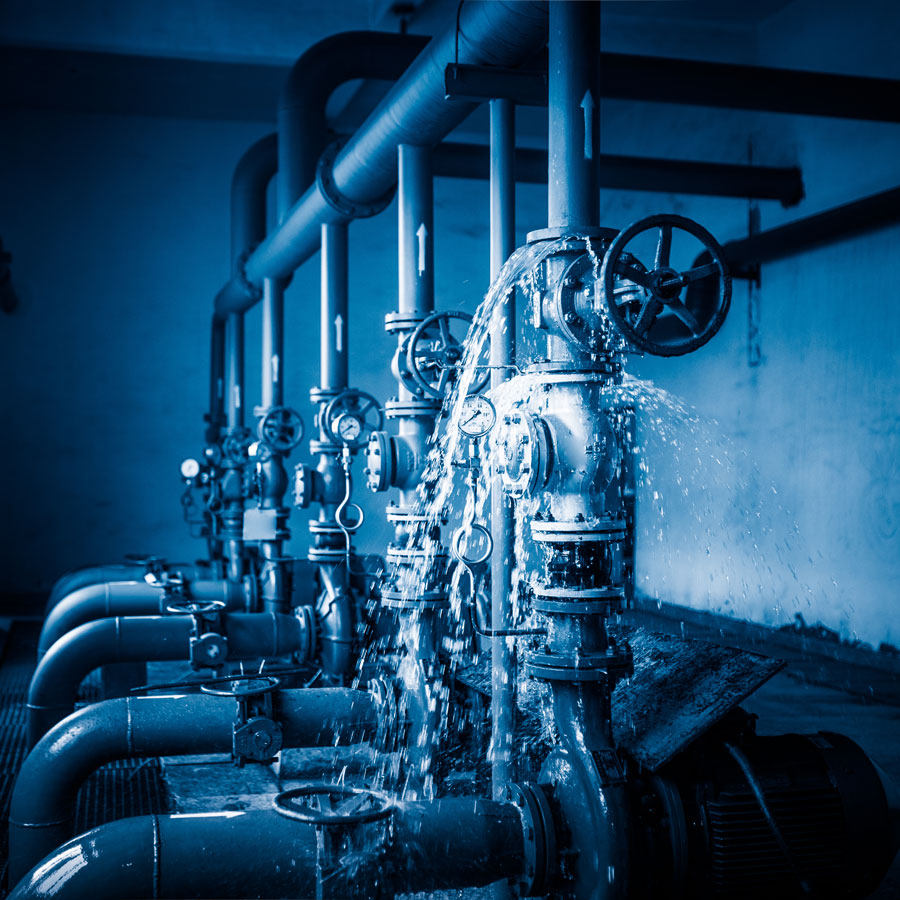

# Introduction: 

    This dataset contains measurements of 52 sensors each minute and the machinig status every minute. The machining status may be either NORMAL, BROKEN or RECOVERING. Every time the machine has BROKEN label, it is staying in RECOVERING state for a certain amount of time until the machine is fixed and turned back to NORMAL state. 
    
    Our goal is to explore and analyze the data we have and find some patterns during the EDA and finally train ML models and ANN to predict the machining status in accordance with sensors and timelines so that we will be able to use our models to avoid the breadwins of the pumps in the future.


# Objectives: 

    Our goals:

    1. To develop a ML model that predicts the Machine Status

    2. To develop a DL model that predicts the Machine Status

    3. To find insights into the sensor patterns and the possible reason for breakouts


# Description

    1. Type of problem: classification.

    2. 55 Variables: 53 Numerical, 1 datetime

        > 52 sensors

        > 1 timestamp 

    3. Target:

        > machine_status (NORMAL, BROKEN, RECOVERING)

    4. Steps applied:

        1. Importing a dataset

        2. Data analysis

        3. Feature engineering

            1. Dropping unnecessary variables

            2. Scaling

                > Standart Scaler

                > Robust Scaler

            4. Imputing NaN values   

            5. Splitting datasets into train / test datasets

                > Sliding window approach

                > Cross validation

        4. Training ML models

        5. fine-tuning of hyperparametes

            > GridSearchCV

        6. Training ANN

        7. Model evaluation and result analysis

    5. Algorithms used:

        1. RandomForest Classifier

        2. GradientBoosting Classifier

        3. KNeighbours Classifier

        4. Support Vector Classifier

        5. XGBoost Classifier

        6. ANN

    6. Evaluation Metrics:

        1. Confusion Matrix

        2. Roc-auc

        3. Precision

        4. Recall

        5. Accuracy

# STEP 0: Importing Libraries

In [1]:
#libraries for Loading dataset and linear algebra
import sys
import pandas as pd
import numpy as np
import scipy.stats as stats 
import math
from collections import Counter
import statistics

#libraries for datetime variables
from datetime import date, time, datetime

#libraries for Visualising data
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from mlens.visualization import corrmat
import altair as alt

#libraries for Spliting data set
from sklearn.model_selection import train_test_split, cross_val_score, cross_val_predict

#libraries for feature engineering
#libraries for imputation of NaN
from feature_engine.imputation import MeanMedianImputer
from sklearn.impute import KNNImputer

#libraries for discretization
from feature_engine.discretisation import DecisionTreeDiscretiser
from sklearn.model_selection import KFold
 

#libraries for feature selection
from feature_engine.selection import DropConstantFeatures, DropDuplicateFeatures, SmartCorrelatedSelection
from sklearn.feature_selection import SelectFromModel
from sklearn.feature_selection import RFECV, RFE
from sklearn.decomposition import PCA

#libraries for balancing the dataset
from imblearn.over_sampling import RandomOverSampler, SMOTE
from imblearn.under_sampling import RandomUnderSampler

#libraries for Feature magnitude
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler

#libraries for ML models: Classification
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from xgboost import XGBClassifier

#libraries for Super Learner
from mlens.ensemble import SuperLearner

#libraries for Deep Learning
import tensorflow as tf

#libraries for Pipelines and Column Tranformers
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer, make_column_selector

#libraries for hyperparametres tuning
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV

#libraries for Matrixes for evaluating models
from sklearn.metrics import f1_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import classification_report
from sklearn.metrics import precision_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import recall_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

#libraries for saving models
from pickle import dump, load

from jupyterthemes import jtplot
jtplot.style()
from sklearn import set_config
set_config(transform_output = "pandas")

[MLENS] backend: threading


# STEP 1: Importing dataset
    In this section, we import dataset using pandas

In [2]:
data_sensor = pd.read_csv('sensor_TP.csv')

In [3]:
data_sensor

,Unnamed: 0,timestamp,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,...,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51,machine_status
0,0,2018-04-01 00:00,2.465394,47.09201,53.211800,46.310760,634.375000,76.45975,13.41146,16.13136,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
1,1,2018-04-01 00:01,2.465394,47.09201,53.211800,46.310760,634.375000,76.45975,13.41146,16.13136,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
2,2,2018-04-01 00:02,2.444734,47.35243,53.211800,46.397570,638.888900,73.54598,13.32465,16.03733,...,41.66666,39.351852,65.39352,51.21528,38.194443,155.9606,67.12963,241.3194,203.7037,NORMAL
3,3,2018-04-01 00:03,2.460474,47.09201,53.168400,46.397568,628.125000,76.98898,13.31742,16.24711,...,40.88541,39.062500,64.81481,51.21528,38.194440,155.9606,66.84028,240.4514,203.1250,NORMAL
4,4,2018-04-01 00:04,2.445718,47.13541,53.211800,46.397568,636.458300,76.58897,13.35359,16.21094,...,41.40625,38.773150,65.10416,51.79398,38.773150,158.2755,66.55093,242.1875,201.3889,NORMAL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
220315,220315,2018-08-31 23:55,2.407350,47.69965,50.520830,43.142361,634.722229,64.59095,15.11863,16.65220,...,38.28125,68.287030,52.37268,48.32176,41.087960,212.3843,153.64580,NaN,231.1921,NORMAL
220316,220316,2018-08-31 23:56,2.400463,47.69965,50.564240,43.142361,630.902771,65.83363,15.15480,16.70284,...,38.28125,66.840280,50.63657,48.03241,40.798610,213.8310,156.25000,NaN,231.1921,NORMAL
220317,220317,2018-08-31 23:57,2.396528,47.69965,50.520830,43.142361,625.925903,67.29445,15.08970,16.70284,...,39.06250,65.393520,48.90046,48.03241,40.798610,217.3032,155.38190,NaN,232.0602,NORMAL
220318,220318,2018-08-31 23:58,2.406366,47.69965,50.520832,43.142361,635.648100,65.09175,15.11863,16.56539,...,40.62500,64.236110,47.74306,48.32176,40.509258,222.5116,153.93520,NaN,234.0856,NORMAL


In [4]:
data_sensor.iloc[17155: 17300]['machine_status']

17155        BROKEN
17156    RECOVERING
17157    RECOVERING
17158    RECOVERING
17159    RECOVERING
            ...    
17295    RECOVERING
17296    RECOVERING
17297    RECOVERING
17298    RECOVERING
17299    RECOVERING
Name: machine_status, Length: 145, dtype: object

In [5]:
data_sensor.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,220320.0,110159.500000,63601.049991,0.000000,55079.750000,110159.500000,165239.250000,220319.000000
sensor_00,210112.0,2.372221,0.412227,0.000000,2.438831,2.456539,2.499826,2.549016
sensor_01,219951.0,47.591611,3.296666,0.000000,46.310760,48.133678,49.479160,56.727430
sensor_02,220301.0,50.867392,3.666820,33.159720,50.390620,51.649300,52.777770,56.032990
sensor_03,220301.0,43.752481,2.418887,31.640620,42.838539,44.227428,45.312500,48.220490
sensor_04,220301.0,590.673936,144.023912,2.798032,626.620400,632.638916,637.615723,800.000000
sensor_05,220301.0,73.396414,17.298247,0.000000,69.976260,75.576790,80.912150,99.999880
sensor_06,215522.0,13.501537,2.163736,0.014468,13.346350,13.642940,14.539930,22.251160
sensor_07,214869.0,15.843152,2.201155,0.000000,15.907120,16.167530,16.427950,23.596640
sensor_08,215213.0,15.200721,2.037390,0.028935,15.183740,15.494790,15.697340,24.348960


In [6]:
data_sensor.rename(columns = {data_sensor.columns[0] : 'Samplenr'}, inplace = True)

In [7]:
data_sensor

,Samplenr,timestamp,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,...,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51,machine_status
0,0,2018-04-01 00:00,2.465394,47.09201,53.211800,46.310760,634.375000,76.45975,13.41146,16.13136,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
1,1,2018-04-01 00:01,2.465394,47.09201,53.211800,46.310760,634.375000,76.45975,13.41146,16.13136,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
2,2,2018-04-01 00:02,2.444734,47.35243,53.211800,46.397570,638.888900,73.54598,13.32465,16.03733,...,41.66666,39.351852,65.39352,51.21528,38.194443,155.9606,67.12963,241.3194,203.7037,NORMAL
3,3,2018-04-01 00:03,2.460474,47.09201,53.168400,46.397568,628.125000,76.98898,13.31742,16.24711,...,40.88541,39.062500,64.81481,51.21528,38.194440,155.9606,66.84028,240.4514,203.1250,NORMAL
4,4,2018-04-01 00:04,2.445718,47.13541,53.211800,46.397568,636.458300,76.58897,13.35359,16.21094,...,41.40625,38.773150,65.10416,51.79398,38.773150,158.2755,66.55093,242.1875,201.3889,NORMAL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
220315,220315,2018-08-31 23:55,2.407350,47.69965,50.520830,43.142361,634.722229,64.59095,15.11863,16.65220,...,38.28125,68.287030,52.37268,48.32176,41.087960,212.3843,153.64580,NaN,231.1921,NORMAL
220316,220316,2018-08-31 23:56,2.400463,47.69965,50.564240,43.142361,630.902771,65.83363,15.15480,16.70284,...,38.28125,66.840280,50.63657,48.03241,40.798610,213.8310,156.25000,NaN,231.1921,NORMAL
220317,220317,2018-08-31 23:57,2.396528,47.69965,50.520830,43.142361,625.925903,67.29445,15.08970,16.70284,...,39.06250,65.393520,48.90046,48.03241,40.798610,217.3032,155.38190,NaN,232.0602,NORMAL
220318,220318,2018-08-31 23:58,2.406366,47.69965,50.520832,43.142361,635.648100,65.09175,15.11863,16.56539,...,40.62500,64.236110,47.74306,48.32176,40.509258,222.5116,153.93520,NaN,234.0856,NORMAL


In [8]:
data_sensor['timestamp'] = pd.to_datetime(data_sensor['timestamp'])
data_sensor.set_index('timestamp',inplace=True)

In [9]:
data_sensor.describe()

,Samplenr,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,...,sensor_42,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51
count,220320.000000,210112.000000,219951.000000,220301.000000,220301.000000,220301.000000,220301.000000,215522.000000,214869.000000,215213.000000,...,220293.000000,220293.000000,220293.000000,220293.000000,220293.000000,220293.000000,220293.000000,220293.000000,143303.000000,204937.000000
mean,110159.500000,2.372221,47.591611,50.867392,43.752481,590.673936,73.396414,13.501537,15.843152,15.200721,...,35.453455,43.879591,42.656877,43.094984,48.018585,44.340903,150.889044,57.119968,183.049260,202.699667
std,63601.049991,0.412227,3.296666,3.666820,2.418887,144.023912,17.298247,2.163736,2.201155,2.037390,...,10.259521,11.044404,11.576355,12.837520,15.641284,10.442437,82.244957,19.143598,65.258650,109.588607
min,0.000000,0.000000,0.000000,33.159720,31.640620,2.798032,0.000000,0.014468,0.000000,0.028935,...,22.135416,24.479166,25.752316,26.331018,26.331018,27.199070,26.331018,26.620370,27.488426,27.777779
25%,55079.750000,2.438831,46.310760,50.390620,42.838539,626.620400,69.976260,13.346350,15.907120,15.183740,...,32.812500,39.583330,36.747684,36.747684,40.509258,39.062500,83.912030,47.743060,167.534700,179.108800
50%,110159.500000,2.456539,48.133678,51.649300,44.227428,632.638916,75.576790,13.642940,16.167530,15.494790,...,35.156250,42.968750,40.509260,40.219910,44.849540,42.534720,138.020800,52.662040,193.865700,197.338000
75%,165239.250000,2.499826,49.479160,52.777770,45.312500,637.615723,80.912150,14.539930,16.427950,15.697340,...,36.979164,46.614580,45.138890,44.849540,51.215280,46.585650,208.333300,60.763890,219.907400,216.724500
max,220319.000000,2.549016,56.727430,56.032990,48.220490,800.000000,99.999880,22.251160,23.596640,24.348960,...,374.218800,408.593700,1000.000000,320.312500,370.370400,303.530100,561.632000,464.409700,1000.000000,1000.000000


In [10]:
print("Basic information of the Dataset")
print("-" * 50)
print("Total samples (rows): {}".format(data_sensor.shape[0]))
print("Total variables (columns): {}".format(data_sensor.shape[1]))
print("-" * 50)
print()
data_sensor.info()

Basic information of the Dataset
--------------------------------------------------
Total samples (rows): 220320
Total variables (columns): 54
--------------------------------------------------

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 220320 entries, 2018-04-01 00:00:00 to 2018-08-31 23:59:00
Data columns (total 54 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Samplenr        220320 non-null  int64  
 1   sensor_00       210112 non-null  float64
 2   sensor_01       219951 non-null  float64
 3   sensor_02       220301 non-null  float64
 4   sensor_03       220301 non-null  float64
 5   sensor_04       220301 non-null  float64
 6   sensor_05       220301 non-null  float64
 7   sensor_06       215522 non-null  float64
 8   sensor_07       214869 non-null  float64
 9   sensor_08       215213 non-null  float64
 10  sensor_09       215725 non-null  float64
 11  sensor_10       220301 non-null  float64
 12  sensor_11  

    We can see that all sensors data are numerical types (float64) and 'machine_status' variable (target) is categorical

## dataset with 'NORMAL' Machine_status

In [11]:
data_sensor_NORMAL = data_sensor[data_sensor['machine_status'] == 'NORMAL']
data_sensor_NORMAL

,Samplenr,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,...,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51,machine_status
timestamp,,,,,,,,,,,,,,,,,,,,,
2018-04-01 00:00:00,0,2.465394,47.09201,53.211800,46.310760,634.375000,76.45975,13.41146,16.13136,15.56713,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
2018-04-01 00:01:00,1,2.465394,47.09201,53.211800,46.310760,634.375000,76.45975,13.41146,16.13136,15.56713,...,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889,NORMAL
2018-04-01 00:02:00,2,2.444734,47.35243,53.211800,46.397570,638.888900,73.54598,13.32465,16.03733,15.61777,...,41.66666,39.351852,65.39352,51.21528,38.194443,155.9606,67.12963,241.3194,203.7037,NORMAL
2018-04-01 00:03:00,3,2.460474,47.09201,53.168400,46.397568,628.125000,76.98898,13.31742,16.24711,15.69734,...,40.88541,39.062500,64.81481,51.21528,38.194440,155.9606,66.84028,240.4514,203.1250,NORMAL
2018-04-01 00:04:00,4,2.445718,47.13541,53.211800,46.397568,636.458300,76.58897,13.35359,16.21094,15.69734,...,41.40625,38.773150,65.10416,51.79398,38.773150,158.2755,66.55093,242.1875,201.3889,NORMAL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-31 23:55:00,220315,2.407350,47.69965,50.520830,43.142361,634.722229,64.59095,15.11863,16.65220,15.65393,...,38.28125,68.287030,52.37268,48.32176,41.087960,212.3843,153.64580,NaN,231.1921,NORMAL
2018-08-31 23:56:00,220316,2.400463,47.69965,50.564240,43.142361,630.902771,65.83363,15.15480,16.70284,15.65393,...,38.28125,66.840280,50.63657,48.03241,40.798610,213.8310,156.25000,NaN,231.1921,NORMAL
2018-08-31 23:57:00,220317,2.396528,47.69965,50.520830,43.142361,625.925903,67.29445,15.08970,16.70284,15.69734,...,39.06250,65.393520,48.90046,48.03241,40.798610,217.3032,155.38190,NaN,232.0602,NORMAL


In [12]:
sensor_NORMAL_percents = (len(data_sensor_NORMAL) / len(data_sensor)) * 100
sensor_NORMAL_percents

93.42592592592592

    more than 93% of all the dataset the machining status was "NORMAL"

## dataset with 'BROKEN' Machine_status

In [13]:
data_sensor_BROKEN = data_sensor[data_sensor['machine_status'] == 'BROKEN']
data_sensor_BROKEN

,Samplenr,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,...,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51,machine_status
timestamp,,,,,,,,,,,,,,,,,,,,,
2018-04-12 21:55:00,17155,0.000000,53.342010,52.821180,43.402775,202.526031,49.79289,3.219039,16.890910,16.869210,...,50.78125,50.92593,51.215280,50.636570,46.006940,409.143500,121.527800,401.909700,324.6528,BROKEN
2018-04-18 00:30:00,24510,1.093982,42.534720,47.699650,41.449650,206.038757,60.30106,12.304690,15.154800,14.185470,...,42.70833,34.72222,31.539350,34.432870,33.275460,59.895830,44.560180,177.662000,183.7384,BROKEN
2018-05-19 03:18:00,69318,2.258796,47.265630,52.734370,43.446178,200.115738,66.14643,13.592300,15.914350,15.147570,...,39.06250,35.01157,37.905090,39.062500,45.428240,144.675900,49.768520,246.238400,257.5231,BROKEN
2018-05-25 00:30:00,77790,2.321759,47.482640,51.475693,42.795136,612.152800,67.30158,14.062500,16.608800,15.943290,...,202.34370,65.68287,57.870370,127.893500,153.935200,155.381900,65.682870,220.196800,267.3611,BROKEN
2018-06-28 22:00:00,128040,0.364005,40.190970,45.225690,40.190971,201.368622,0.00000,11.335360,15.270540,15.183740,...,32.29166,28.06713,28.067129,29.513889,29.224537,29.224537,29.513889,32.407406,NaN,BROKEN
2018-07-08 00:11:00,141131,0.001968,45.138890,52.907990,45.355900,500.000000,1.40131,0.028935,0.036169,0.036169,...,36.19791,37.32639,35.300930,38.194440,43.402780,99.537030,44.849540,192.129600,174.7685,BROKEN
2018-07-25 14:00:00,166440,2.318808,45.833332,52.994790,43.880210,420.503448,72.52040,14.185470,16.247110,15.697340,...,51.30208,52.10200,52.662040,67.129630,43.981480,230.324100,69.733800,NaN,205.7292,BROKEN


    We can see that there are only 7 accidents with broken pumps

In [14]:
sensor_BROKEN_percents = (len(data_sensor_BROKEN) / len(data_sensor)) * 100
sensor_BROKEN_percents

0.003177196804647785

## dataset with 'RECOVERING' Machine_status

In [15]:
data_sensor_RECOVERING = data_sensor[data_sensor['machine_status'] == 'RECOVERING']
data_sensor_RECOVERING

,Samplenr,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,...,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51,machine_status
timestamp,,,,,,,,,,,,,,,,,,,,,
2018-04-12 21:56:00,17156,0.000000,53.55902,52.777770,43.402775,204.725098,53.74214,3.045428,17.42621,15.740740,...,49.479160,50.34722,51.21528,49.18982,49.47917,431.7130,133.1019,419.2708,341.7245,RECOVERING
2018-04-12 21:57:00,17157,0.000000,53.55902,52.777770,43.402775,201.137131,52.49996,7.537616,13.53443,9.324364,...,48.177080,49.76852,50.92593,48.03241,53.81944,451.3889,140.0463,433.1597,466.1458,RECOVERING
2018-04-12 21:58:00,17158,0.000000,52.77777,52.690970,43.402770,204.030655,57.19875,7.609953,16.60880,16.203700,...,46.875000,48.03241,50.34722,47.45370,58.15972,466.4352,144.9653,442.7083,366.0301,RECOVERING
2018-04-12 21:59:00,17159,0.000000,52.60416,52.734370,43.446180,203.567688,50.96181,7.573785,16.70284,16.160300,...,45.833330,47.45370,49.76852,46.58565,63.65741,474.8264,149.0162,449.6528,374.4213,RECOVERING
2018-04-12 22:00:00,17160,NaN,52.51736,52.690970,43.446180,203.567688,49.78948,7.559317,16.56539,16.239870,...,44.270830,46.29630,48.03241,45.13889,75.23148,477.7199,162.6157,448.7847,356.1921,RECOVERING
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-07-25 15:11:00,166511,0.310880,46.48438,51.171870,46.527775,152.526031,60.77931,15.089700,17.62876,18.200230,...,59.895830,77.83565,73.78472,58.44907,58.15972,295.4283,260.4167,NaN,211.2269,RECOVERING
2018-07-25 15:12:00,166512,0.304977,46.39757,51.085070,46.527770,152.178802,61.24545,15.089700,17.62153,18.243630,...,58.854160,75.81019,69.44444,56.71296,58.15972,278.9352,244.2130,NaN,195.0231,RECOVERING
2018-07-25 15:13:00,166513,0.303993,46.31076,51.085070,46.484380,151.021393,52.94817,15.125870,17.62153,18.236400,...,57.552080,81.30787,65.10416,53.81944,60.47454,267.9398,229.1667,NaN,180.5556,RECOVERING


In [16]:
sensor_RECOVERING_percents = (len(data_sensor_RECOVERING) / len(data_sensor)) * 100
sensor_RECOVERING_percents

6.570896877269426

## Function for displaying balance

In [17]:
def show_balance(variable, labels, suptitle):
    plt.figure(figsize = (16, 8))
    plt.suptitle(suptitle, fontsize = '20', fontweight = 'heavy')
    values = data_sensor[variable].value_counts(ascending = True)
    #Pie Chart
    plt.subplot(1, 2, 1)
    plt.title('Pie chart', fontsize = '16.5', fontweight = 'bold')
    ax = plt.pie(values,
                labels = labels,
                pctdistance = 0.7,
                autopct='%.2f%%',
                colors = ('#00787a', '#255254', '#303035', '#574437', '#af4a33'))
    
    #Histogram
    plt.subplot(1, 2, 2)
    plt.title('Histogram', fontsize = '16.5', fontweight = 'bold')
    ax = sns.countplot(x = variable,
                       data = data_sensor,
                       alpha = 0.9,
                       order = values.index,
                       palette = ['#00787a', '#255254', '#303035', '#574437', '#af4a33'])
    ax.set(xticklabels = (labels))
    
    #Assigning labels
    ax.bar_label(container = ax.containers[0], labels = values)
    plt.tight_layout()

## Exploring Machine_status balance

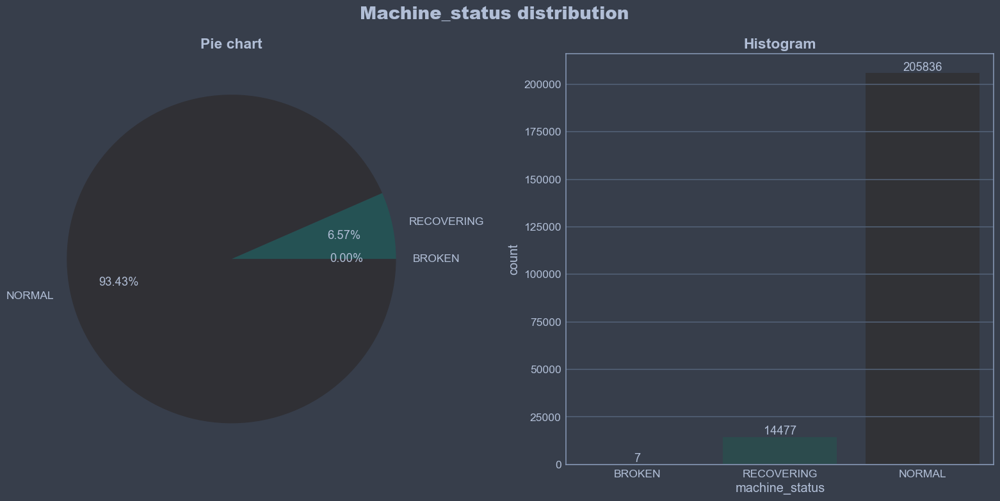

In [18]:
labels = ['BROKEN', 'RECOVERING', 'NORMAL']
show_balance('machine_status', labels, 'Machine_status distribution')

    We can see that 'NORMAL' takes more than 93 percent of the 'machine_process' variables, while 'RECOVERING' takes almost 7% and "BROKEN" takes less than 1%

In [19]:
row_numbers_machine_BROKEN = list(data_sensor_BROKEN['Samplenr'].values)

In [20]:
recovering_times_hours = []

for i in row_numbers_machine_BROKEN:
    
    print('\nMachine in status BROKEN in row: {}'.format(i))
    
    go_futher = True
    
    j = i
    
    while go_futher:
        
        j += 1
        
        machine_status_in_row_j = data_sensor.iloc[j]['machine_status']
        
        if machine_status_in_row_j != 'RECOVERING':
            
            go_futher = False
            
    print('Machine went back to status {0} in row: {1}'.format(machine_status_in_row_j, j - 1))
    
    recovering_hours = (j - i) / 60
    
    recovering_days = recovering_hours / 24
    
    print('Machine was in RECOVERING state for {0:.1f} hours / {1:.1f} days'.format(recovering_hours, recovering_days))
    print('Machine has Broken in: {}'.format(data_sensor.index[i]))
    
    recovering_times_hours.append(recovering_hours)


Machine in status BROKEN in row: 17155
Machine went back to status NORMAL in row: 18099
Machine was in RECOVERING state for 15.8 hours / 0.7 days
Machine has Broken in: 2018-04-12 21:55:00

Machine in status BROKEN in row: 24510
Machine went back to status NORMAL in row: 27620
Machine was in RECOVERING state for 51.9 hours / 2.2 days
Machine has Broken in: 2018-04-18 00:30:00

Machine in status BROKEN in row: 69318
Machine went back to status NORMAL in row: 70630
Machine was in RECOVERING state for 21.9 hours / 0.9 days
Machine has Broken in: 2018-05-19 03:18:00

Machine in status BROKEN in row: 77790
Machine went back to status NORMAL in row: 78395
Machine was in RECOVERING state for 10.1 hours / 0.4 days
Machine has Broken in: 2018-05-25 00:30:00

Machine in status BROKEN in row: 128040
Machine went back to status NORMAL in row: 136430
Machine was in RECOVERING state for 139.8 hours / 5.8 days
Machine has Broken in: 2018-06-28 22:00:00

Machine in status BROKEN in row: 141131
Machin

In [21]:
recovering_times_hours

[15.75, 51.85, 21.883333333333333, 10.1, 139.85, 0.7, 1.2666666666666666]

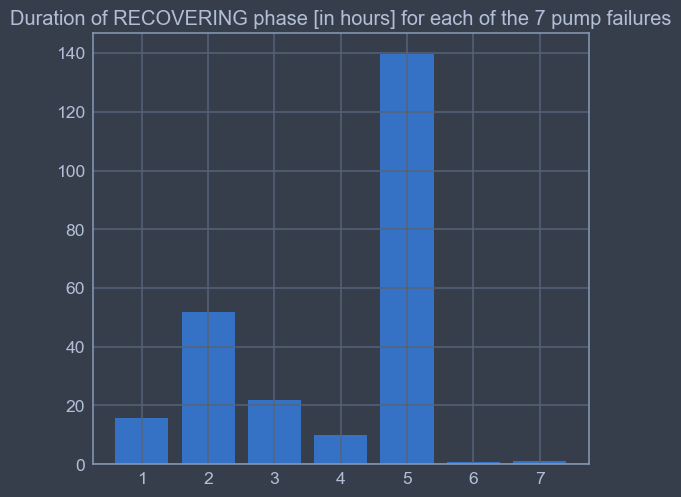

In [22]:
xpos = np.arange(len(recovering_times_hours))

fig, ax = plt.subplots()

ax.bar(xpos, recovering_times_hours)

ax.set_xticks(xpos)
ax.set_xticklabels(xpos+1)
ax.set_title('Duration of RECOVERING phase [in hours] for each of the 7 pump failures')

plt.show()

    It can be noticed that 4 out of 7 breakouts were fixed under the next 24 hours. However the second and fifth breakouts took more than 50 hours (2 days). Especcialy the fifth breakout which took more than 5 days to fix. 

## Exploring NaN values

In [23]:
def find_NaN(df):
    vars_with_na = [var for var in df.columns if df[var].isnull().sum() > 1]
    data_na = df[vars_with_na].isnull().sum()
    data_na = pd.DataFrame(data_na.reset_index())
    data_na.columns = ['variable', 'na_amount']
    data_na.sort_values(by = 'na_amount', ascending = False, inplace = True)
    data_na.insert(2, 'na_percentage', [var for var in df[data_na.variable].isnull().mean()], True)
    data_na['variable_type'] = [var for var in df[data_na.variable].dtypes]
    return data_na.reset_index().drop('index', axis = 1)

In [24]:
data_na = find_NaN(data_sensor)
data_na

,variable,na_amount,na_percentage,variable_type
0,sensor_15,220320,1.000000,float64
1,sensor_50,77017,0.349569,float64
2,sensor_51,15383,0.069821,float64
3,sensor_00,10208,0.046333,float64
4,sensor_07,5451,0.024741,float64
5,sensor_08,5107,0.023180,float64
6,sensor_06,4798,0.021777,float64
7,sensor_09,4595,0.020856,float64
8,sensor_01,369,0.001675,float64
9,sensor_30,261,0.001185,float64


### Visualizing NaN values

In [25]:
def plot_na(df):
    fig, ax = plt.subplots(figsize = (12, 4))
    plt.xticks(df.index, df['variable'], rotation = 75)
    ax.axhline(y = 0.45, color = 'red')
    ax.bar(df.index, df['na_percentage'])
    ax.set_ylabel('percentage of NaN values')
    plt.show()

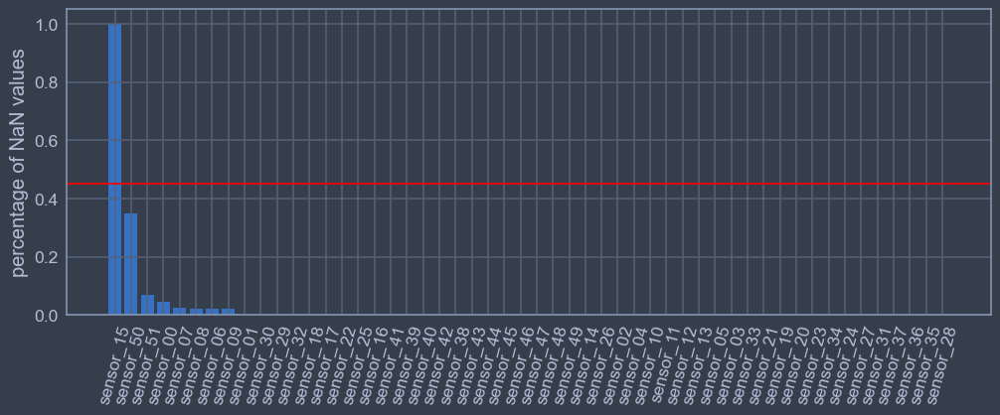

In [26]:
plot_na(data_na)

    We can see that the amount of missing values in variable 'sensor_15' is 100% which means that there is no point to maintain this variable, because it has no prediction power. other variables has less than 45% of missing values which is acceptible and will be imputed in the feature preprocessing steps

### Deleting variable "sensor_15"

In [27]:
data_sensor.drop(['sensor_15'], axis = 1, inplace = True)

## Exploring feature distribution

In [28]:
def diagnostic_plots(df, variable):
    plt.figure(figsize = (12, 5))
    plt.suptitle(variable)
    
    #histogramma
    plt.subplot(1, 3, 1)
    df[variable].hist(bins = 10, color = 'mediumseagreen')
    plt.title('histogramma')
    
    #Q-Q plot
    plt.subplot(1, 3, 2)
    stats.probplot(df[variable], dist = 'norm', plot = plt)
    plt.title('Q-Q plot')
    
    #boxplot
    plt.subplot(1, 3, 3)
    sns.boxplot(y = df[variable], color = 'violet')
    plt.title('boxplot')
    
    plt.show()

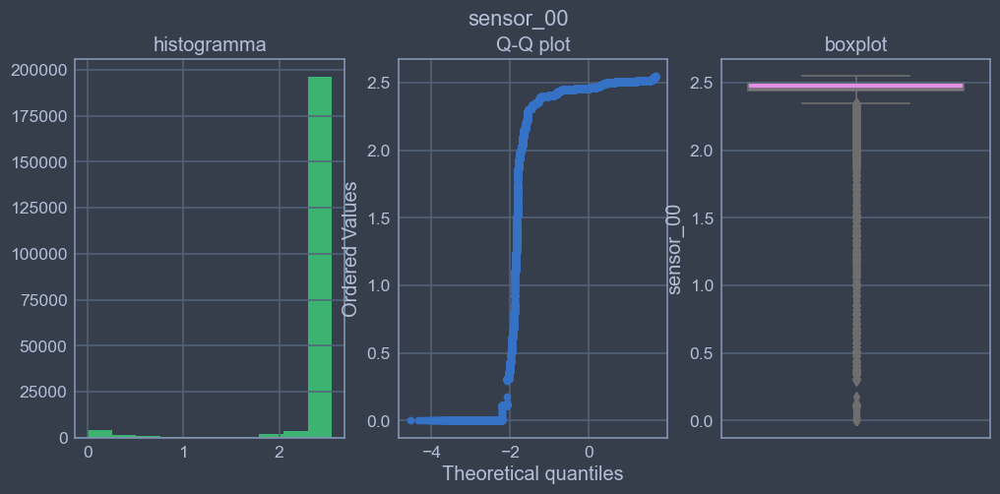

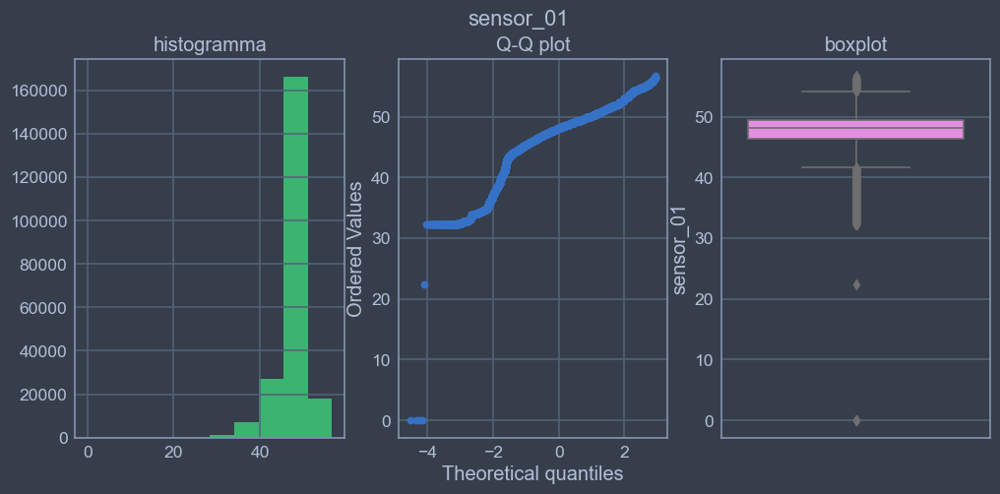

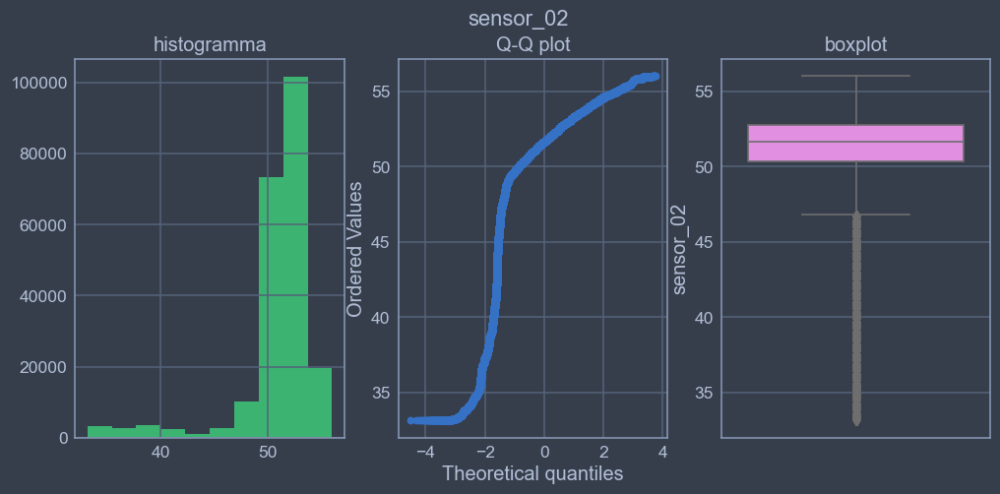

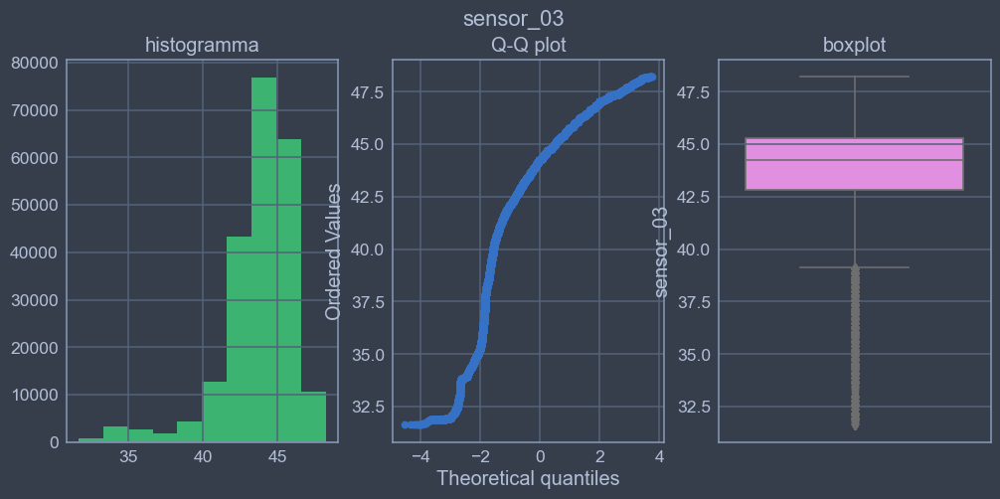

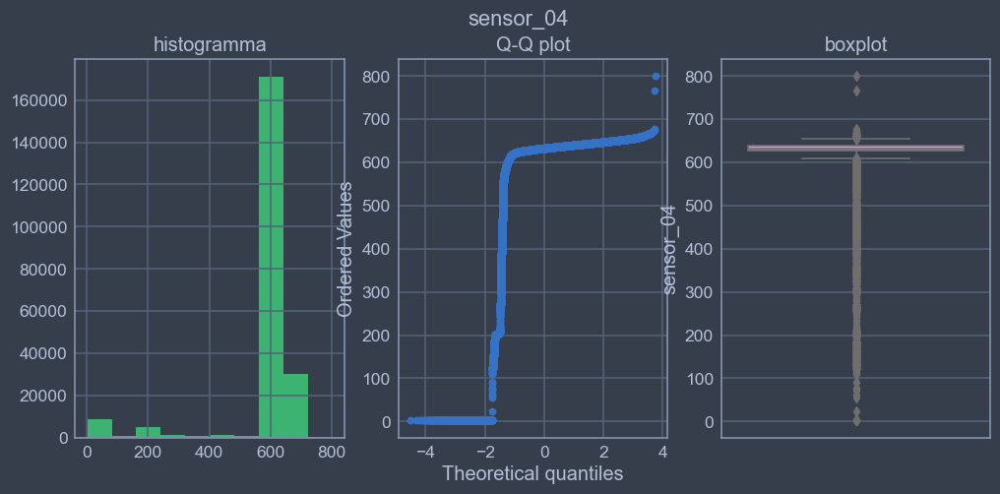

...

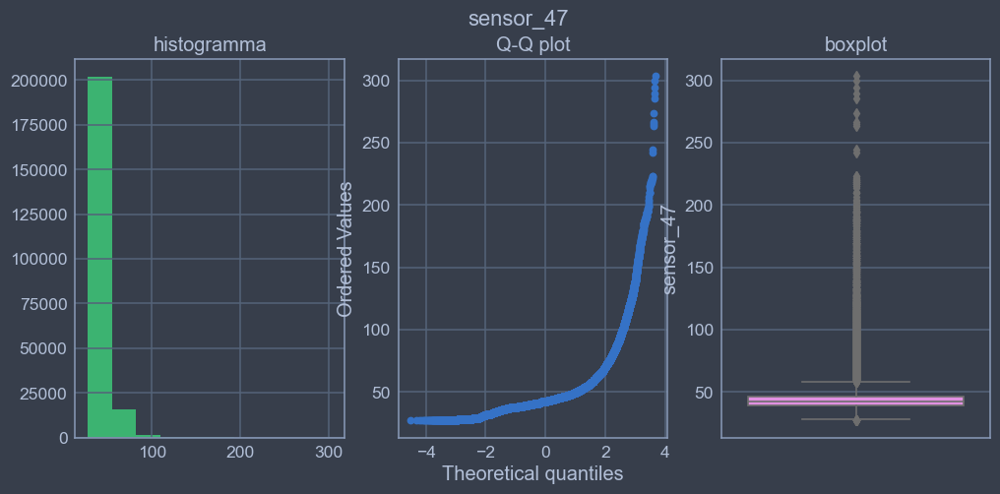

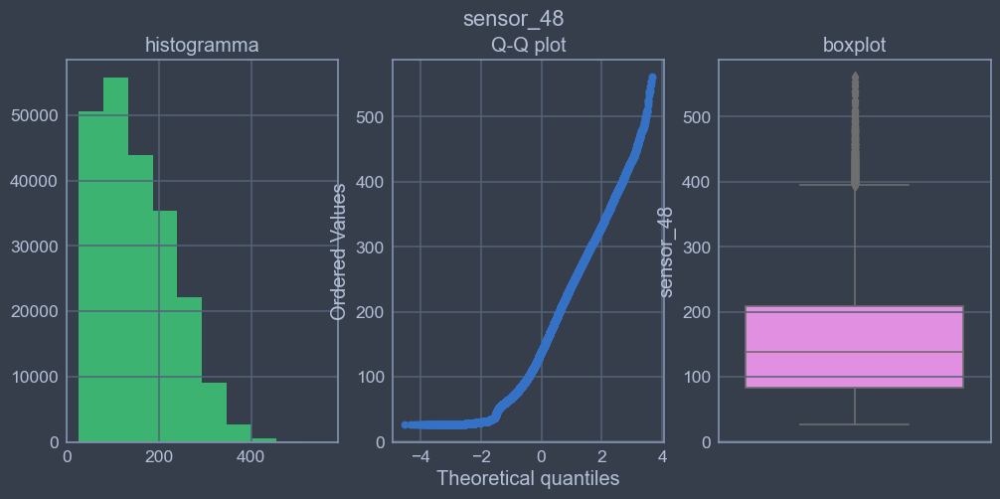

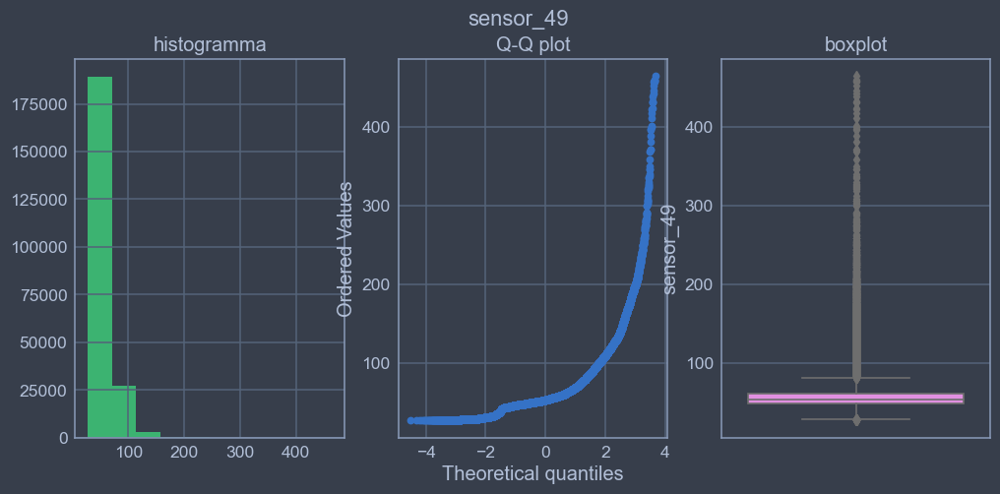

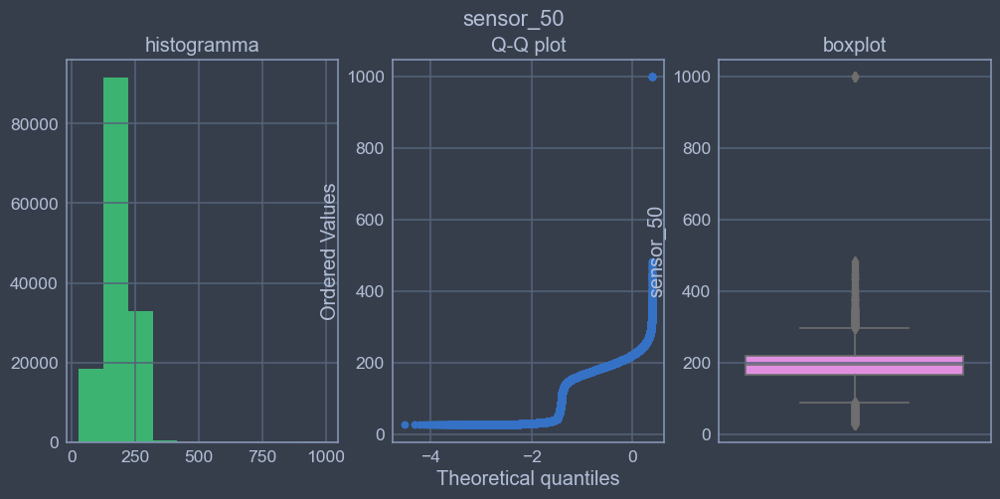

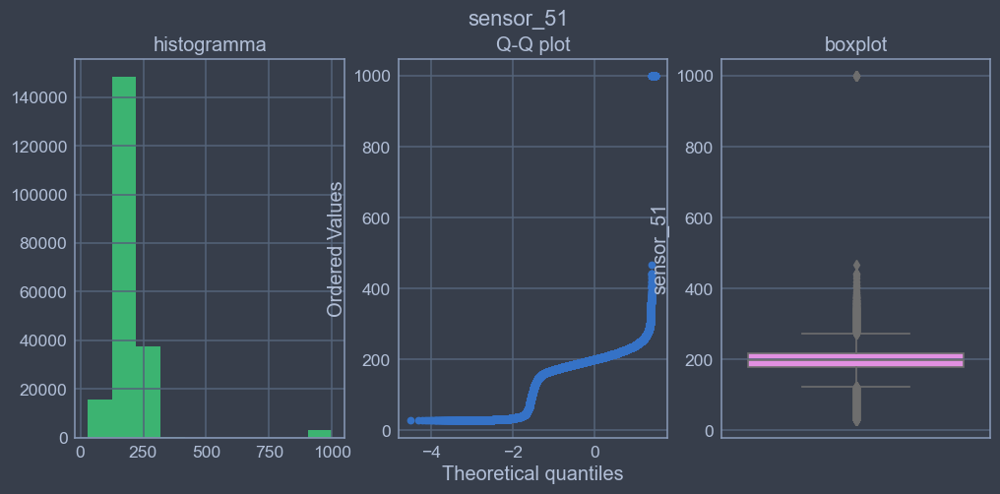

In [29]:
for i in [var for var in data_sensor if data_sensor[var].dtype == 'float64']:
    diagnostic_plots(data_sensor, i)

    We can see that there are plenty of outliers in almost all variables and it might bee seen that some variables like "sensor_44" and "sensor_42" are constant, but acutally they are not.'

## Spliting dataset into smaller parts
    The amount of sensors is big and it will be easier to perform data analysis with smaller portions of data 

In [30]:
data_sensor_1 = data_sensor.iloc[:, 1: 11]
data_sensor_2 = data_sensor.iloc[:, 11: 21]
data_sensor_3 = data_sensor.iloc[:, 21: 31]
data_sensor_4 = data_sensor.iloc[:, 31: 41]
data_sensor_5 = data_sensor.iloc[:, 41: 52]

In [31]:
data_sensor_1

,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,sensor_09
timestamp,,,,,,,,,,
2018-04-01 00:00:00,2.465394,47.09201,53.211800,46.310760,634.375000,76.45975,13.41146,16.13136,15.56713,15.05353
2018-04-01 00:01:00,2.465394,47.09201,53.211800,46.310760,634.375000,76.45975,13.41146,16.13136,15.56713,15.05353
2018-04-01 00:02:00,2.444734,47.35243,53.211800,46.397570,638.888900,73.54598,13.32465,16.03733,15.61777,15.01013
2018-04-01 00:03:00,2.460474,47.09201,53.168400,46.397568,628.125000,76.98898,13.31742,16.24711,15.69734,15.08247
2018-04-01 00:04:00,2.445718,47.13541,53.211800,46.397568,636.458300,76.58897,13.35359,16.21094,15.69734,15.08247
...,...,...,...,...,...,...,...,...,...,...
2018-08-31 23:55:00,2.407350,47.69965,50.520830,43.142361,634.722229,64.59095,15.11863,16.65220,15.65393,15.16204
2018-08-31 23:56:00,2.400463,47.69965,50.564240,43.142361,630.902771,65.83363,15.15480,16.70284,15.65393,15.11863
2018-08-31 23:57:00,2.396528,47.69965,50.520830,43.142361,625.925903,67.29445,15.08970,16.70284,15.69734,15.11863


In [32]:
data_sensor_2

,sensor_10,sensor_11,sensor_12,sensor_13,sensor_14,sensor_16,sensor_17,sensor_18,sensor_19,sensor_20
timestamp,,,,,,,,,,
2018-04-01 00:00:00,37.22740,47.52422,31.11716,1.681353,419.5747,461.8781,466.3284,2.565284,665.3993,398.9862
2018-04-01 00:01:00,37.22740,47.52422,31.11716,1.681353,419.5747,461.8781,466.3284,2.565284,665.3993,398.9862
2018-04-01 00:02:00,37.86777,48.17723,32.08894,1.708474,420.8480,462.7798,459.6364,2.500062,666.2234,399.9418
2018-04-01 00:03:00,38.57977,48.65607,31.67221,1.579427,420.7494,462.8980,460.8858,2.509521,666.0114,399.1046
2018-04-01 00:04:00,39.48939,49.06298,31.95202,1.683831,419.8926,461.4906,468.2206,2.604785,663.2111,400.5426
...,...,...,...,...,...,...,...,...,...,...
2018-08-31 23:55:00,43.17085,54.16052,38.05424,13.265320,420.7993,463.2318,458.3615,2.499117,676.6655,405.7680
2018-08-31 23:56:00,43.21038,54.52602,38.53485,13.242270,422.1567,463.1928,468.4388,2.618476,676.6547,406.2575
2018-08-31 23:57:00,43.12836,55.11779,38.52678,13.188660,420.2166,462.4065,468.6293,2.620500,677.3162,407.1144


In [33]:
data_sensor_3

,sensor_21,sensor_22,sensor_23,sensor_24,sensor_25,sensor_26,sensor_27,sensor_28,sensor_29,sensor_30
timestamp,,,,,,,,,,
2018-04-01 00:00:00,880.0001,498.8926,975.9409,627.6740,741.7151,848.0708,429.0377,785.1935,684.9443,594.4445
2018-04-01 00:01:00,880.0001,498.8926,975.9409,627.6740,741.7151,848.0708,429.0377,785.1935,684.9443,594.4445
2018-04-01 00:02:00,880.4237,501.3617,982.7342,631.1326,740.8031,849.8997,454.2390,778.5734,715.6266,661.5740
2018-04-01 00:03:00,878.8917,499.0430,977.7520,625.4076,739.2722,847.7579,474.8731,779.5091,690.4011,686.1111
2018-04-01 00:04:00,882.5874,498.5383,979.5755,627.1830,737.6033,846.9182,408.8159,785.2307,704.6937,631.4814
...,...,...,...,...,...,...,...,...,...,...
2018-08-31 23:55:00,894.5920,543.5801,1109.5010,611.1745,700.5885,796.5964,692.1138,779.2067,485.0358,691.6666
2018-08-31 23:56:00,895.5599,541.7014,1106.3710,609.4917,698.4915,800.1906,697.8002,797.5571,510.9510,672.2222
2018-08-31 23:57:00,892.2204,542.8578,1106.6980,610.9940,703.1645,800.3767,704.6601,799.3120,492.7720,689.3519


In [34]:
data_sensor_4

,sensor_31,sensor_32,sensor_33,sensor_34,sensor_35,sensor_36,sensor_37,sensor_38,sensor_39,sensor_40
timestamp,,,,,,,,,,
2018-04-01 00:00:00,682.8125,680.4416,433.7037,171.9375,341.9039,195.0655,90.32386,40.36458,31.51042,70.57291
2018-04-01 00:01:00,682.8125,680.4416,433.7037,171.9375,341.9039,195.0655,90.32386,40.36458,31.51042,70.57291
2018-04-01 00:02:00,721.8750,694.7721,441.2635,169.9820,343.1955,200.9694,93.90508,41.40625,31.25000,69.53125
2018-04-01 00:03:00,754.6875,683.3831,446.2493,166.4987,343.9586,193.1689,101.04060,41.92708,31.51042,72.13541
2018-04-01 00:04:00,766.1458,702.4431,433.9081,164.7498,339.9630,193.8770,101.70380,42.70833,31.51042,76.82291
...,...,...,...,...,...,...,...,...,...,...
2018-08-31 23:55:00,974.9999,927.6135,477.3156,266.0334,578.5221,817.5707,0.00000,47.13541,29.16667,71.61458
2018-08-31 23:56:00,927.0833,907.9463,487.8679,262.2222,568.1035,807.0151,0.00000,46.87500,28.90625,73.17708
2018-08-31 23:57:00,924.4791,926.8102,494.1249,260.8372,553.8872,805.5605,0.00000,46.09375,28.64583,77.08333


In [35]:
data_sensor_5

,sensor_41,sensor_42,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51
timestamp,,,,,,,,,,,
2018-04-01 00:00:00,30.989580,31.770832,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889
2018-04-01 00:01:00,30.989580,31.770832,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889
2018-04-01 00:02:00,30.468750,31.770830,41.66666,39.351852,65.39352,51.21528,38.194443,155.9606,67.12963,241.3194,203.7037
2018-04-01 00:03:00,30.468750,31.510420,40.88541,39.062500,64.81481,51.21528,38.194440,155.9606,66.84028,240.4514,203.1250
2018-04-01 00:04:00,30.989580,31.510420,41.40625,38.773150,65.10416,51.79398,38.773150,158.2755,66.55093,242.1875,201.3889
...,...,...,...,...,...,...,...,...,...,...,...
2018-08-31 23:55:00,30.468750,30.208330,38.28125,68.287030,52.37268,48.32176,41.087960,212.3843,153.64580,NaN,231.1921
2018-08-31 23:56:00,30.208332,29.947920,38.28125,66.840280,50.63657,48.03241,40.798610,213.8310,156.25000,NaN,231.1921
2018-08-31 23:57:00,29.947920,30.208330,39.06250,65.393520,48.90046,48.03241,40.798610,217.3032,155.38190,NaN,232.0602


## Exploring correlation between variables

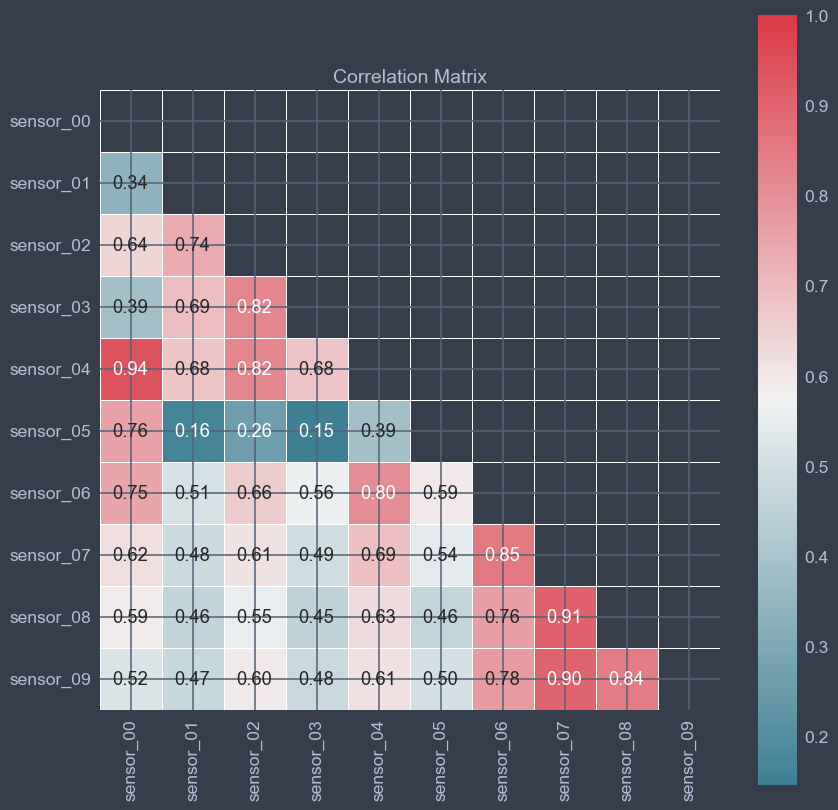

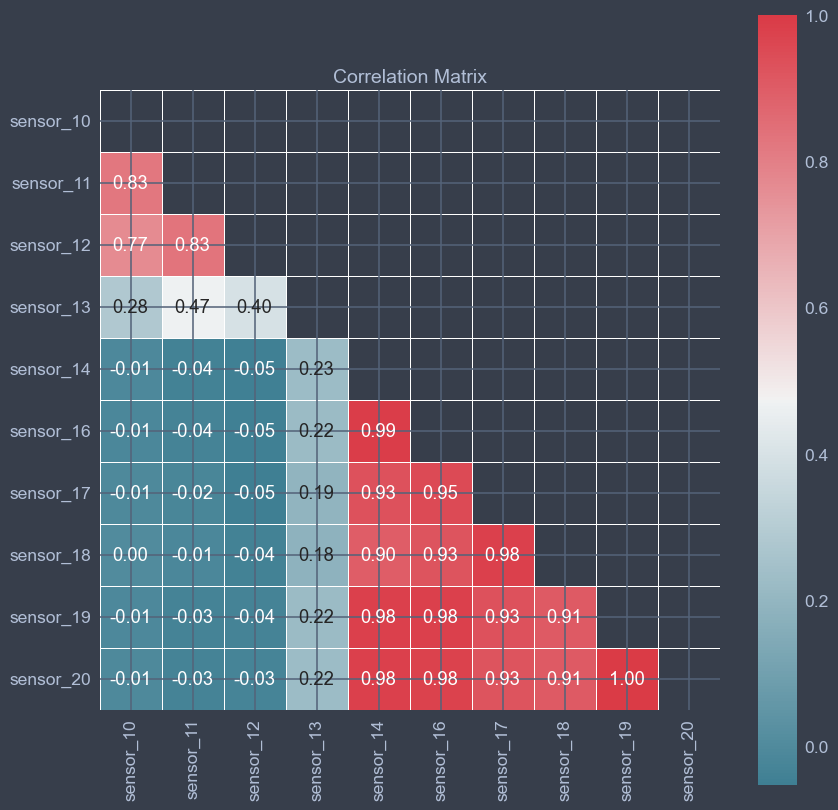

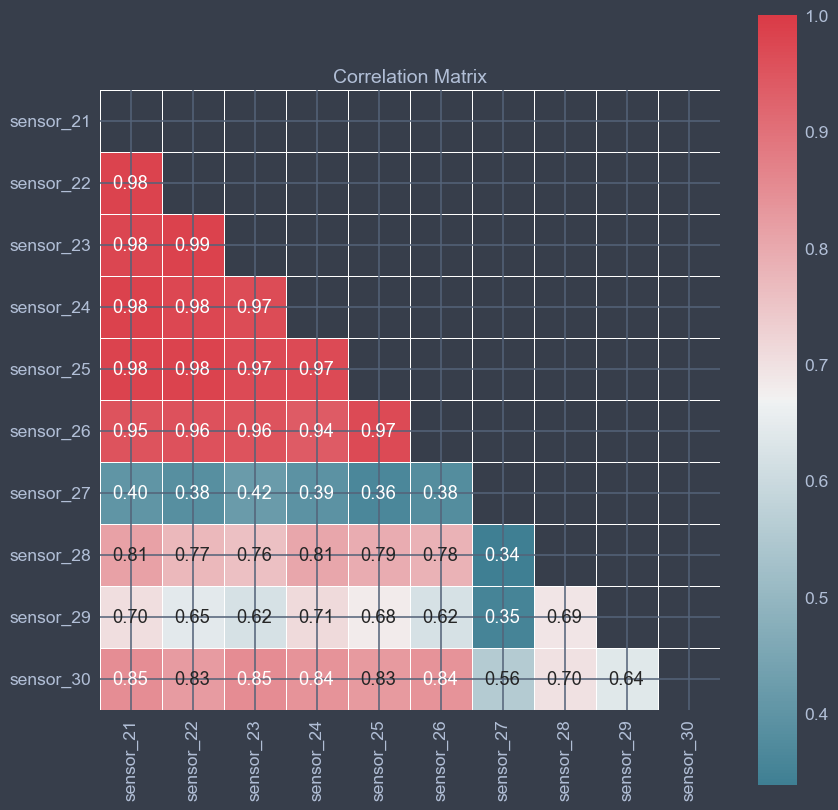

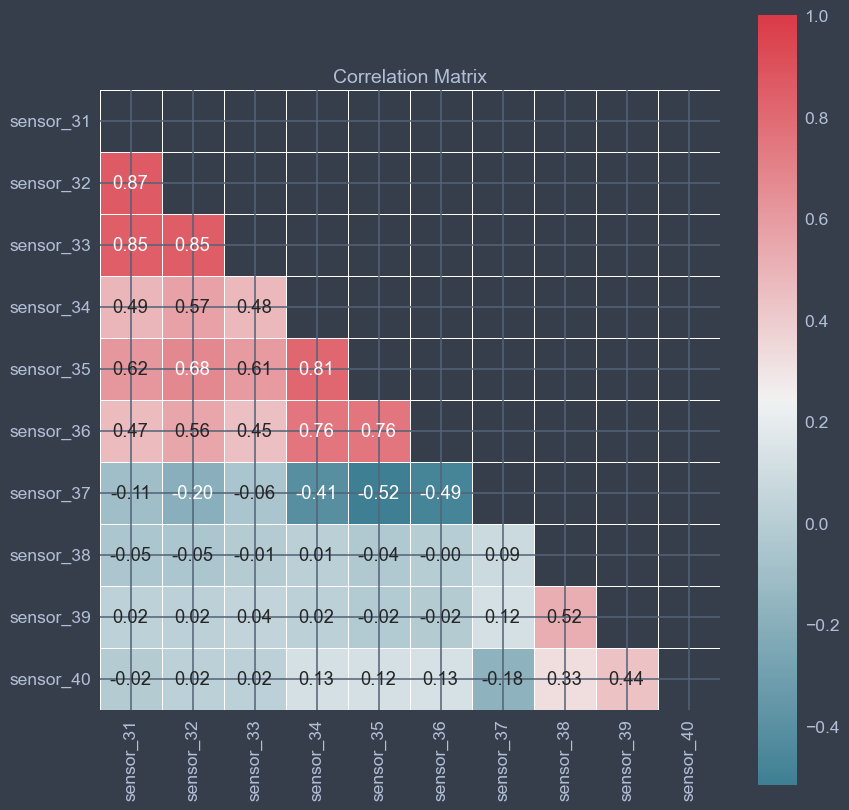

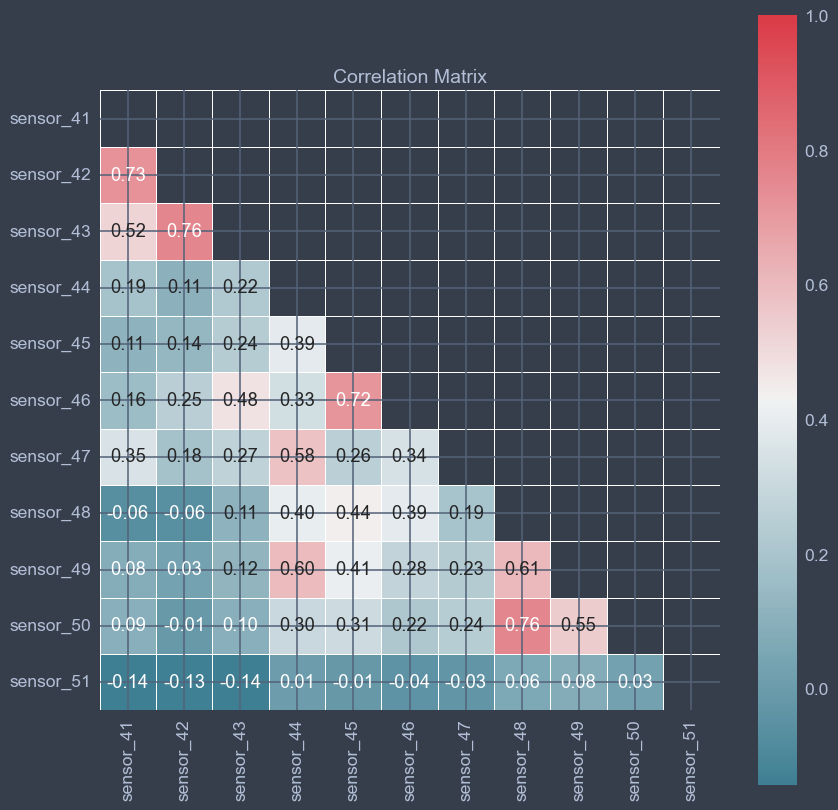

In [36]:
for dataset in [data_sensor_1, data_sensor_2, data_sensor_3, data_sensor_4, data_sensor_5]:
    corr_table = dataset.corr()
    corrmat(corr_table, figsize = (10, 10), inflate = False)
    plt.show()

    We can notice that some of the independet variable has high correlation, causing so-called multicollinearity while others are not correleated at all.

## Exploring sensors by timestamp

## data_sensor_1

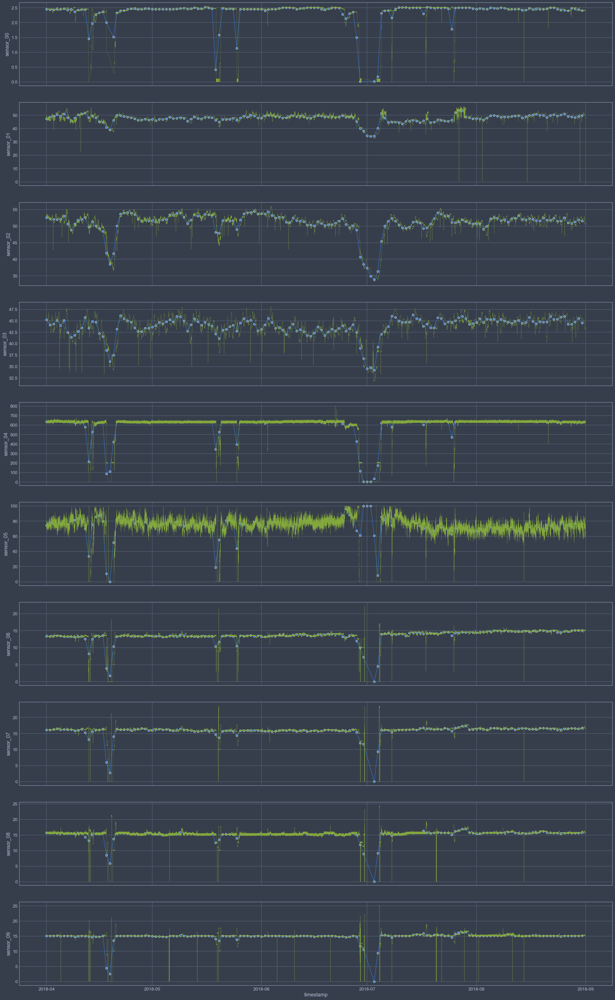

In [37]:
fig,ax = plt.subplots(ncols = 1 , nrows = data_sensor_1.shape[1], sharex = True, figsize = (30,50))
j = 0
for i in data_sensor_1.columns:
    sns.lineplot(data = data_sensor_1[i].resample('D').mean(), marker = 'o', ax = ax[j])
    sns.lineplot(x = data_sensor_1.index, y = i, data = data_sensor_1, linewidth = 0.3, ax=  ax[j])
    j += 1

    We can see that all sensors record critically low values during July and the majority of sensors has lower values between April and May. T
    he periods are the same with the second and fifth breakouts which took the longest time to fix. It seems that those breakouts were because of some emergancy because a lot of sensors has dropouts during these periods. while the values from sensords during other breakouts seems to be stable and calm.

## data_sensor_2

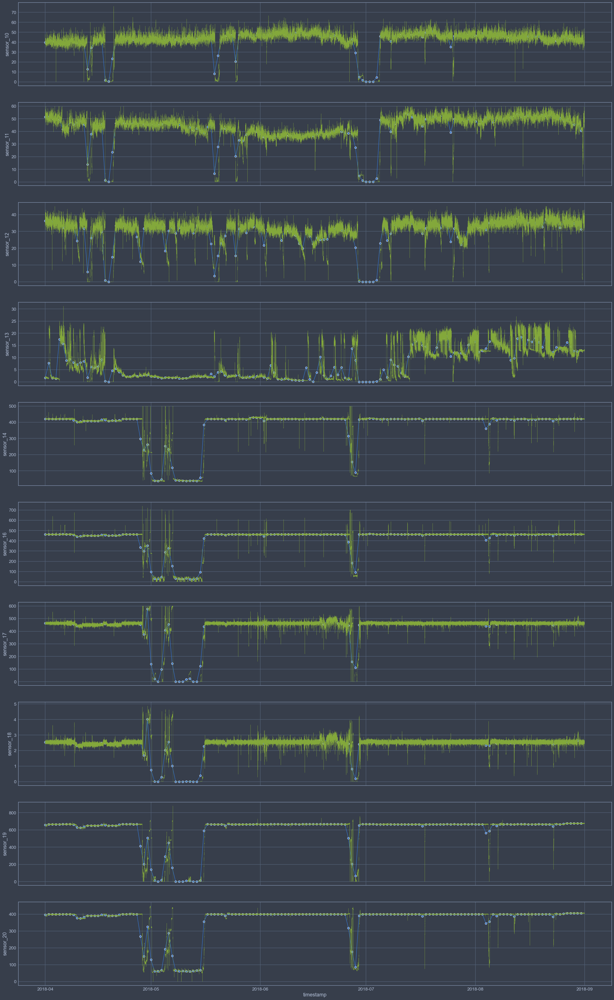

In [38]:
fig,ax = plt.subplots(ncols = 1 , nrows = data_sensor_2.shape[1], sharex = True, figsize = (30,50))
j = 0
for i in data_sensor_2.columns:
    sns.lineplot(data = data_sensor_2[i].resample('D').mean(), marker = 'o', ax = ax[j])
    sns.lineplot(x = data_sensor_2.index, y = i, data = data_sensor_2, linewidth = 0.3, ax=  ax[j])
    j += 1

    We can see that all sensors record critically low values during July and the majority of sensors also has lower values in the first half of the May. sensors 10, 11 and 12 also has dropdown in second half of April. 
    The majority of dropouts seems to happen during the third breakout which took almost 1 day to fix and during the fifth which took 5 days.

## data_sensor_3

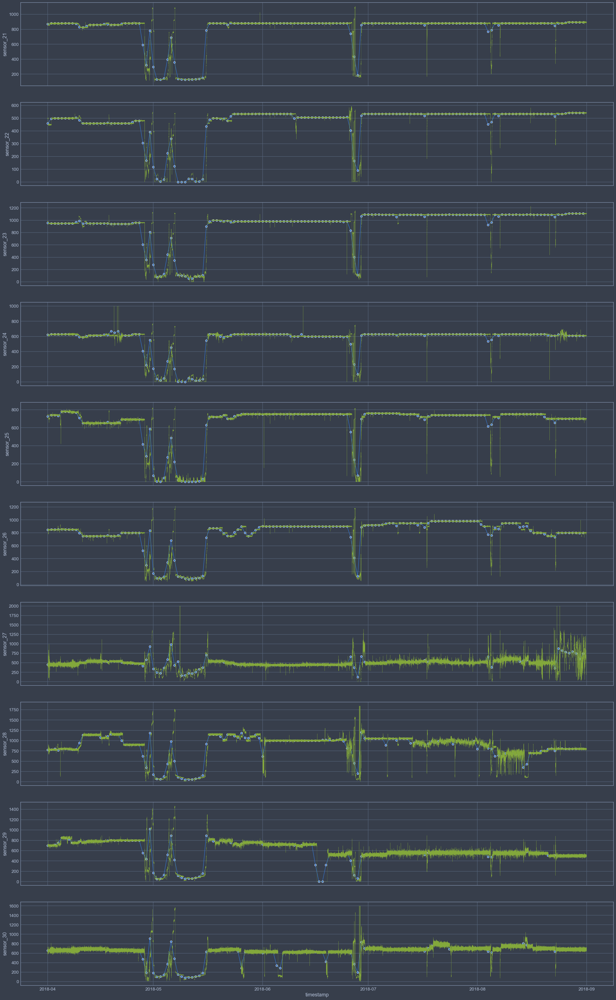

In [39]:
fig,ax = plt.subplots(ncols = 1 , nrows = data_sensor_3.shape[1], sharex = True, figsize = (30,50))
j = 0
for i in data_sensor_3.columns:
    sns.lineplot(data = data_sensor_3[i].resample('D').mean(), marker = 'o', ax = ax[j])
    sns.lineplot(x = data_sensor_3.index, y = i, data = data_sensor_3, linewidth = 0.3, ax=  ax[j])
    j += 1

    We can see that all sensors record critically low values in the first half of May. Also there are dropdowns just before the July
    The majority of dropouts seems to happen during the third breakout which took almost 1 day to fix and during the fifth which took 5 days.

## data_sensor_4

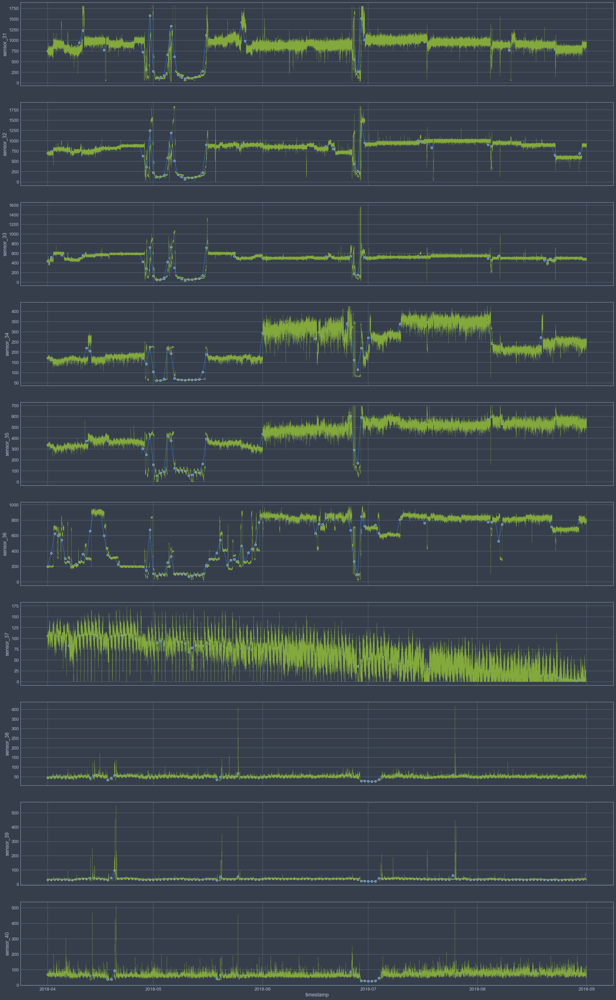

In [40]:
fig,ax = plt.subplots(ncols = 1 , nrows = data_sensor_4.shape[1], sharex = True, figsize = (30,50))
j = 0
for i in data_sensor_4.columns:
    sns.lineplot(data = data_sensor_4[i].resample('D').mean(), marker = 'o', ax = ax[j])
    sns.lineplot(x = data_sensor_4.index, y = i, data = data_sensor_4, linewidth = 0.3, ax=  ax[j])
    j += 1

    We can see that sensors 31, 32, 33, 34, 35 and record critically low values in the first half of May.
     some of dropouts seems to happen during the third breakout which took almost 1 day to fix and during the fifth which took 5 days.

## data_sensor_5

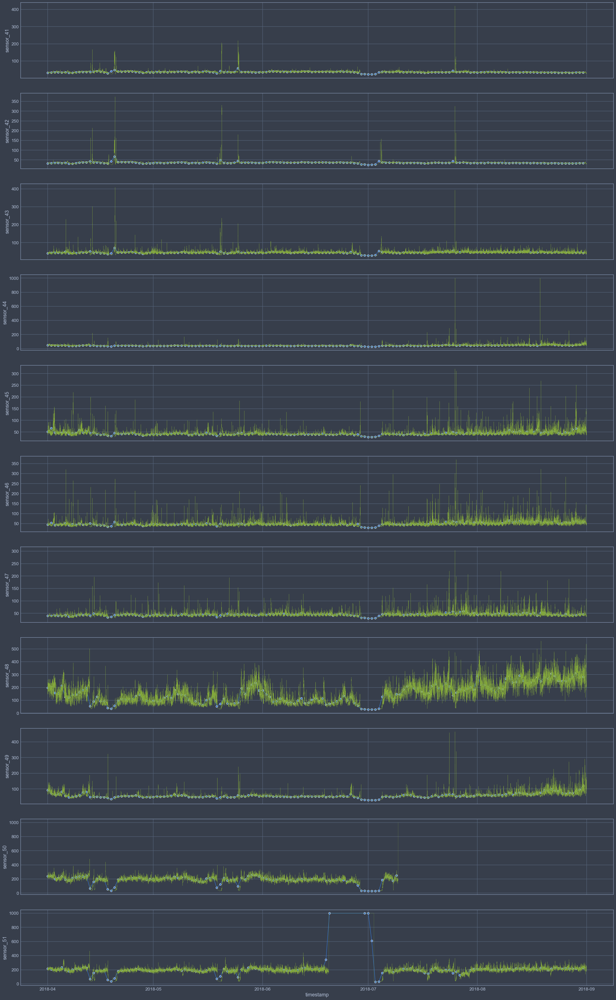

In [41]:
fig,ax = plt.subplots(ncols = 1 , nrows = data_sensor_5.shape[1], sharex = True, figsize = (30,50))
j = 0
for i in data_sensor_5.columns:
    sns.lineplot(data = data_sensor_5[i].resample('D').mean(), marker = 'o', ax = ax[j])
    sns.lineplot(x = data_sensor_5.index, y = i, data = data_sensor_5, linewidth = 0.3, ax=  ax[j])
    j += 1

    WE can notice that sensor 50 has no records after the July. and sensor 51 has critically high values in the second half of June.

# Step 3: Feature engineering

# Scaling

##  Assigning the dataset only with sensors

In [42]:
only_sensors = data_sensor.iloc[:, 1:52]

In [43]:
only_sensors

,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,sensor_09,...,sensor_42,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51
timestamp,,,,,,,,,,,,,,,,,,,,,
2018-04-01 00:00:00,2.465394,47.09201,53.211800,46.310760,634.375000,76.45975,13.41146,16.13136,15.56713,15.05353,...,31.770832,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889
2018-04-01 00:01:00,2.465394,47.09201,53.211800,46.310760,634.375000,76.45975,13.41146,16.13136,15.56713,15.05353,...,31.770832,41.92708,39.641200,65.68287,50.92593,38.194440,157.9861,67.70834,243.0556,201.3889
2018-04-01 00:02:00,2.444734,47.35243,53.211800,46.397570,638.888900,73.54598,13.32465,16.03733,15.61777,15.01013,...,31.770830,41.66666,39.351852,65.39352,51.21528,38.194443,155.9606,67.12963,241.3194,203.7037
2018-04-01 00:03:00,2.460474,47.09201,53.168400,46.397568,628.125000,76.98898,13.31742,16.24711,15.69734,15.08247,...,31.510420,40.88541,39.062500,64.81481,51.21528,38.194440,155.9606,66.84028,240.4514,203.1250
2018-04-01 00:04:00,2.445718,47.13541,53.211800,46.397568,636.458300,76.58897,13.35359,16.21094,15.69734,15.08247,...,31.510420,41.40625,38.773150,65.10416,51.79398,38.773150,158.2755,66.55093,242.1875,201.3889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-31 23:55:00,2.407350,47.69965,50.520830,43.142361,634.722229,64.59095,15.11863,16.65220,15.65393,15.16204,...,30.208330,38.28125,68.287030,52.37268,48.32176,41.087960,212.3843,153.64580,NaN,231.1921
2018-08-31 23:56:00,2.400463,47.69965,50.564240,43.142361,630.902771,65.83363,15.15480,16.70284,15.65393,15.11863,...,29.947920,38.28125,66.840280,50.63657,48.03241,40.798610,213.8310,156.25000,NaN,231.1921
2018-08-31 23:57:00,2.396528,47.69965,50.520830,43.142361,625.925903,67.29445,15.08970,16.70284,15.69734,15.11863,...,30.208330,39.06250,65.393520,48.90046,48.03241,40.798610,217.3032,155.38190,NaN,232.0602


## Standard scaler

In [44]:
standard = StandardScaler()
sensor_standard = standard.fit_transform(only_sensors)

In [45]:
sensor_standard = pd.DataFrame(sensor_standard, columns = only_sensors.columns)

In [46]:
sensor_standard

,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,sensor_09,...,sensor_42,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51
timestamp,,,,,,,,,,,,,,,,,,,,,
2018-04-01 00:00:00,0.226024,-0.151548,0.639359,1.057629,0.303430,0.177090,-0.041631,0.130935,0.179843,0.121570,...,-0.358948,-0.176788,-0.260504,1.759525,0.185877,-0.588606,0.086292,0.553104,0.919519,-0.011961
2018-04-01 00:01:00,0.226024,-0.151548,0.639359,1.057629,0.303430,0.177090,-0.041631,0.130935,0.179843,0.121570,...,-0.358948,-0.176788,-0.260504,1.759525,0.185877,-0.588606,0.086292,0.553104,0.919519,-0.011961
2018-04-01 00:02:00,0.175906,-0.072552,0.639359,1.093518,0.334771,0.008646,-0.081751,0.088217,0.204698,0.100824,...,-0.358948,-0.200367,-0.285498,1.736986,0.204376,-0.588605,0.061664,0.522874,0.892914,0.009162
2018-04-01 00:03:00,0.214089,-0.151548,0.627523,1.093517,0.260034,0.207684,-0.085093,0.183521,0.243753,0.135404,...,-0.384330,-0.271105,-0.310494,1.691906,0.204376,-0.588606,0.061664,0.507759,0.879613,0.003881
2018-04-01 00:04:00,0.178293,-0.138383,0.639359,1.093517,0.317895,0.184560,-0.068376,0.167089,0.243753,0.135404,...,-0.384330,-0.223946,-0.335489,1.714445,0.241374,-0.533186,0.089811,0.492644,0.906216,-0.011961
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-31 23:55:00,0.085218,0.032772,-0.094513,-0.252232,0.305841,-0.509039,0.747363,0.367557,0.222446,0.173441,...,-0.511246,-0.506895,2.214014,0.722703,0.019383,-0.311513,0.747710,5.042211,NaN,0.259995
2018-08-31 23:56:00,0.068511,0.032772,-0.082675,-0.252232,0.279321,-0.437200,0.764079,0.390563,0.222446,0.152690,...,-0.536628,-0.506895,2.089039,0.587466,0.000884,-0.339222,0.765300,5.178246,NaN,0.259995
2018-08-31 23:57:00,0.058966,0.032772,-0.094513,-0.252232,0.244765,-0.352751,0.733993,0.390563,0.243753,0.152690,...,-0.511246,-0.436158,1.964063,0.452228,0.000884,-0.339222,0.807518,5.132899,NaN,0.267917


## Before scaling

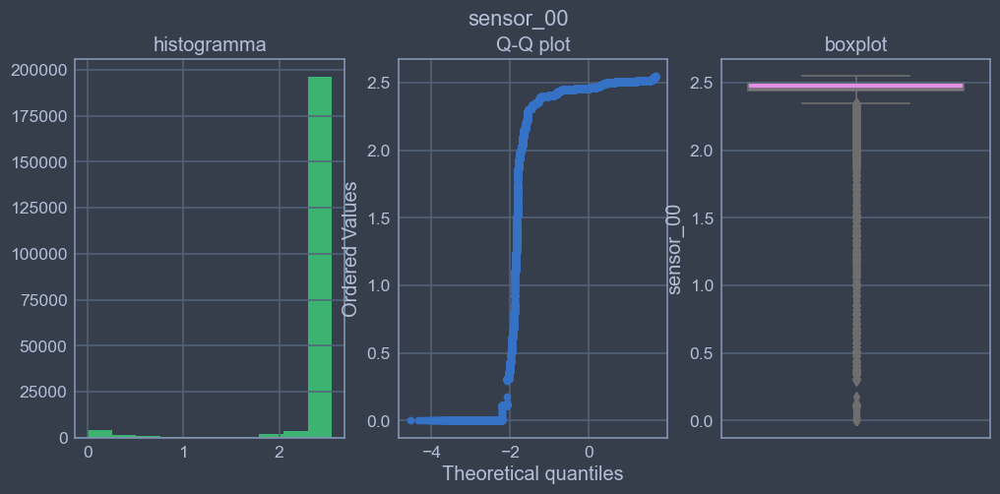

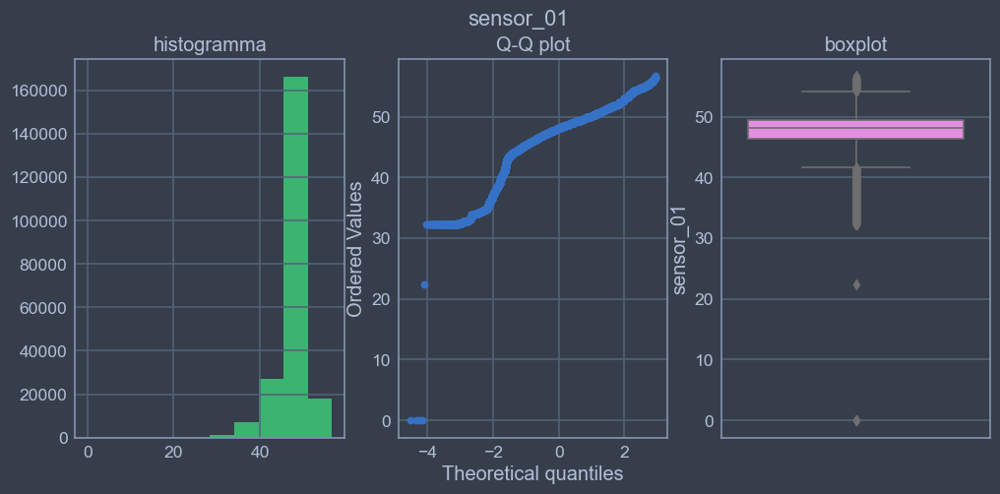

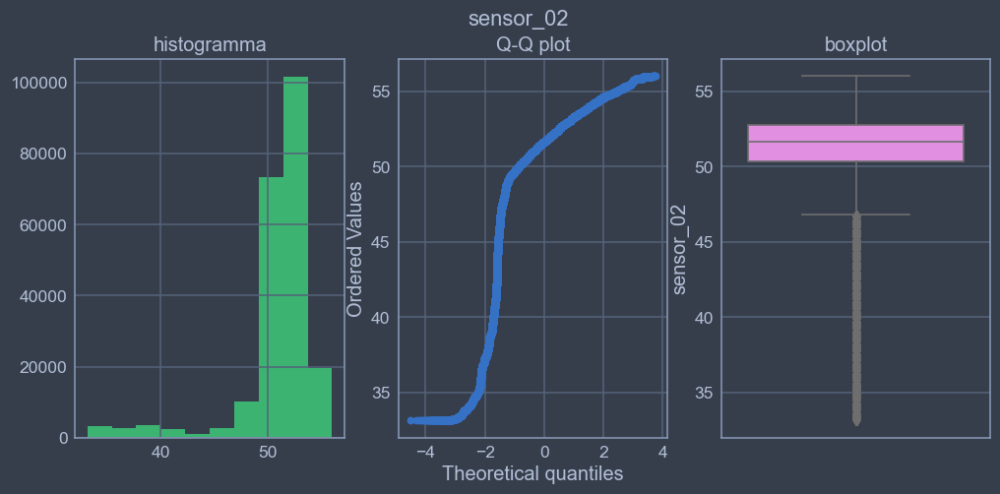

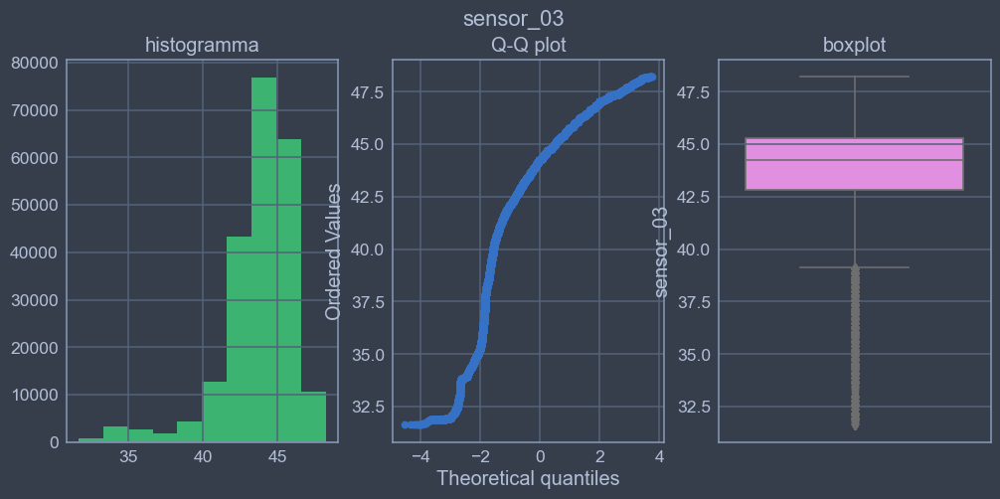

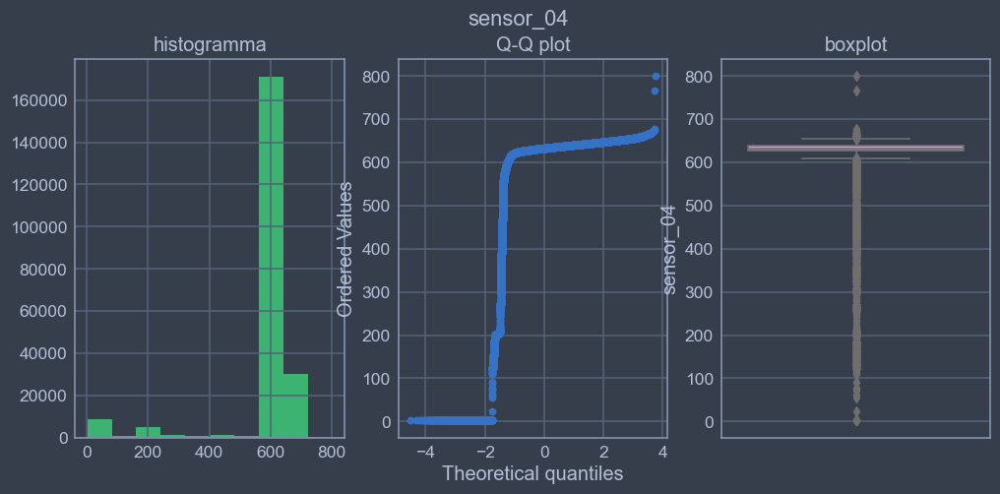

...

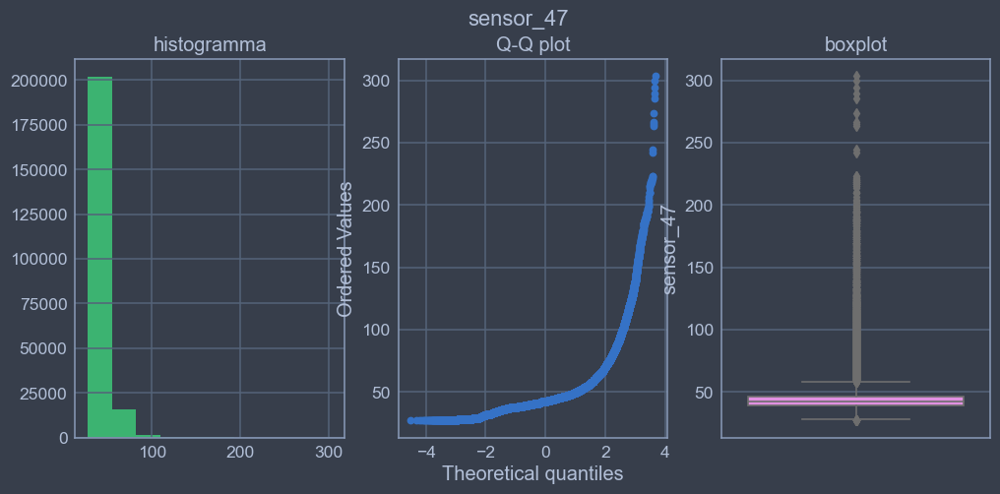

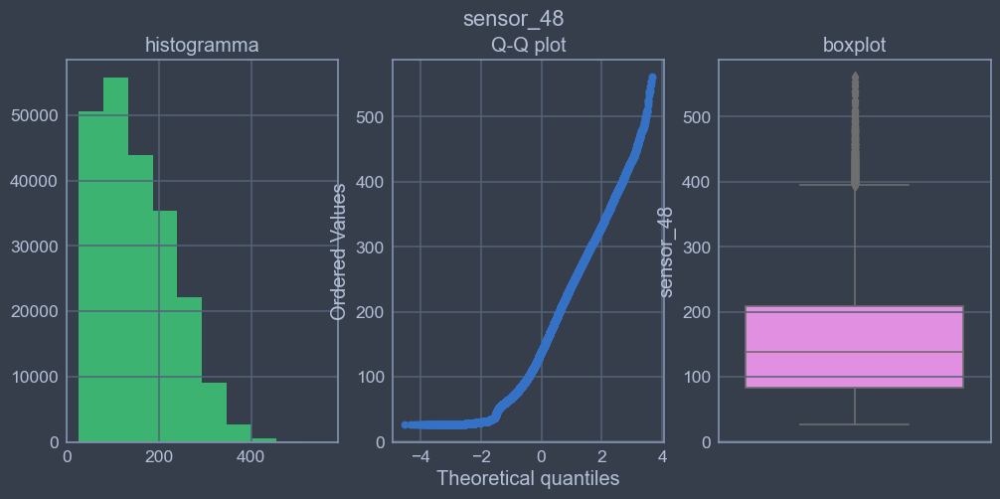

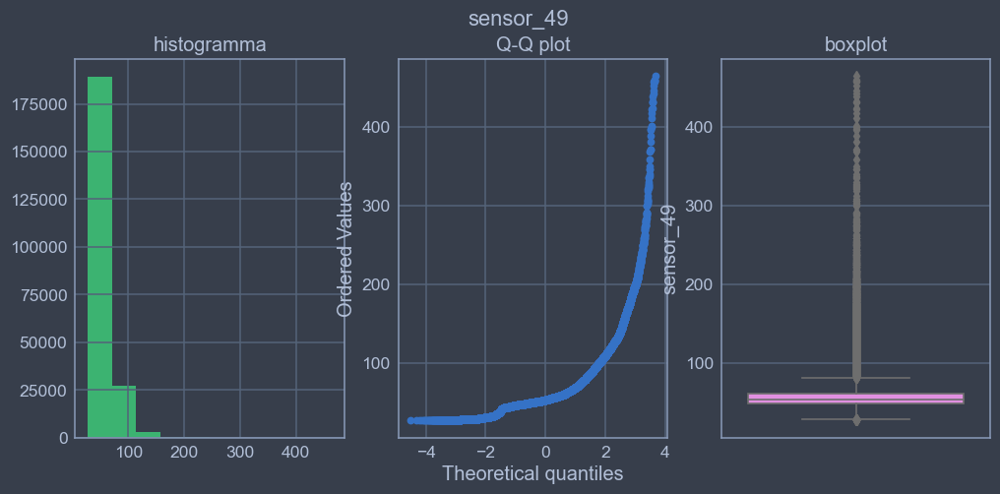

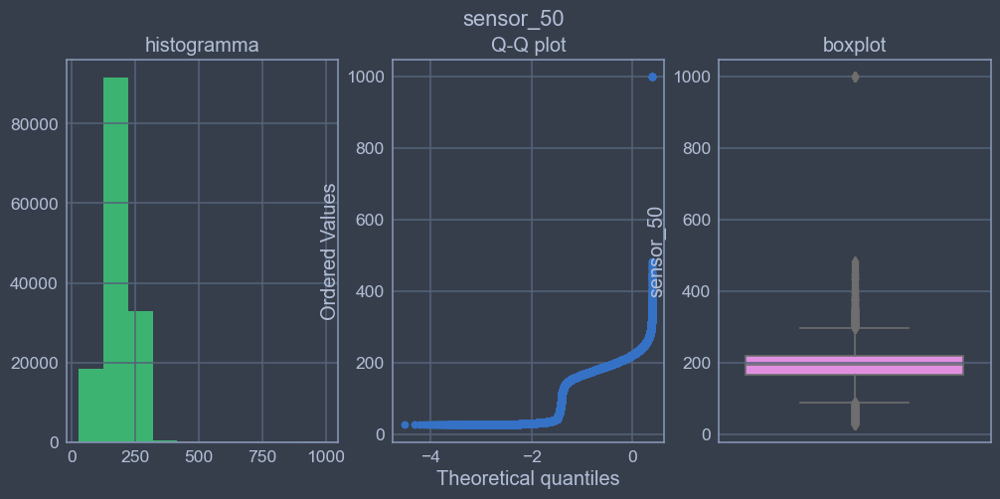

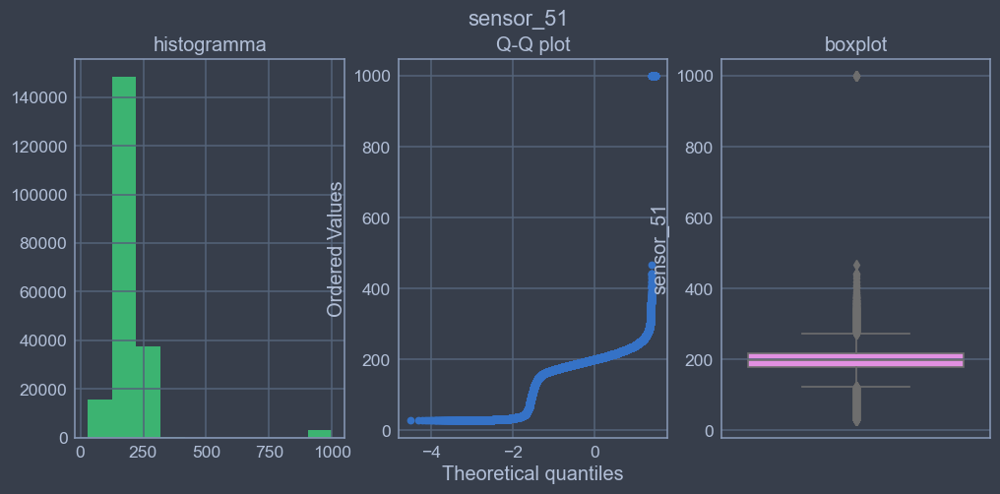

In [47]:
for i in [var for var in data_sensor if data_sensor[var].dtype == 'float64']:
    diagnostic_plots(only_sensors, i)

## After scaling

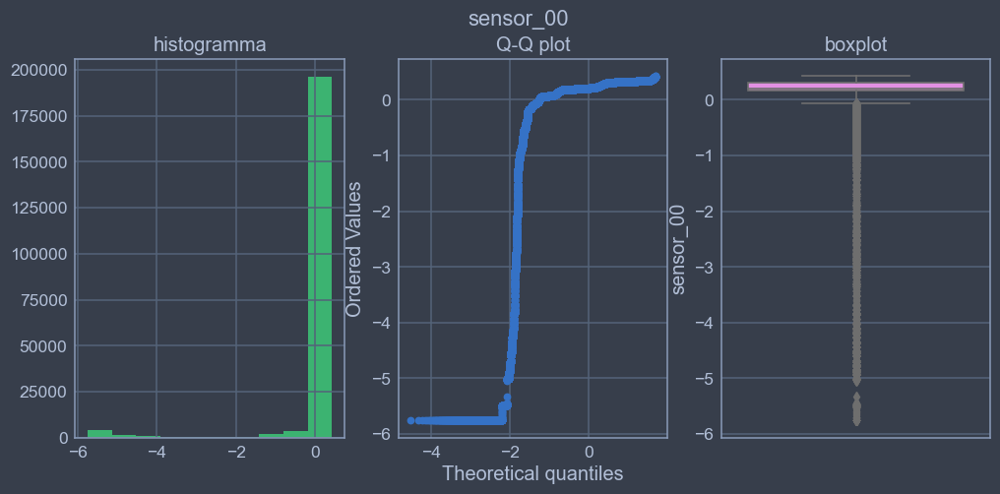

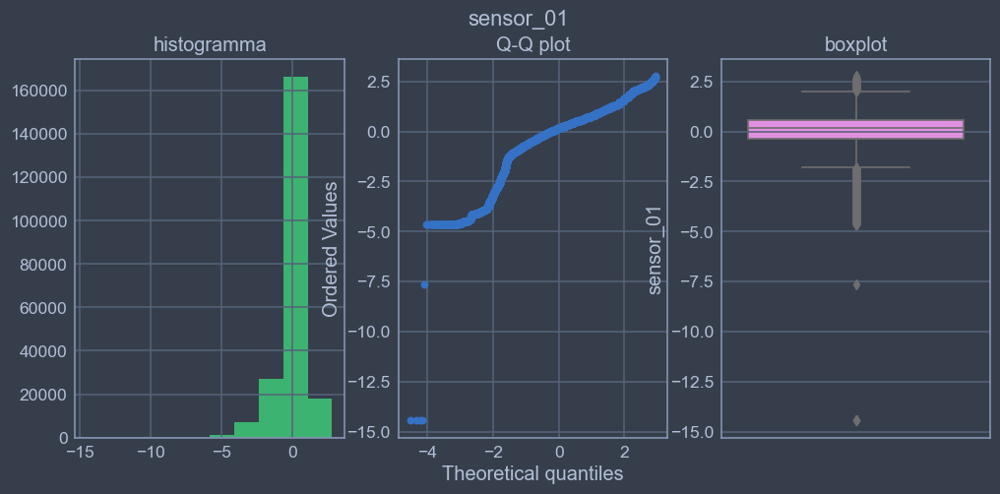

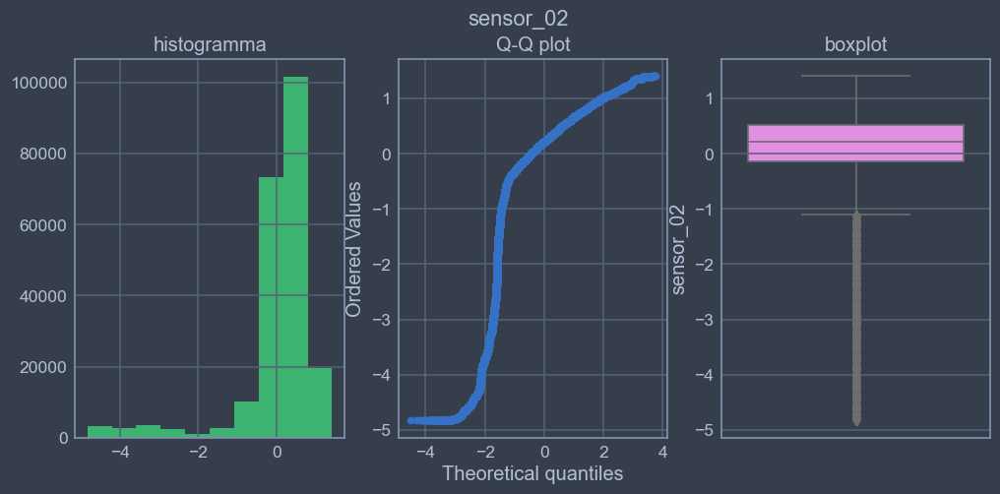

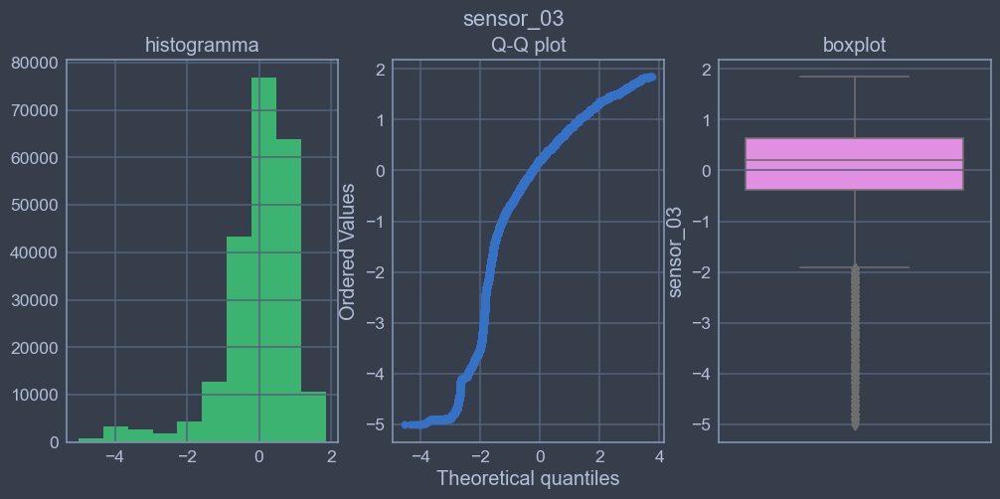

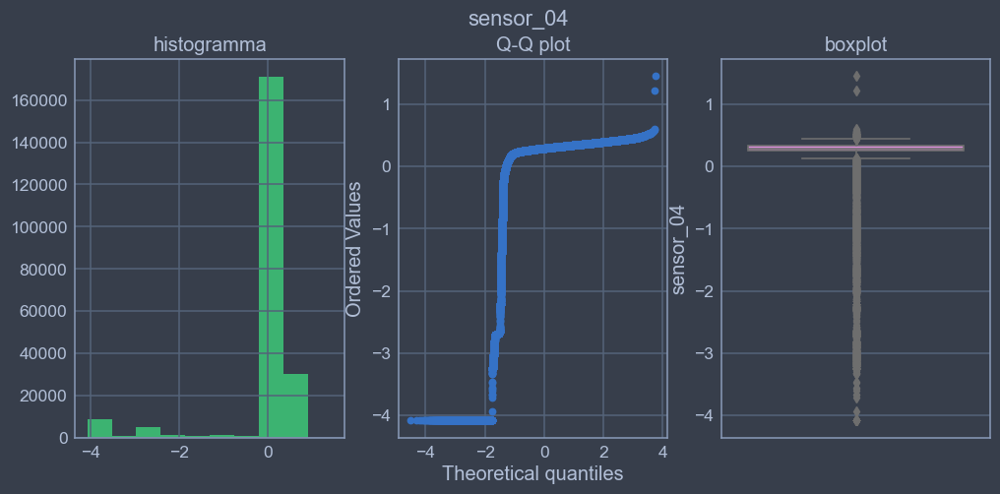

...

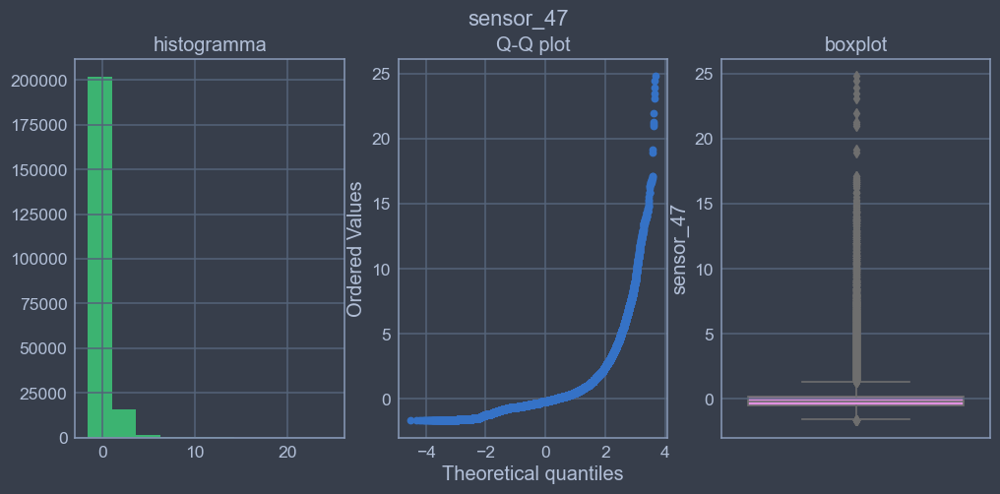

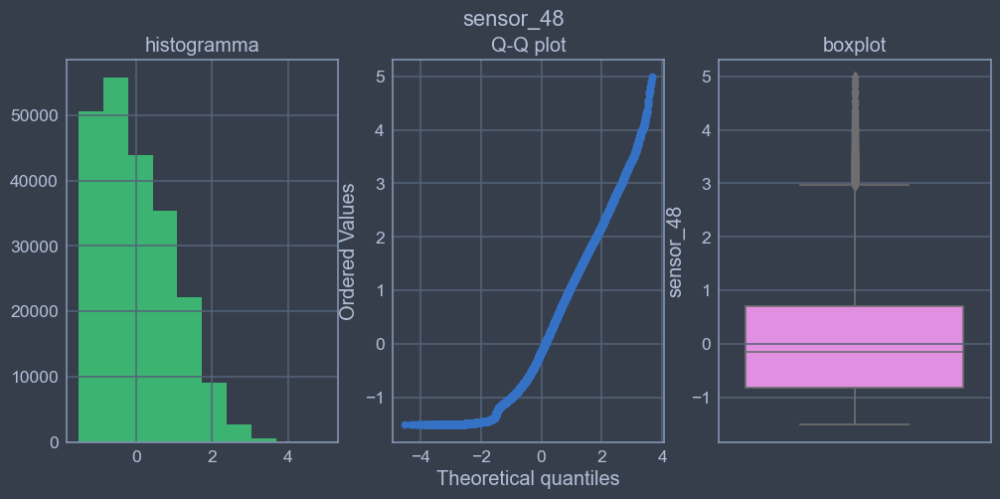

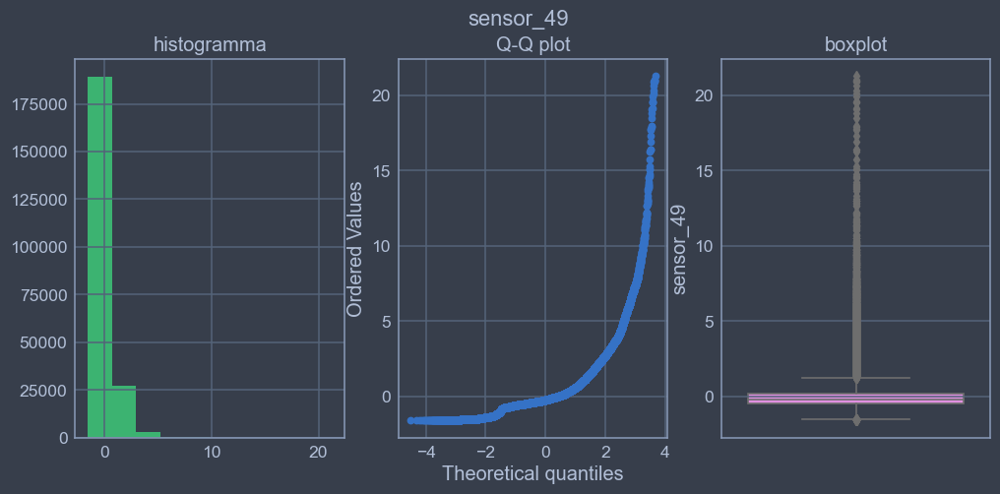

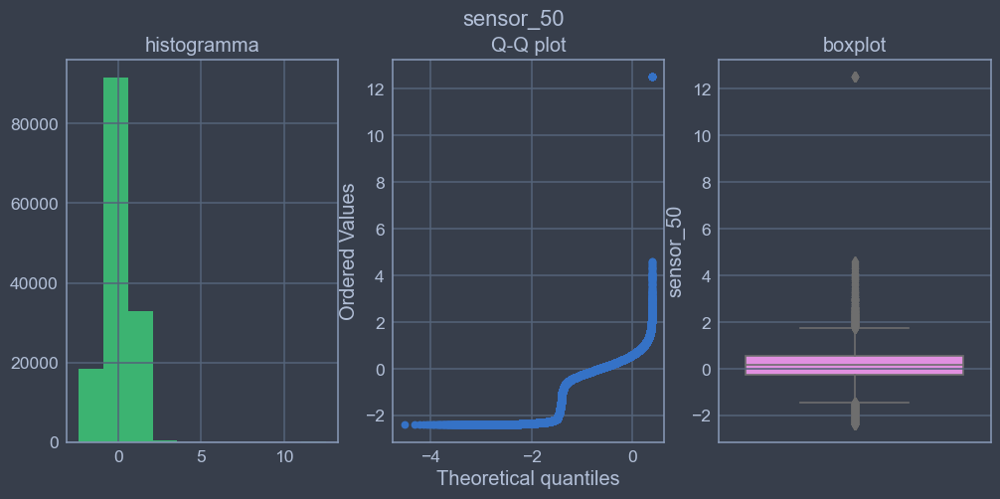

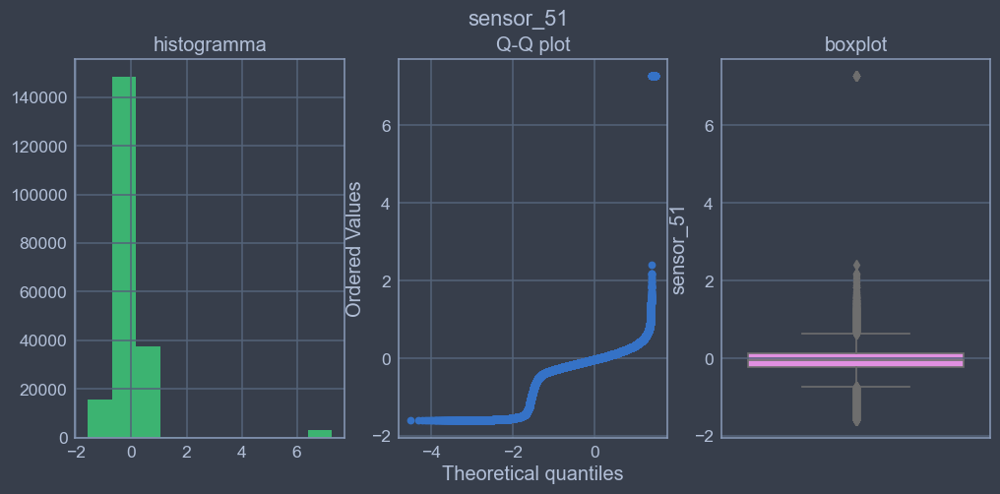

In [48]:
for i in [var for var in data_sensor if data_sensor[var].dtype == 'float64']:
    diagnostic_plots(sensor_standard, i)

## Robustscaler

In [49]:
robust = RobustScaler()
sensor_robust = robust.fit_transform(only_sensors)

In [50]:
sensor_robust = pd.DataFrame(sensor_robust, columns = only_sensors.columns)

In [51]:
sensor_robust

,sensor_00,sensor_01,sensor_02,sensor_03,sensor_04,sensor_05,sensor_06,sensor_07,sensor_08,sensor_09,...,sensor_42,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51
timestamp,,,,,,,,,,,,,,,,,,,,,
2018-04-01 00:00:00,0.145176,-0.328768,0.654546,0.842104,0.157893,0.080740,-0.193938,-0.069447,0.140849,-0.444547,...,-0.812501,-0.148149,-0.103449,3.142855,0.567568,-0.576923,0.160465,1.155556,0.939228,0.107692
2018-04-01 00:01:00,0.145176,-0.328768,0.654546,0.842104,0.157893,0.080740,-0.193938,-0.069447,0.140849,-0.444547,...,-0.812501,-0.148149,-0.103449,3.142855,0.567568,-0.576923,0.160465,1.155556,0.939228,0.107692
2018-04-01 00:02:00,-0.193540,-0.246575,0.654546,0.877193,0.568422,-0.185701,-0.266668,-0.249986,0.239447,-1.111214,...,-0.812501,-0.185186,-0.137931,3.107141,0.594594,-0.576923,0.144186,1.111111,0.906077,0.169230
2018-04-01 00:03:00,0.064513,-0.328768,0.636366,0.877192,-0.410531,0.129134,-0.272726,0.152795,0.394373,0.000000,...,-0.875000,-0.296297,-0.172414,3.035712,0.594594,-0.576923,0.144186,1.088889,0.889504,0.153845
2018-04-01 00:04:00,-0.177408,-0.315070,0.654546,0.877192,0.347364,0.092556,-0.242422,0.083348,0.394373,0.000000,...,-0.875000,-0.222222,-0.206896,3.071426,0.648648,-0.499999,0.162791,1.066667,0.922652,0.107692
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-31 23:55:00,-0.806443,-0.136987,-0.472727,-0.438595,0.189473,-1.004568,1.236356,0.930572,0.309852,1.222273,...,-1.187502,-0.666667,3.310343,1.499998,0.324324,-0.192308,0.597675,7.755555,NaN,0.899999
2018-08-31 23:56:00,-0.919354,-0.136987,-0.454542,-0.438595,-0.157899,-0.890934,1.266660,1.027802,0.309852,0.555453,...,-1.250000,-0.666667,3.137931,1.285713,0.297297,-0.230769,0.609303,7.955557,NaN,0.899999
2018-08-31 23:57:00,-0.983868,-0.136987,-0.472727,-0.438595,-0.610533,-0.757354,1.212118,1.027802,0.394373,0.555453,...,-1.187502,-0.555556,2.965517,1.071427,0.297297,-0.230769,0.637209,7.888887,NaN,0.923077


## Before scaling

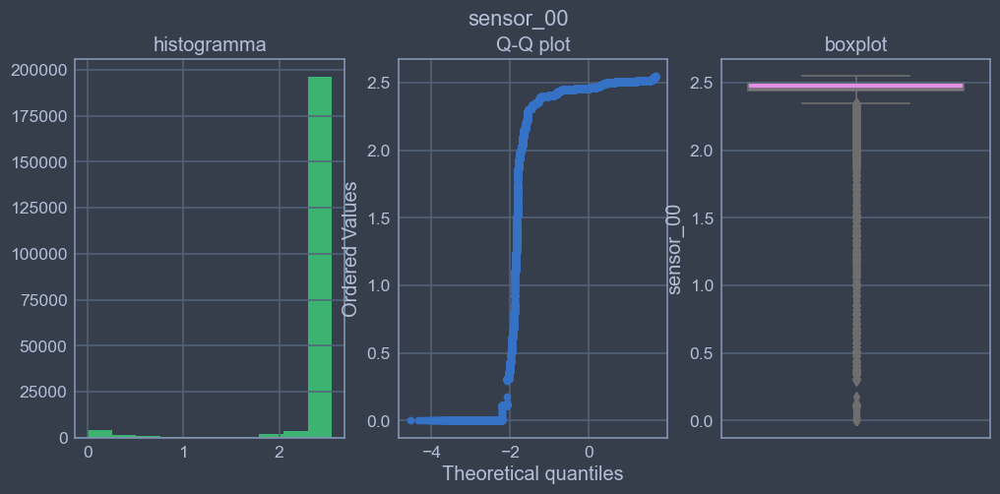

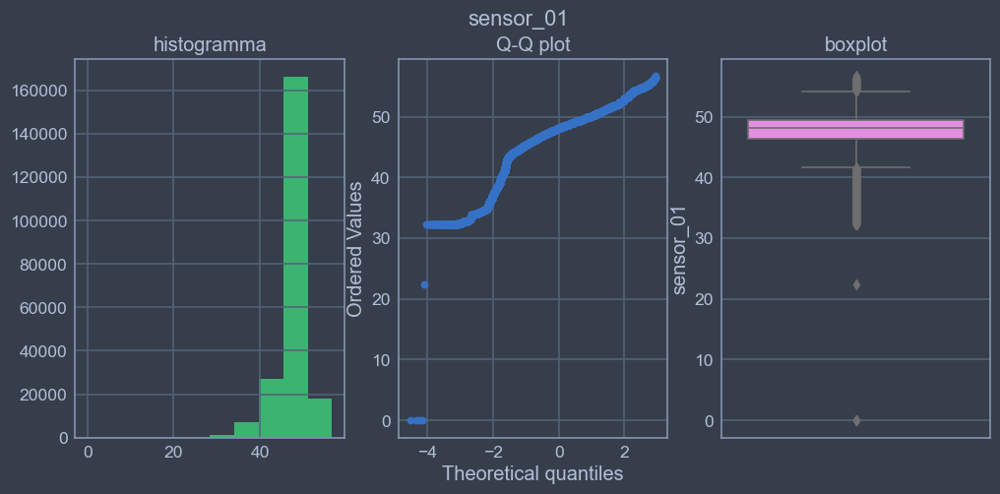

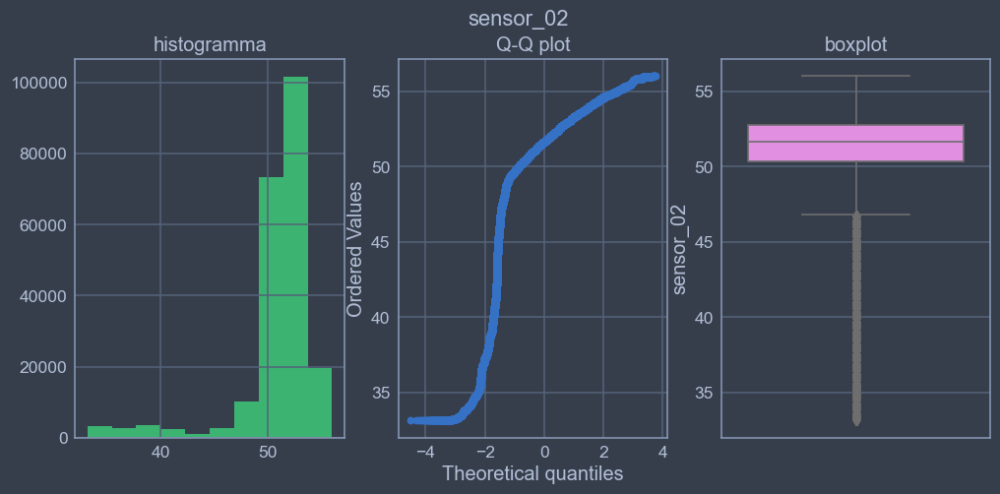

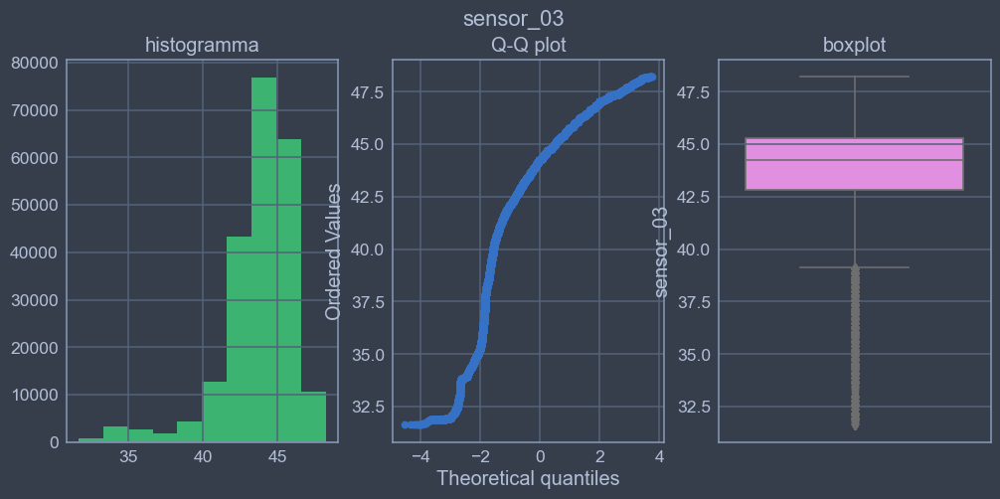

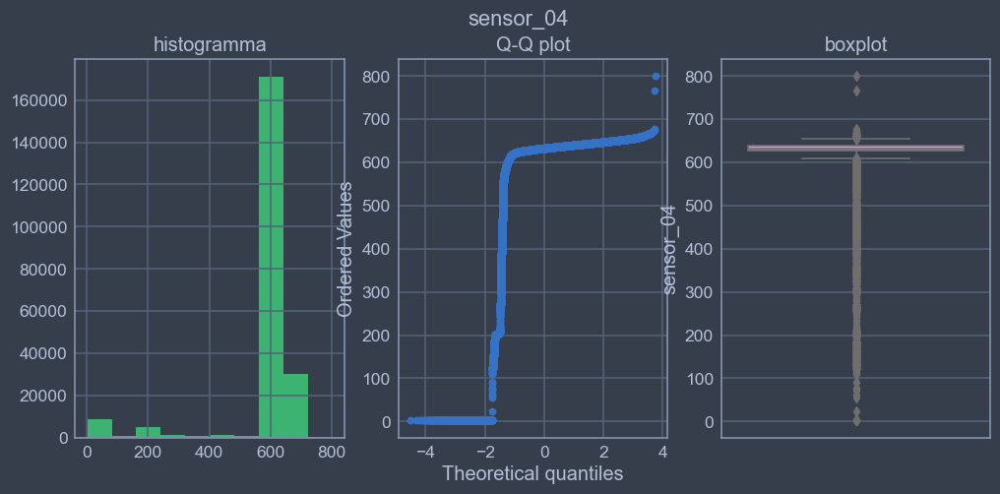

...

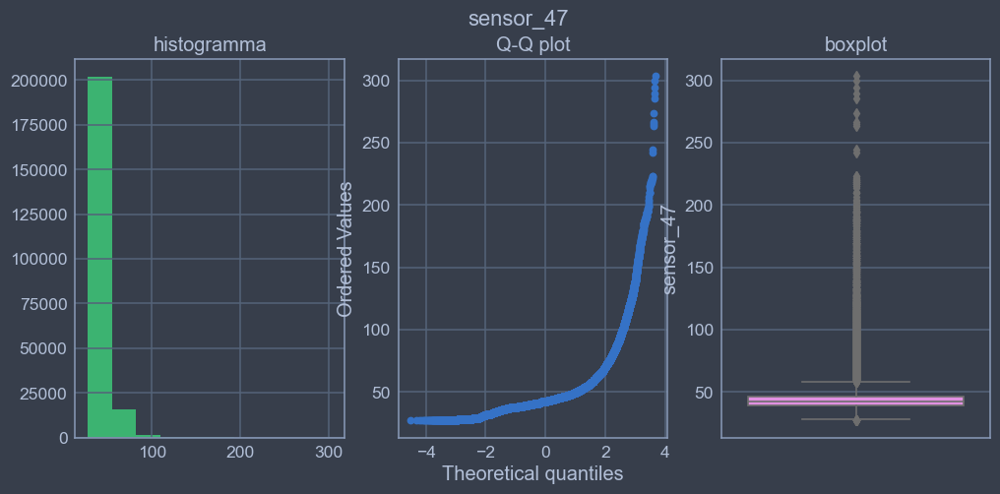

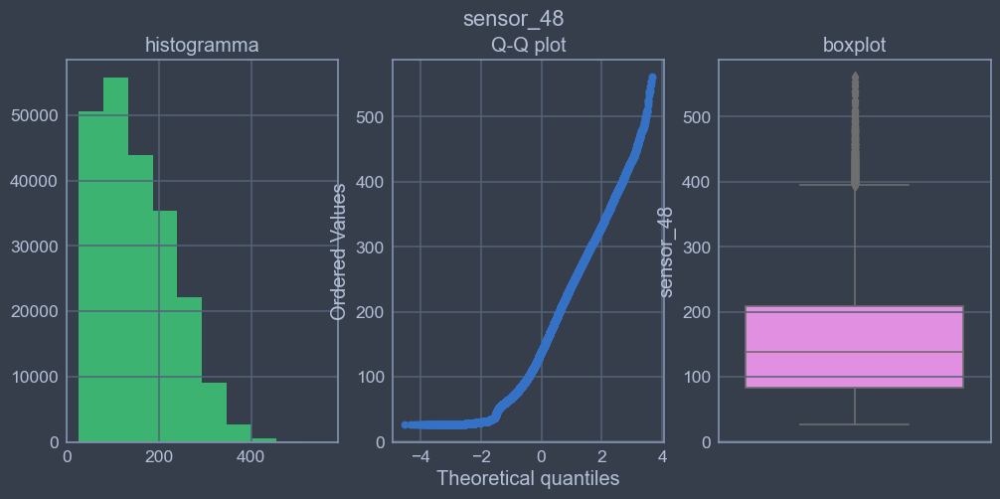

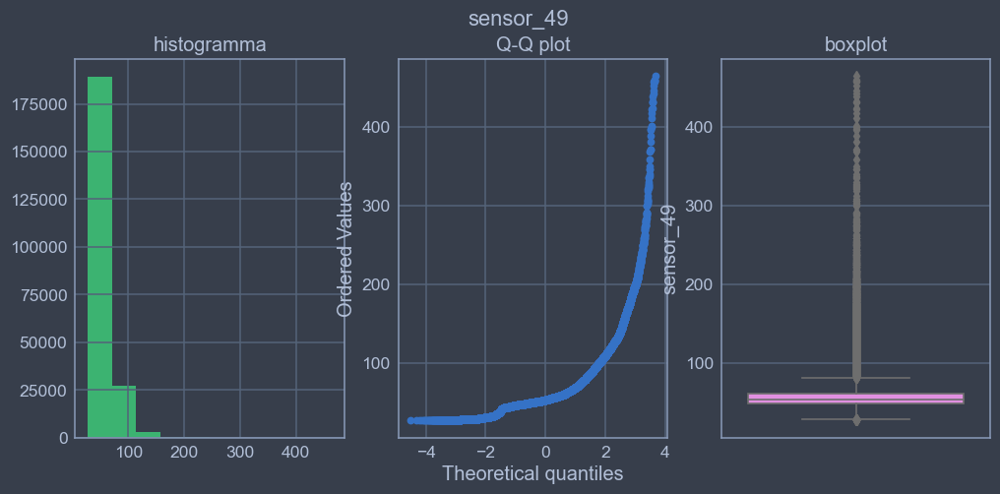

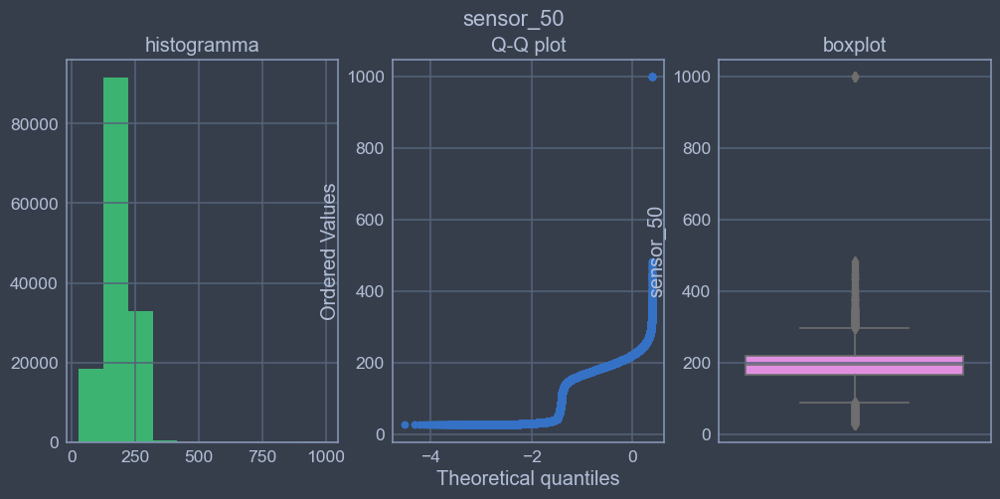

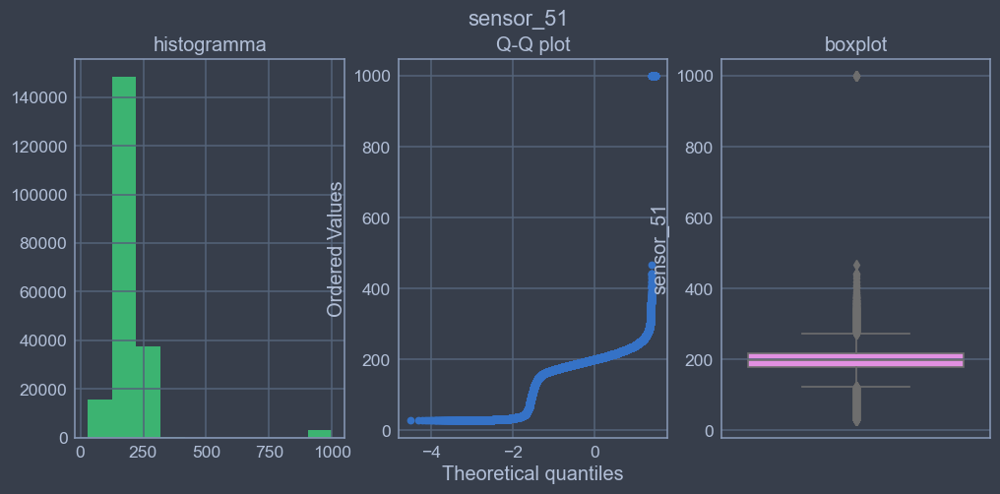

In [52]:
for i in [var for var in data_sensor if data_sensor[var].dtype == 'float64']:
    diagnostic_plots(only_sensors, i)

## After scaling

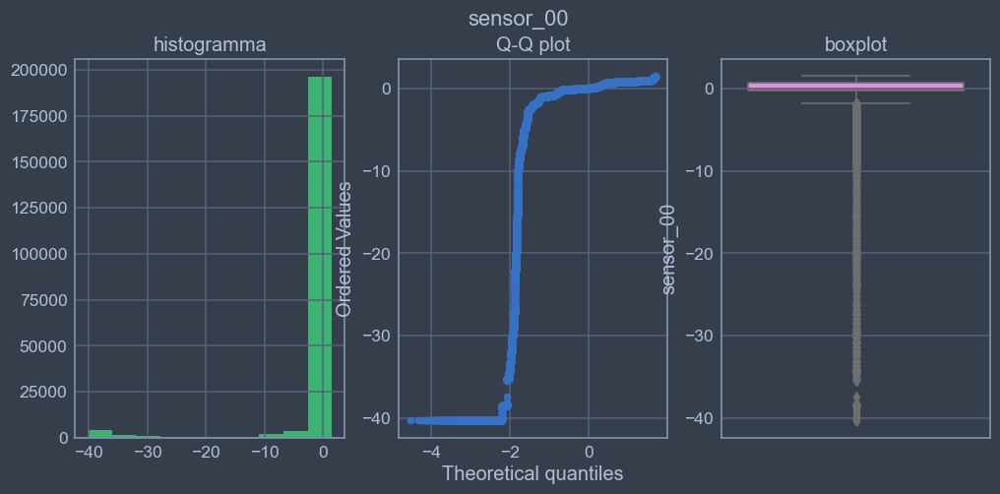

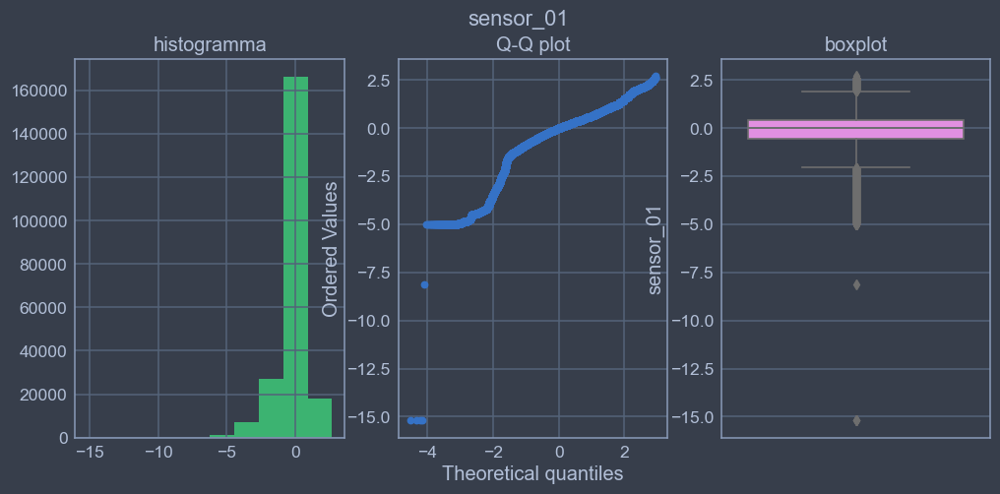

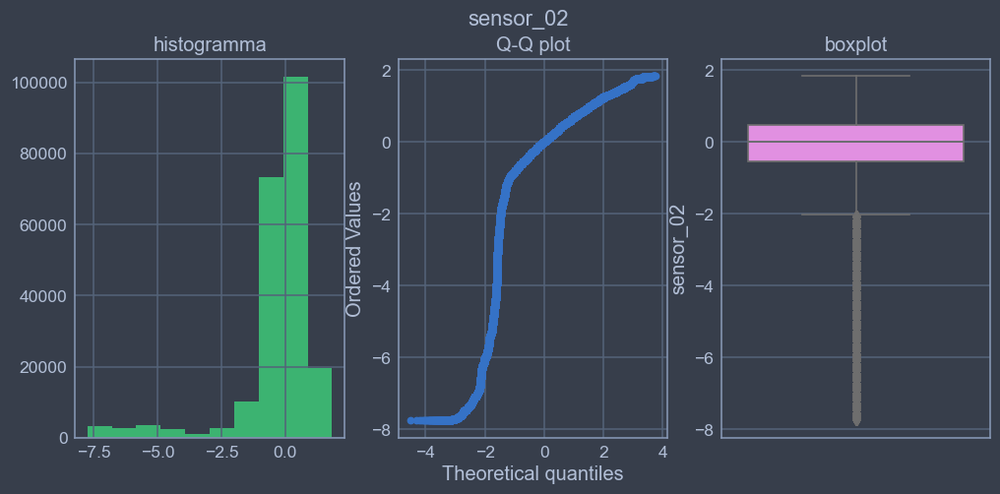

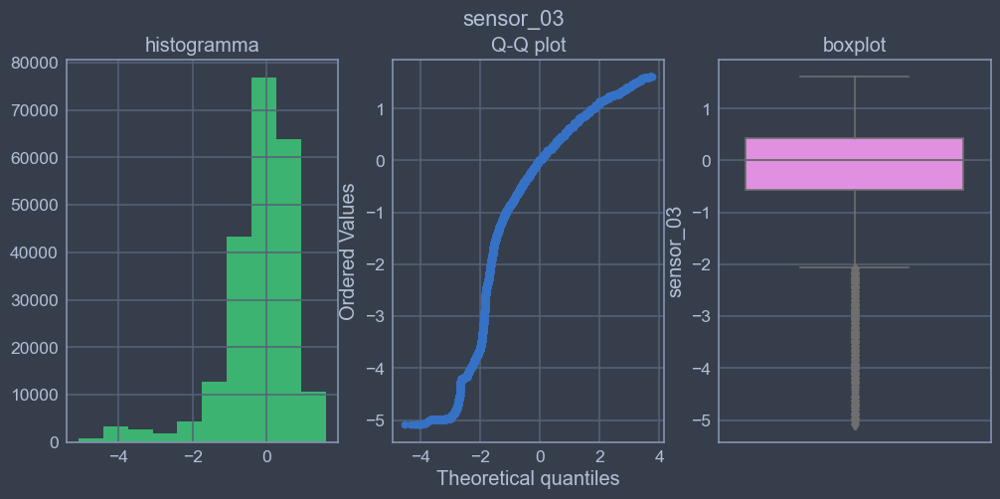

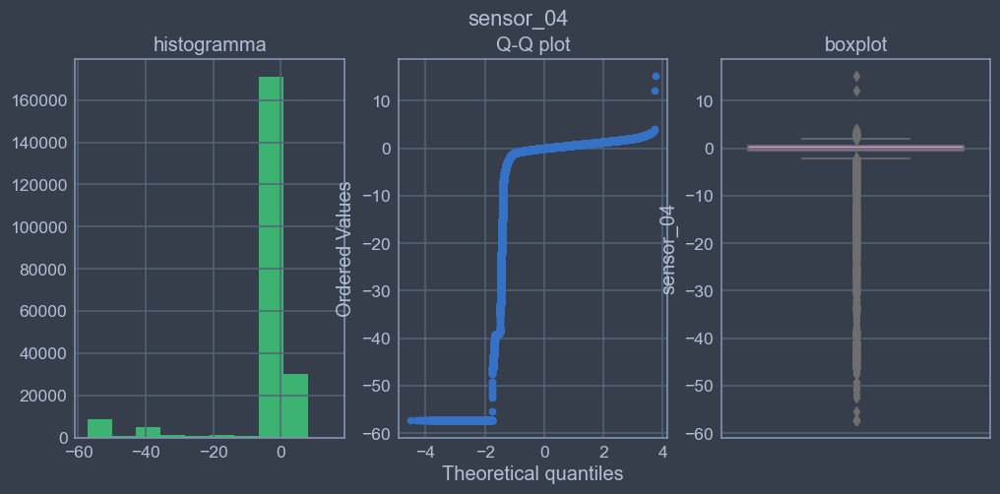

...

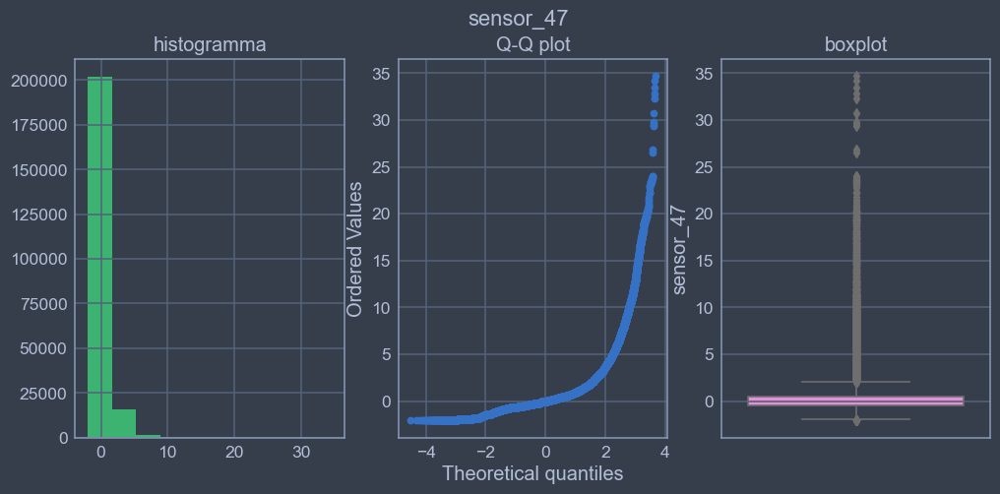

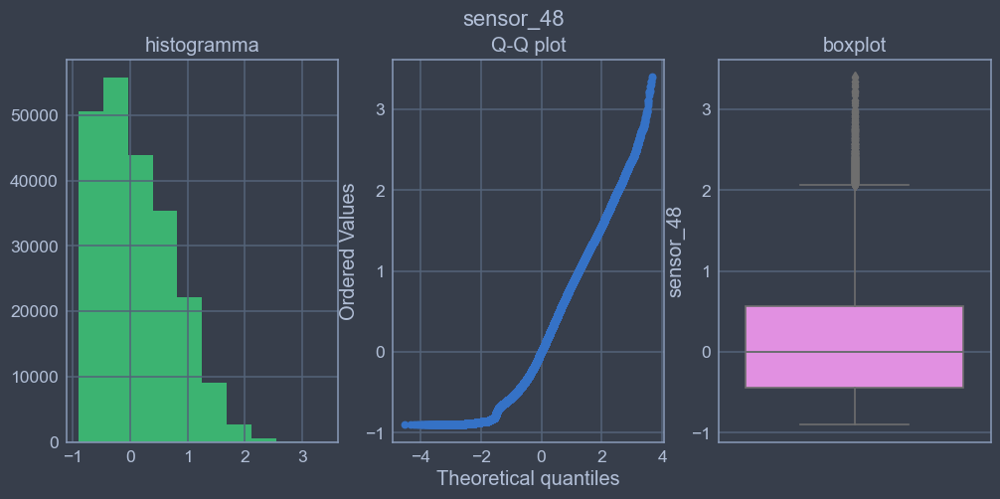

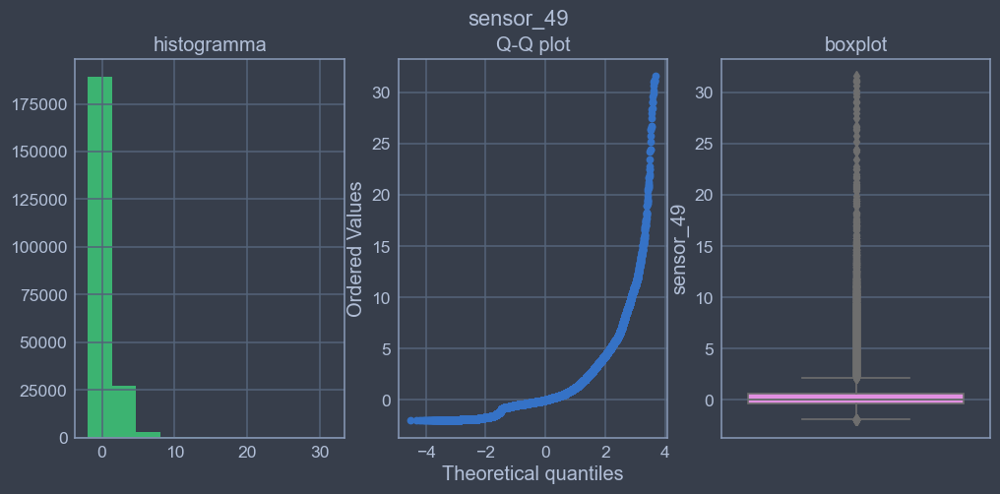

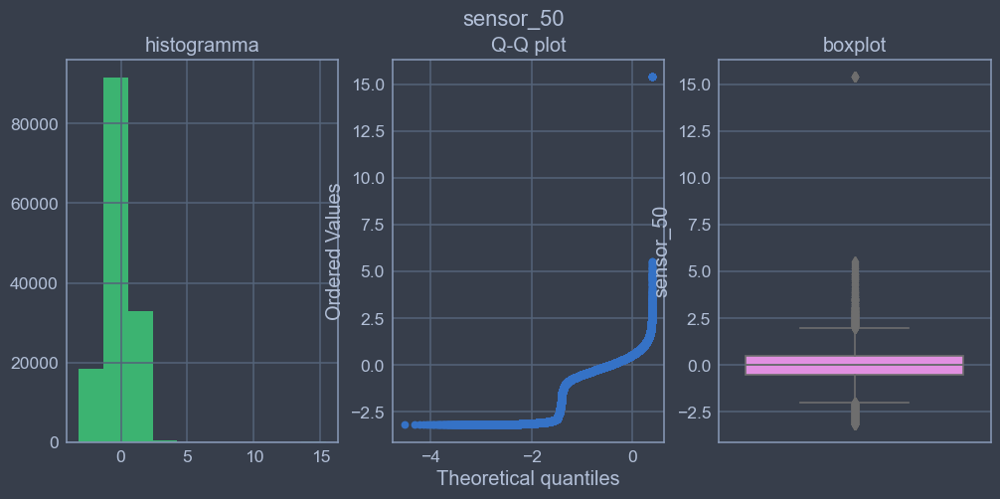

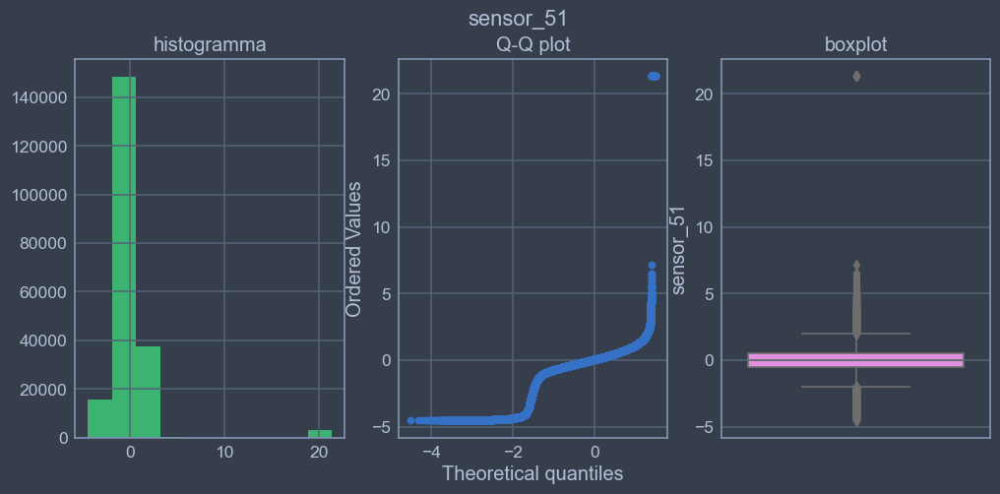

In [53]:
for i in [var for var in data_sensor if data_sensor[var].dtype == 'float64']:
    diagnostic_plots(sensor_robust, i)

## Comparing scalers

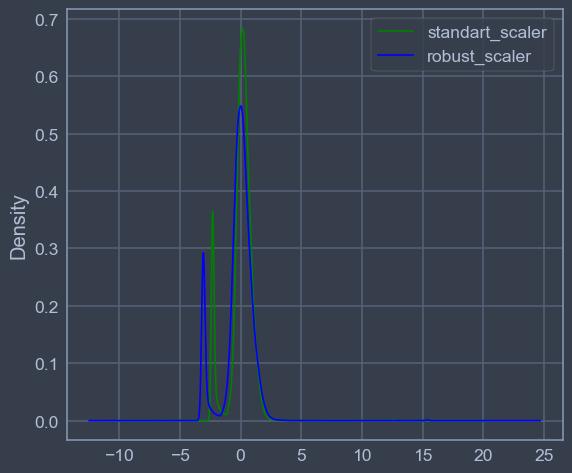

In [54]:
fig = plt.figure()
ax = fig.add_subplot(111)
sensor_standard['sensor_50'].plot(kind = 'kde', ax = ax, color = 'green')
sensor_robust['sensor_50'].plot(kind = 'kde', ax = ax, color = 'blue')
lines, labels = ax.get_legend_handles_labels()
ax.legend(lines, ['standart_scaler', 'robust_scaler'], loc = 'best')

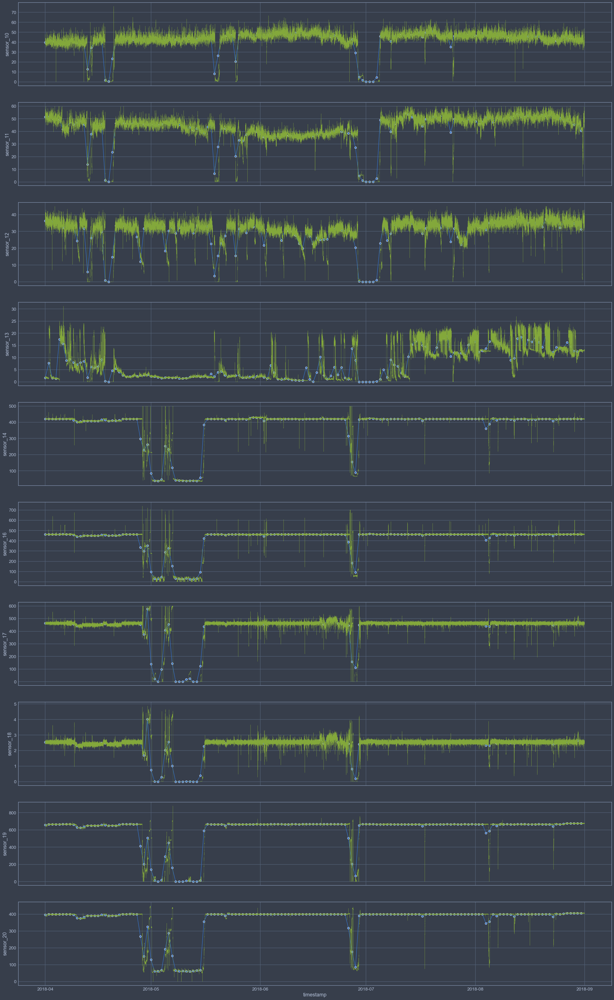

In [55]:
fig,ax = plt.subplots(ncols = 1, nrows = data_sensor_2.shape[1], sharex = True, figsize = (30,50))
j = 0
for i in data_sensor_2.columns:
    sns.lineplot(data = data_sensor_2[i].resample('D').mean(), marker = 'o', ax = ax[j])
    sns.lineplot(x = data_sensor_2.index, y = i, data = data_sensor_2, linewidth = 0.3, ax=  ax[j])
    j += 1

    We have tried two ways of normalizing the data. 
    Standart scaler is one of the most popular and uinte the mean to 0. 
    Robust scaler can theoretically hide the outliers.

    We can see that the distribution is a little better after implementing Robust Scaler, that is why we decided to use it in the furhter steps

## Missing data imputation

### MeanMedianImputer

In [56]:
median_imputer = MeanMedianImputer(imputation_method = 'median')
sensor_robust_median = median_imputer.fit_transform(sensor_robust)

In [57]:
sensor_robust_median.isnull().sum()

sensor_00    0
sensor_01    0
sensor_02    0
sensor_03    0
sensor_04    0
sensor_05    0
sensor_06    0
sensor_07    0
sensor_08    0
sensor_09    0
sensor_10    0
sensor_11    0
sensor_12    0
sensor_13    0
sensor_14    0
sensor_16    0
sensor_17    0
sensor_18    0
sensor_19    0
sensor_20    0
sensor_21    0
sensor_22    0
sensor_23    0
sensor_24    0
sensor_25    0
sensor_26    0
sensor_27    0
sensor_28    0
sensor_29    0
sensor_30    0
sensor_31    0
sensor_32    0
sensor_33    0
sensor_34    0
sensor_35    0
sensor_36    0
sensor_37    0
sensor_38    0
sensor_39    0
sensor_40    0
sensor_41    0
sensor_42    0
sensor_43    0
sensor_44    0
sensor_45    0
sensor_46    0
sensor_47    0
sensor_48    0
sensor_49    0
sensor_50    0
sensor_51    0
dtype: int64

## KNNImputer

In [58]:
imputer_KNN = KNNImputer()
sensor_robust_knn = imputer_KNN.fit_transform(sensor_robust)

In [59]:
sensor_robust_knn = pd.DataFrame(sensor_robust_knn, columns = sensor_robust.columns)

In [60]:
sensor_robust_knn.isnull().sum()

sensor_00    0
sensor_01    0
sensor_02    0
sensor_03    0
sensor_04    0
sensor_05    0
sensor_06    0
sensor_07    0
sensor_08    0
sensor_09    0
sensor_10    0
sensor_11    0
sensor_12    0
sensor_13    0
sensor_14    0
sensor_16    0
sensor_17    0
sensor_18    0
sensor_19    0
sensor_20    0
sensor_21    0
sensor_22    0
sensor_23    0
sensor_24    0
sensor_25    0
sensor_26    0
sensor_27    0
sensor_28    0
sensor_29    0
sensor_30    0
sensor_31    0
sensor_32    0
sensor_33    0
sensor_34    0
sensor_35    0
sensor_36    0
sensor_37    0
sensor_38    0
sensor_39    0
sensor_40    0
sensor_41    0
sensor_42    0
sensor_43    0
sensor_44    0
sensor_45    0
sensor_46    0
sensor_47    0
sensor_48    0
sensor_49    0
sensor_50    0
sensor_51    0
dtype: int64

## Compare NaN imputers

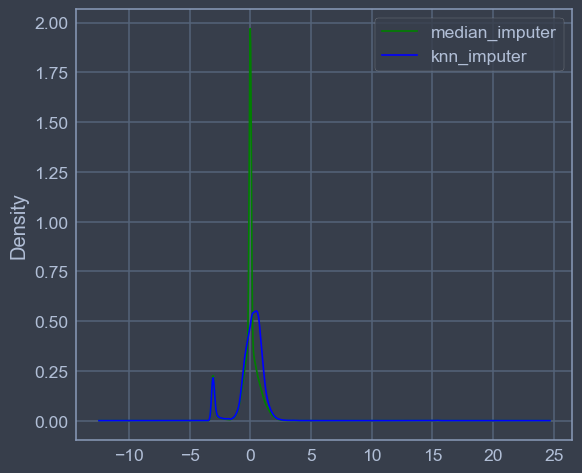

In [61]:
fig = plt.figure()
ax = fig.add_subplot(111)
sensor_robust_median['sensor_50'].plot(kind = 'kde', ax = ax, color = 'green')
sensor_robust_knn['sensor_50'].plot(kind = 'kde', ax = ax, color = 'blue')
ax.legend(lines, ['median_imputer', 'knn_imputer'], loc = 'best')

# STEP 4: Feature Selection

# Filtering methods

    First lets use basic methods and check are theere Constant, Quassi-constant, dubplicated or multicorrelated variables.

## Constant variables

In [62]:
constant_selector = DropConstantFeatures(tol = 1, variables = None, missing_values = 'raise')
constant_selector.fit(sensor_robust_knn)
print("Amount of constant features in the dataset: {}".format(len(constant_selector.features_to_drop_)))

Amount of constant features in the dataset: 0


    We can see that there are no Concstant features in the dataset

## Quassi - Constant variables

In [63]:
quassi_constant_selector = DropConstantFeatures(tol = 0.95, variables = None, missing_values = 'raise')
quassi_constant_selector.fit(sensor_robust_knn)
print("Amount of quassi-constant features in the dataset: {}".format(len(quassi_constant_selector.features_to_drop_)))

Amount of quassi-constant features in the dataset: 0


    We can see that there are no quassi-constant features in the dataset

## Dubplicated variables

In [64]:
duplicated_selector = DropDuplicateFeatures(variables = None, missing_values = 'ignore')
duplicated_selector.fit(sensor_robust_knn)
print("Amount of duplicated features in the dataset: {}".format(len(duplicated_selector.features_to_drop_)))

Amount of duplicated features in the dataset: 0


    We can see that there are no duplicated features in the dataset

## Correlated variables

In [65]:
correlated_selector = SmartCorrelatedSelection(
    variables=None,
    method = 'pearson',
    threshold = 0.8, 
    missing_values = 'ignore',
    selection_method = 'variance',
)

correlated_selector.fit(sensor_robust_knn)
print("Amount of correlated features in the dataset: {}".format(len(correlated_selector.features_to_drop_)))

Amount of correlated features in the dataset: 23


    We can see that there 23 correlated features

In [66]:
correlated_features = correlated_selector.features_to_drop_
correlated_features

['sensor_00',
 'sensor_02',
 'sensor_06',
 'sensor_07',
 'sensor_08',
 'sensor_10',
 'sensor_11',
 'sensor_12',
 'sensor_14',
 'sensor_16',
 'sensor_17',
 'sensor_18',
 'sensor_19',
 'sensor_21',
 'sensor_22',
 'sensor_23',
 'sensor_24',
 'sensor_25',
 'sensor_26',
 'sensor_32',
 'sensor_33',
 'sensor_34',
 'sensor_39']

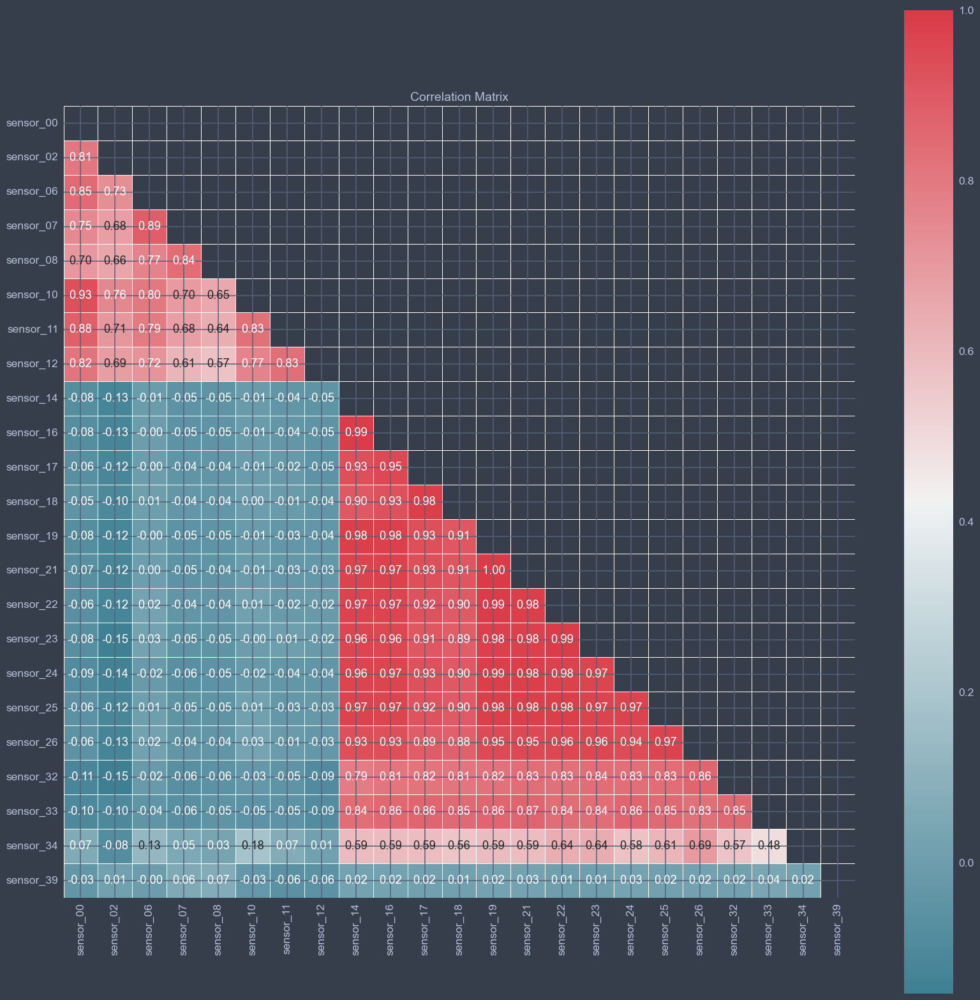

In [67]:
corr_table = sensor_robust_knn[correlated_features].corr()
corrmat(corr_table, figsize = (20, 20), inflate = False)
plt.show()

    We can see that particular sensors correlated a lot, while others not at all

In [68]:
sensor_robust_knn_drop_correlated = correlated_selector.transform(sensor_robust_knn)
sensor_robust_knn_drop_correlated

,sensor_01,sensor_03,sensor_04,sensor_05,sensor_09,sensor_13,sensor_20,sensor_27,sensor_28,sensor_29,...,sensor_42,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51
timestamp,,,,,,,,,,,,,,,,,,,,,
2018-04-01 00:00:00,-0.328768,0.842104,0.157893,0.080740,-0.444547,-0.110278,-0.184237,-0.743729,-0.696864,0.533476,...,-0.812501,-0.148149,-0.103449,3.142855,0.567568,-0.576923,0.160465,1.155556,0.939228,0.107692
2018-04-01 00:01:00,-0.328768,0.842104,0.157893,0.080740,-0.444547,-0.110278,-0.184237,-0.743729,-0.696864,0.533476,...,-0.812501,-0.148149,-0.103449,3.142855,0.567568,-0.576923,0.160465,1.155556,0.939228,0.107692
2018-04-01 00:02:00,-0.246575,0.877193,0.568422,-0.185701,-1.111214,-0.107882,0.278098,-0.457274,-0.722200,0.669797,...,-0.812501,-0.185186,-0.137931,3.107141,0.594594,-0.576923,0.144186,1.111111,0.906077,0.169230
2018-04-01 00:03:00,-0.328768,0.877192,-0.410531,0.129134,0.000000,-0.119281,-0.126953,-0.222734,-0.718619,0.557721,...,-0.875000,-0.296297,-0.172414,3.035712,0.594594,-0.576923,0.144186,1.088889,0.889504,0.153845
2018-04-01 00:04:00,-0.315070,0.877192,0.347364,0.092556,0.000000,-0.110059,0.568774,-0.973583,-0.696722,0.621223,...,-0.875000,-0.222222,-0.206896,3.071426,0.648648,-0.499999,0.162791,1.066667,0.922652,0.107692
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-31 23:55:00,-0.136987,-0.438595,0.189473,-1.004568,1.222273,0.912950,3.096908,2.246567,-0.719776,-0.354713,...,-1.187502,-0.666667,3.310343,1.499998,0.324324,-0.192308,0.597675,7.755555,0.749172,0.899999
2018-08-31 23:56:00,-0.136987,-0.438595,-0.157899,-0.890934,0.555453,0.910914,3.333737,2.311203,-0.649547,-0.239572,...,-1.250000,-0.666667,3.137931,1.285713,0.297297,-0.230769,0.609303,7.955557,0.749172,0.899999
2018-08-31 23:57:00,-0.136987,-0.438595,-0.610533,-0.757354,0.555453,0.906179,3.748319,2.389177,-0.642831,-0.320341,...,-1.187502,-0.555556,2.965517,1.071427,0.297297,-0.230769,0.637209,7.888887,0.749172,0.923077


# STEP 5: Putting all together

In [69]:
pipeline_feature_engineering = Pipeline(steps = [
    #Feature enigineering
    ('scaler', RobustScaler()),
    ('imputer', KNNImputer()),
    #Feature selection
    ('correlated_selector', SmartCorrelatedSelection(
                variables=None,
                method = 'pearson',
                threshold = 0.8, 
                missing_values = 'ignore',
                selection_method = 'variance',
    )),
])

In [70]:
sensor_preprocessed = pipeline_feature_engineering.fit_transform(only_sensors)

In [71]:
sensor_preprocessed

,sensor_01,sensor_03,sensor_04,sensor_05,sensor_09,sensor_13,sensor_20,sensor_27,sensor_28,sensor_29,...,sensor_42,sensor_43,sensor_44,sensor_45,sensor_46,sensor_47,sensor_48,sensor_49,sensor_50,sensor_51
timestamp,,,,,,,,,,,,,,,,,,,,,
2018-04-01 00:00:00,-0.328768,0.842104,0.157893,0.080740,-0.444547,-0.110278,-0.184237,-0.743729,-0.696864,0.533476,...,-0.812501,-0.148149,-0.103449,3.142855,0.567568,-0.576923,0.160465,1.155556,0.939228,0.107692
2018-04-01 00:01:00,-0.328768,0.842104,0.157893,0.080740,-0.444547,-0.110278,-0.184237,-0.743729,-0.696864,0.533476,...,-0.812501,-0.148149,-0.103449,3.142855,0.567568,-0.576923,0.160465,1.155556,0.939228,0.107692
2018-04-01 00:02:00,-0.246575,0.877193,0.568422,-0.185701,-1.111214,-0.107882,0.278098,-0.457274,-0.722200,0.669797,...,-0.812501,-0.185186,-0.137931,3.107141,0.594594,-0.576923,0.144186,1.111111,0.906077,0.169230
2018-04-01 00:03:00,-0.328768,0.877192,-0.410531,0.129134,0.000000,-0.119281,-0.126953,-0.222734,-0.718619,0.557721,...,-0.875000,-0.296297,-0.172414,3.035712,0.594594,-0.576923,0.144186,1.088889,0.889504,0.153845
2018-04-01 00:04:00,-0.315070,0.877192,0.347364,0.092556,0.000000,-0.110059,0.568774,-0.973583,-0.696722,0.621223,...,-0.875000,-0.222222,-0.206896,3.071426,0.648648,-0.499999,0.162791,1.066667,0.922652,0.107692
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-31 23:55:00,-0.136987,-0.438595,0.189473,-1.004568,1.222273,0.912950,3.096908,2.246567,-0.719776,-0.354713,...,-1.187502,-0.666667,3.310343,1.499998,0.324324,-0.192308,0.597675,7.755555,0.749172,0.899999
2018-08-31 23:56:00,-0.136987,-0.438595,-0.157899,-0.890934,0.555453,0.910914,3.333737,2.311203,-0.649547,-0.239572,...,-1.250000,-0.666667,3.137931,1.285713,0.297297,-0.230769,0.609303,7.955557,0.749172,0.899999
2018-08-31 23:57:00,-0.136987,-0.438595,-0.610533,-0.757354,0.555453,0.906179,3.748319,2.389177,-0.642831,-0.320341,...,-1.187502,-0.555556,2.965517,1.071427,0.297297,-0.230769,0.637209,7.888887,0.749172,0.923077


    We can see that all steps are done correctly and the everything wors fine insede of the pipeline

# STEP 6: Deviding dataset to train and test sets

    Because we are working with Timeline series data, it is important to preserve the time sequence and that it why we will use the technique of sliding window to devide the dataset to train and test sets

In [72]:
exaples_to_prepare = 2000

window_width_input_minutes = 60
window_width_output_minutes = 60 * 24

start_minute = 0

In [73]:
single_ipnut_window = sensor_preprocessed[start_minute: start_minute + window_width_input_minutes]
single_ipnut_window = np.array(single_ipnut_window)
single_ipnut_window.shape

(60, 28)

In [74]:
single_input_vector = single_ipnut_window.flatten()
single_input_vector.shape

(1680,)

In [75]:
def check_for_pump_failure(start, stop):
    
    for minute in range(start, stop):
        machinse_status = data_sensor['machine_status'].iloc[minute]
        
        if machinse_status in ['BROKEN', 'RECOVERING']:
            return 1
    return 0

In [76]:
total_rows = sensor_preprocessed.shape[0]

max_row = total_rows - window_width_input_minutes - window_width_output_minutes
max_row

218820

In [77]:
training_pairs = []

for sample in range(0, exaples_to_prepare):
    if sample % 100 == 0:
        print('Collected examples: {}'.format(sample))
    
    working_pump = False
    
    while not working_pump:
        random_minute = np.random.randint(0, max_row)
        start = random_minute
        
        stop = start + window_width_input_minutes
        
        if check_for_pump_failure(start, stop) == 0:
            working_pump = True
    
    single_ipnut_window = sensor_preprocessed[start: stop]
    single_ipnut_window = np.array(single_ipnut_window)
    single_input_vector = single_ipnut_window.flatten()
    
    start = random_minute + window_width_input_minutes
    stop = start + window_width_output_minutes
    
    output_value = check_for_pump_failure(start, stop)
    training_pairs.append((single_input_vector, output_value))

Collected examples: 0
Collected examples: 100
Collected examples: 200
Collected examples: 300
Collected examples: 400
Collected examples: 500
Collected examples: 600
Collected examples: 700
Collected examples: 800
Collected examples: 900
Collected examples: 1000
Collected examples: 1100
Collected examples: 1200
Collected examples: 1300
Collected examples: 1400
Collected examples: 1500
Collected examples: 1600
Collected examples: 1700
Collected examples: 1800
Collected examples: 1900


In [78]:
training_pairs[0][0].shape

(1680,)

In [79]:
input_vector_len = training_pairs[0][0].shape[0]

output_vector_len = 1

In [80]:
D = np.zeros((exaples_to_prepare, input_vector_len + output_vector_len))

print('Shape of D: {}'.format(D.shape))

Shape of D: (2000, 1681)


In [81]:
for i in range(0, exaples_to_prepare):
    (X, y) = training_pairs[i]
    
    D[i, 0: input_vector_len] = X
    D[i, input_vector_len] = y

In [82]:
D

array([[ 0.34246672,  0.12280775,  0.2631559 , ..., -0.43646404,
        -0.27692426,  0.        ],
       [ 1.19178183, -0.2982458 ,  0.40000029, ...,  1.14033189,
        -0.40000053,  0.        ],
       [-1.32876797, -1.26315659,  1.02105089, ..., -0.23756843,
        -0.56153946,  1.        ],
       ...,
       [-0.16438216, -0.84210242,  0.41052765, ..., -1.33149141,
        -0.85384826,  0.        ],
       [-0.58904108, -0.56140311, -6.84213807, ..., -1.45303756,
        -0.44000138,  1.        ],
       [-0.61643998, -0.73684186, -0.27369056, ...,  0.9337021 ,
        -0.39230959,  0.        ]])

In [83]:
train_examples = int(exaples_to_prepare / 2)

X_train = D[0: train_examples, 0: input_vector_len]
y_train = D[0: train_examples, input_vector_len]

In [84]:
X_test = D[train_examples: , 0: input_vector_len]

y_test = D[train_examples: , input_vector_len]

In [85]:
X_train.shape

(1000, 1680)

In [86]:
y_test.shape

(1000,)

## Building  ML models

In [87]:
random_forest = RandomForestClassifier()
gradient_boost = GradientBoostingClassifier()
Knn = KNeighborsClassifier()
Svc = SVC()
XGB = XGBClassifier()

models = {'RandomForest': random_forest,
          'GradientBoosting': gradient_boost,
          'KNN': Knn,
          'SVC': Svc,
          'XGB': XGB}

## Fitting the ML models

In [88]:
accuracy_scores_train = {}
accuracy_scores_test = {}

for name, model in models.items():
    model.fit(X_train, y_train)
    accuracy_scores_train[name] = model.score(X_train, y_train)
    accuracy_scores_test[name] = model.score(X_test, y_test)

In [89]:
accuracy_scores_train

{'RandomForest': 1.0,
 'GradientBoosting': 1.0,
 'KNN': 0.967,
 'SVC': 0.945,
 'XGB': 1.0}

In [90]:
accuracy_scores_test

{'RandomForest': 0.968,
 'GradientBoosting': 0.962,
 'KNN': 0.962,
 'SVC': 0.95,
 'XGB': 0.966}

# STEP 8: Result analysis

## Function to display results

In [91]:
def show_matrix_results(first_bar, first_bar_label, second_bar, second_bar_label, labels, width, plot_title):
    fig, ax = plt.subplots(figsize=(14,7), facecolor=(.94, .94, .94))
    plt.tight_layout()
    
    y = np.arange(len(labels))  # Label locations
    ax.barh(y + width/2, first_bar, width, label=first_bar_label, color='cornflowerblue')
    ax.barh(y - width/2, second_bar, width, label=second_bar_label, color='lightgreen')
    
    title = plt.title(plot_title, pad=20, fontsize=18, color = 'black')
    
    rects = ax.patches
    for rect in rects:
        x_value = rect.get_width()
        y_value = rect.get_y() + rect.get_height() / 2
        space = 5
        ha = 'left'
        plt.annotate(
            np.round(x_value, 3),                      
            (x_value, y_value),         
            xytext=(space, 0),          
            textcoords='offset points',
            va='center',                
            ha=ha,)
    
    ax.set_yticklabels(labels, color = 'black')
    leg = plt.legend(loc='best')

    
    plt.yticks(np.arange(min(y), max(y)+1, 1.0))

In [92]:
results = pd.DataFrame({
            'Models_name': accuracy_scores_train.keys(),
            'Accuracy_score(train)': accuracy_scores_train.values(),
            'Accuracy_score(test)': accuracy_scores_test.values()
})

results.sort_values(by = 'Accuracy_score(test)', ascending = False)

,Models_name,Accuracy_score(train),Accuracy_score(test)
0,RandomForest,1.000,0.968
4,XGB,1.000,0.966
1,GradientBoosting,1.000,0.962
2,KNN,0.967,0.962
3,SVC,0.945,0.950


C:\Users\Kim Stanislav\AppData\Local\Temp\ipykernel_17348\21241256.py:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, color = 'black')


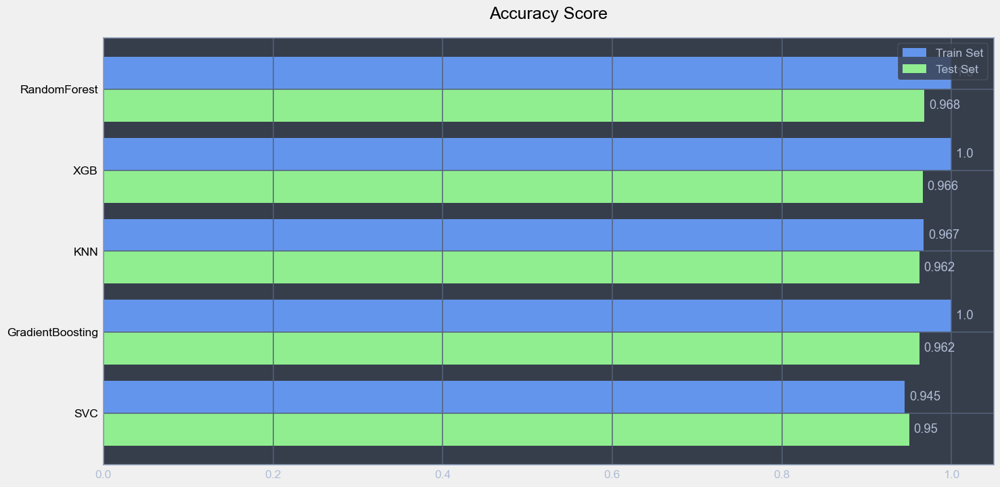

In [93]:
accuracy_scores_test = dict(sorted(accuracy_scores_test.items(), key = lambda item: item[1]))
sorted_keys = accuracy_scores_test.keys()
accuracy_scores_train = {key: accuracy_scores_train[key] for key in sorted_keys}

first_bar = accuracy_scores_train.values()
first_bar_label = 'Train Set'
second_bar = accuracy_scores_test.values()
second_bar_label = 'Test Set'
labels = sorted_keys
width = 0.4
plot_title = 'Accuracy Score'


show_matrix_results(first_bar, first_bar_label, second_bar, second_bar_label, labels, width, plot_title) 

# STEP 9: Fine-tuning hyperparameters of short-list models

## Setting parameters

In [94]:
param_grid_XGB = {
    'n_estimators': [100, 200, 300],
    'max_depth': [2, 3, 4, 5],
}

param_grid_GradientBoosting = {
    'n_estimators': [100, 200],
    'max_depth': [2, 3, 4, 5]
}

param_grid_RandomForest = {
    'n_estimators': [100, 200],
    'max_depth': [2, 3, 4, 5],
    'min_samples_split': [2, 3, 5]
}

## Building GridSearchCV

In [95]:
grid_search_XGB = GridSearchCV(
    XGB,
    param_grid_XGB,
    cv = 7,
    n_jobs = -1,
    scoring = 'accuracy'
)

grid_search_GradientBoosting = GridSearchCV(
    gradient_boost, 
    param_grid_GradientBoosting,
    cv = 7,
    n_jobs = -1,
    scoring = 'accuracy'
)

grid_search_RandomForest = GridSearchCV(
    random_forest,
    param_grid_RandomForest,
    cv = 7,
    n_jobs = -1,
    scoring = 'accuracy'
)

grid_search_dist = {
    'XGB': grid_search_XGB,
    'GradientBoosting': grid_search_GradientBoosting,
    'RandomForest': grid_search_RandomForest
}

## Fitting GridSearchCV

In [96]:
grid_search_best_params = {}

for name, grid_search in grid_search_dist.items():
    grid_search.fit(X_train, y_train)
    print('Best parameters for {0}: {1}'.format(name, grid_search.best_params_))
    print('Accuracy for {0}: {1}'.format(name, grid_search.best_score_))
    print()
    print('=' * 60)
    print()
    grid_search_best_params[name] = grid_search.best_params_

Best parameters for XGB: {'max_depth': 5, 'n_estimators': 200}
Accuracy for XGB: 0.9530117769554389


Best parameters for GradientBoosting: {'max_depth': 5, 'n_estimators': 100}
Accuracy for GradientBoosting: 0.9520057407381352


Best parameters for RandomForest: {'max_depth': 5, 'min_samples_split': 5, 'n_estimators': 200}
Accuracy for RandomForest: 0.949008737741132




# STEP 10: Result analysis of models with tuned hyperparameteres

## Assigning models with tuned hyperparameters

In [97]:
XGB = grid_search_XGB.best_estimator_
GradientBoosting = grid_search_GradientBoosting.best_estimator_
RandomForest = grid_search_RandomForest.best_estimator_

## Making predictions

In [98]:
models_dict = {
    'XGB': XGB,
    'GradientBoosting': GradientBoosting,
    'RandomForest': RandomForest
}
                
train_preds = {}
test_preds = {}

train_proba_pred = {}
test_proba_pred = {}

for name, model in models_dict.items():
    #predictions for train set
    train_preds[name] = model.predict(X_train)
    train_proba_pred[name] = model.predict_proba(X_train)
    #predictions for test set
    test_preds[name] = model.predict(X_test)
    test_proba_pred[name] = model.predict_proba(X_test)

# STEP 11: Displaying results of evaluation metrics

## Classification Report

In [99]:
classification_report_train = {}
classification_report_test = {}

def classification_report_scores(y_train, y_test, train_preds, test_preds):
    for name, predict in train_preds.items():
        print(name + ' train set', "\n", classification_report(y_train, predict, zero_division = 0), "\n")
    print('=' * 60)
    print()
    for name, predict in test_preds.items():
        print(name + ' test set', "\n", classification_report(y_test, predict, zero_division = 0), "\n")

classification_report_scores(y_train, y_test, train_preds, test_preds)

XGB train set 
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       941
         1.0       1.00      1.00      1.00        59

    accuracy                           1.00      1000
   macro avg       1.00      1.00      1.00      1000
weighted avg       1.00      1.00      1.00      1000
 

GradientBoosting train set 
               precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       941
         1.0       1.00      1.00      1.00        59

    accuracy                           1.00      1000
   macro avg       1.00      1.00      1.00      1000
weighted avg       1.00      1.00      1.00      1000
 

RandomForest train set 
               precision    recall  f1-score   support

         0.0       0.97      1.00      0.98       941
         1.0       1.00      0.47      0.64        59

    accuracy                           0.97      1000
   macro avg       0.98      0.74      0.81      1000


## Confusion matrix

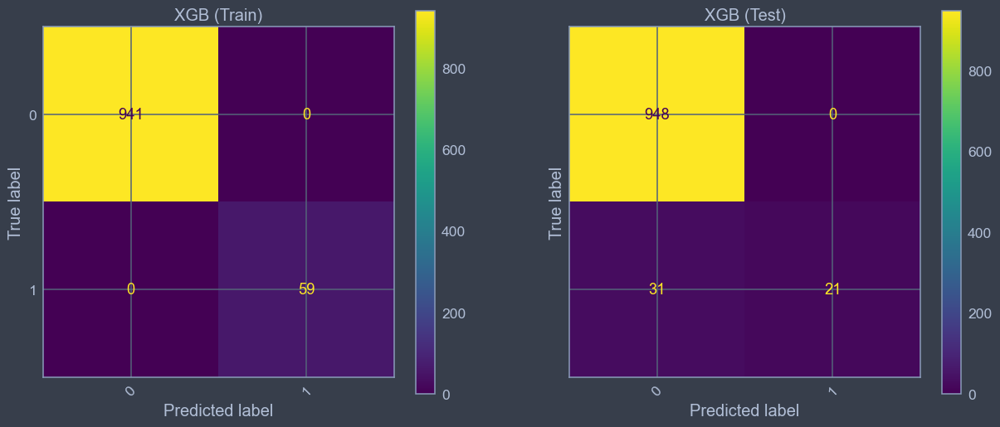

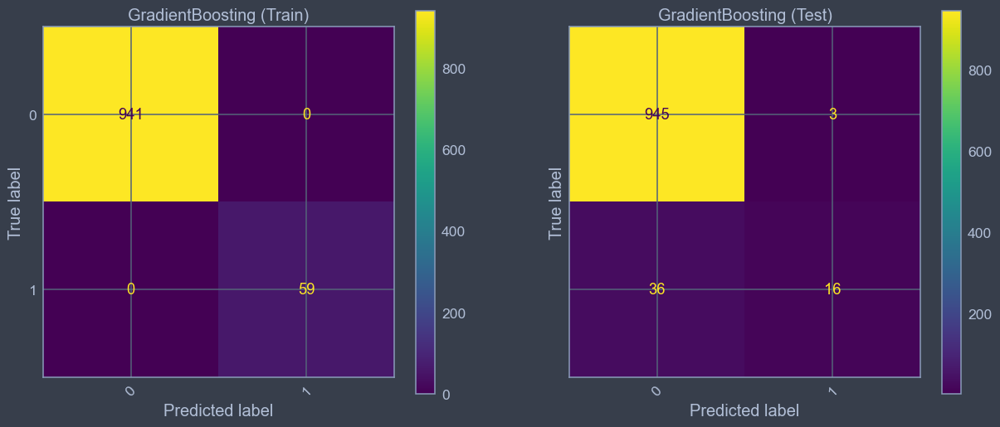

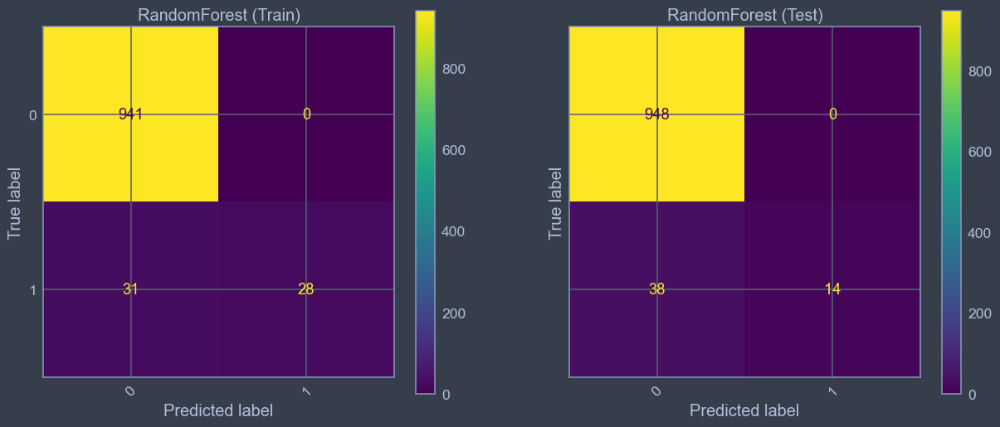

In [100]:
def draw_confusion_matrix(models, y_tr, y_te, train_pred, test_pred):
    for name, result in models.items():
        f, axes = plt.subplots(1, 2, figsize=(15, 6), sharey='row')
        
        for i in range(2):
            if i == 0:
                cf_matrix = confusion_matrix(y_tr, train_pred[name])
                title = name + ' (Train)'
            elif i == 1:
                cf_matrix = confusion_matrix(y_te, test_pred[name])
                title = name + ' (Test)'
            disp = ConfusionMatrixDisplay(cf_matrix)
            disp.plot(ax = axes[i], xticks_rotation=45)
            disp.ax_.set_title(title)
            
draw_confusion_matrix(models_dict, y_train, y_test, train_preds, test_preds)

## Precision

In [101]:
precision_scores_train = {}
precision_scores_test = {}

def precision_scores(train_preds, test_preds):
    for name, predict in train_preds.items():
        precision_scores_train[name] = precision_score(y_train, predict, zero_division = 0)
    for name, predict in test_preds.items():
        precision_scores_test[name] = precision_score(y_test, predict, zero_division = 0)
    return precision_scores_train, precision_scores_test

precision_scores_train, precision_scores_test = precision_scores(train_preds, test_preds)
precision_scores_train, precision_scores_test

({'XGB': 1.0, 'GradientBoosting': 1.0, 'RandomForest': 1.0},
 {'XGB': 1.0, 'GradientBoosting': 0.8421052631578947, 'RandomForest': 1.0})

C:\Users\Kim Stanislav\AppData\Local\Temp\ipykernel_17348\21241256.py:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, color = 'black')


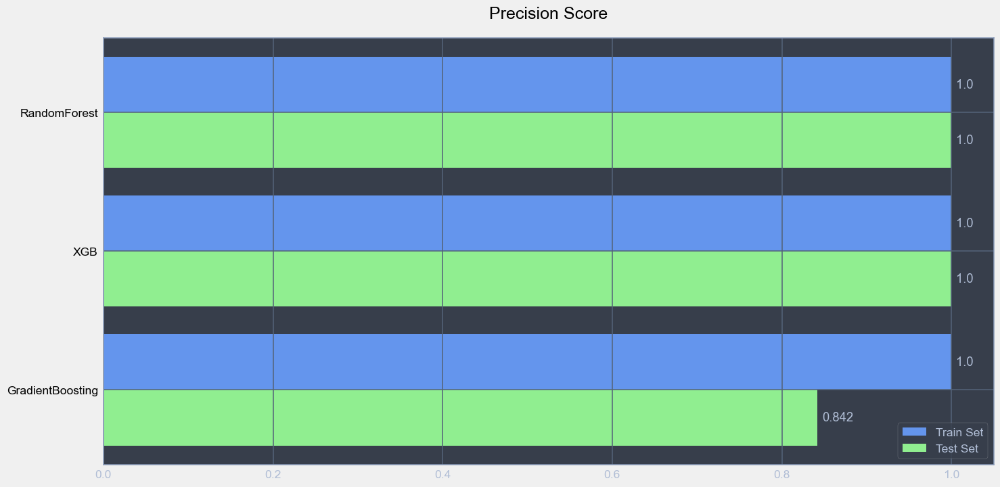

In [102]:
precision_scores_test = dict(sorted(precision_scores_test.items(), key=lambda item: item[1]))
sorted_keys = precision_scores_test.keys()
precision_scores_train = {key:precision_scores_train[key] for key in sorted_keys}

first_bar = list(precision_scores_train.values())
first_bar_label = 'Train Set'
second_bar = list(precision_scores_test.values())
second_bar_label = 'Test Set'
labels = list(precision_scores_train.keys())
width = 0.4
plot_title = 'Precision Score'

show_matrix_results(first_bar, first_bar_label, second_bar, second_bar_label, labels, width, plot_title)  

## Recall

In [103]:
recall_scores_train = {}
recall_scores_test = {}

def recall_scores(y_train, y_test, train_preds, test_preds):
    for name, predict in train_preds.items():
        recall_scores_train[name] = recall_score(y_train, predict)
    for name, predict in test_preds.items():
        recall_scores_test[name] = recall_score(y_test, predict)
    return recall_scores_train, recall_scores_test

recall_scores_train, recall_scores_test = recall_scores(y_train, y_test, train_preds, test_preds)
recall_scores_train, recall_scores_test

({'XGB': 1.0, 'GradientBoosting': 1.0, 'RandomForest': 0.4745762711864407},
 {'XGB': 0.40384615384615385,
  'GradientBoosting': 0.3076923076923077,
  'RandomForest': 0.2692307692307692})

C:\Users\Kim Stanislav\AppData\Local\Temp\ipykernel_17348\21241256.py:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, color = 'black')


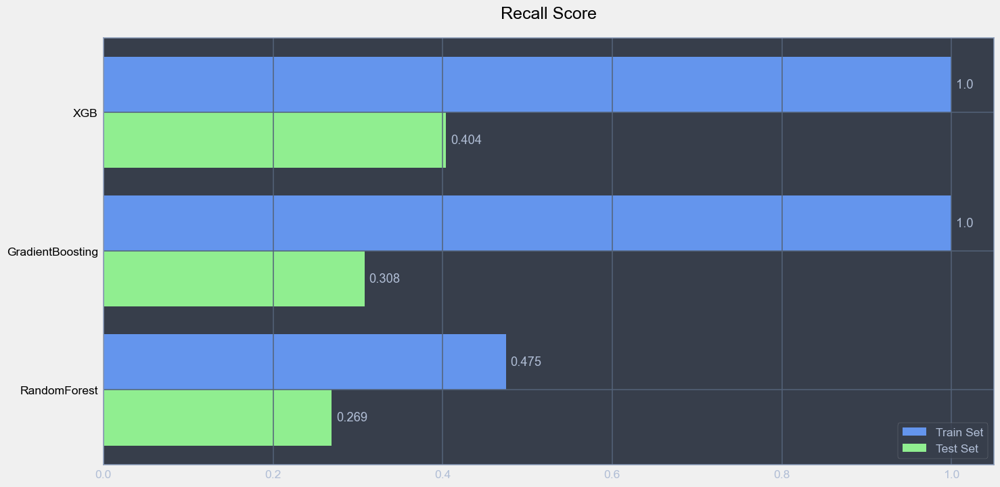

In [104]:
recall_scores_test = dict(sorted(recall_scores_test.items(), key=lambda item: item[1]))
sorted_keys = recall_scores_test.keys()
recall_scores_train = {key:recall_scores_train[key] for key in sorted_keys}

first_bar = list(recall_scores_train.values())
first_bar_label = 'Train Set'
second_bar = list(recall_scores_test.values())
second_bar_label = 'Test Set'
labels = list(recall_scores_train.keys())
width = 0.4
plot_title = 'Recall Score'

show_matrix_results(first_bar, first_bar_label, second_bar, second_bar_label, labels, width, plot_title)  

## F1

In [105]:
f1_scores_train = {}
f1_scores_test = {}

def f1_scores(y_train, y_test, train_preds, test_preds):
    for name, predict in train_preds.items():
        f1_scores_train[name] = f1_score(y_train, predict)
    for name, predict in test_preds.items():
        f1_scores_test[name] = f1_score(y_test, predict)
    return f1_scores_train, f1_scores_test

f1_scores_train, f1_scores_test = f1_scores(y_train, y_test, train_preds, test_preds)
f1_scores_train, f1_scores_test

({'XGB': 1.0, 'GradientBoosting': 1.0, 'RandomForest': 0.6436781609195402},
 {'XGB': 0.5753424657534247,
  'GradientBoosting': 0.4507042253521127,
  'RandomForest': 0.42424242424242425})

C:\Users\Kim Stanislav\AppData\Local\Temp\ipykernel_17348\21241256.py:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, color = 'black')


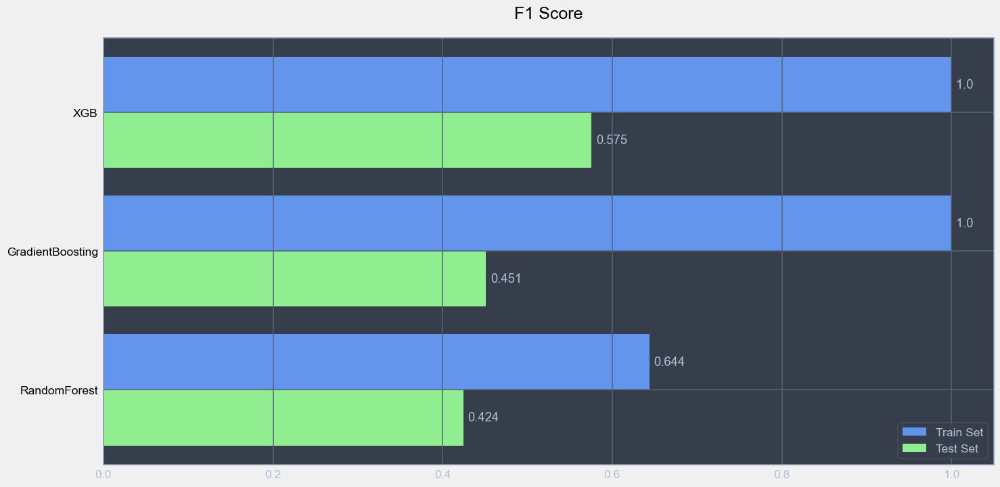

In [106]:
f1_scores_test = dict(sorted(f1_scores_test.items(), key=lambda item: item[1]))
sorted_keys = f1_scores_test.keys()
f1_scores_train = {key:f1_scores_train[key] for key in sorted_keys}

first_bar = list(f1_scores_train.values())
first_bar_label = 'Train Set'
second_bar = list(f1_scores_test.values())
second_bar_label = 'Test Set'
labels = list(f1_scores_train.keys())
width = 0.4
plot_title = 'F1 Score'

show_matrix_results(first_bar, first_bar_label, second_bar, second_bar_label, labels, width, plot_title) 

    We can notice that the results for Recall and F1 are really bad and probably happens because of the lack of data of broken machines. We have such low results because the recall and f1 for the broken status is significantly low as there are only 7 broken status.

## Accuracy

In [107]:
accuracy_scores_train = {}
accuracy_scores_test = {}

def accuracy_scores(y_train, y_test, train_preds, test_preds):
    for name, predict in train_preds.items():
        accuracy_scores_train[name] = accuracy_score(y_train, predict)
    for name, predict in test_preds.items():
        accuracy_scores_test[name] = accuracy_score(y_test, predict)
    return accuracy_scores_train, accuracy_scores_test

accuracy_scores_train, accuracy_scores_test = accuracy_scores(y_train, y_test, train_preds, test_preds)
accuracy_scores_train, accuracy_scores_test

({'XGB': 1.0, 'GradientBoosting': 1.0, 'RandomForest': 0.969},
 {'XGB': 0.969, 'GradientBoosting': 0.961, 'RandomForest': 0.962})

C:\Users\Kim Stanislav\AppData\Local\Temp\ipykernel_17348\21241256.py:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, color = 'black')


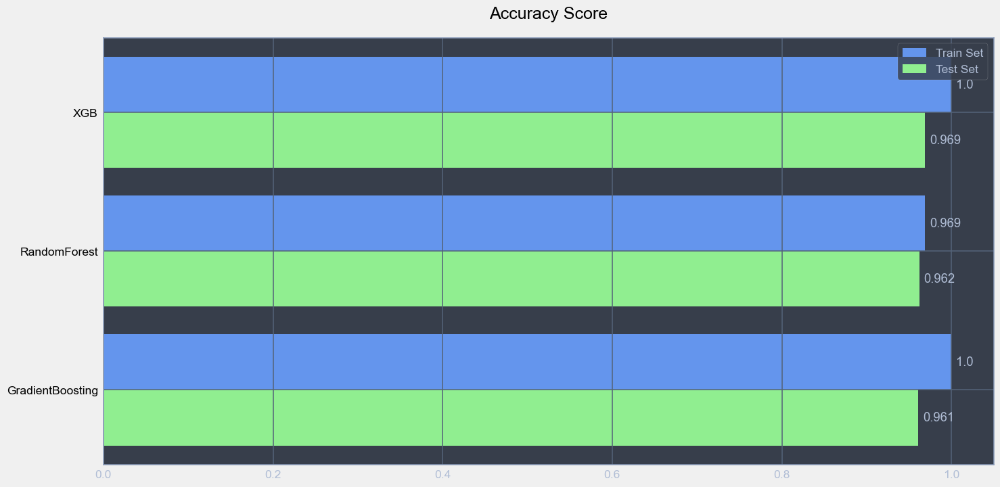

In [108]:
accuracy_scores_test = dict(sorted(accuracy_scores_test.items(), key=lambda item: item[1]))
sorted_keys = accuracy_scores_test.keys()
accuracy_scores_train = {key:accuracy_scores_train[key] for key in sorted_keys}

first_bar = list(accuracy_scores_train.values())
first_bar_label = 'Train Set'
second_bar = list(accuracy_scores_test.values())
second_bar_label = 'Test Set'
labels = list(accuracy_scores_train.keys())
width = 0.4
plot_title = 'Accuracy Score'

show_matrix_results(first_bar, first_bar_label, second_bar, second_bar_label, labels, width, plot_title)  

## Roc-auc

In [109]:
roc_auc_scores_train = {}
roc_auc_scores_test = {}

def roc_auc_scores(train_proba_pred, test_proba_pred):
    for name, predict in train_proba_pred.items():
        roc_auc_scores_train[name] = roc_auc_score(y_train, predict[:, 1])
    for name, predict in test_proba_pred.items():
        roc_auc_scores_test[name] = roc_auc_score(y_test, predict[:, 1])
    return roc_auc_scores_train, roc_auc_scores_test

roc_auc_scores_train, roc_auc_scores_test = roc_auc_scores(train_proba_pred, test_proba_pred)
roc_auc_scores_train, roc_auc_scores_test

({'XGB': 1.0,
  'GradientBoosting': 0.9999999999999999,
  'RandomForest': 0.9993335614834561},
 {'XGB': 0.9694701395650762,
  'GradientBoosting': 0.9647841609866927,
  'RandomForest': 0.9617413177539759})

C:\Users\Kim Stanislav\AppData\Local\Temp\ipykernel_17348\21241256.py:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(labels, color = 'black')


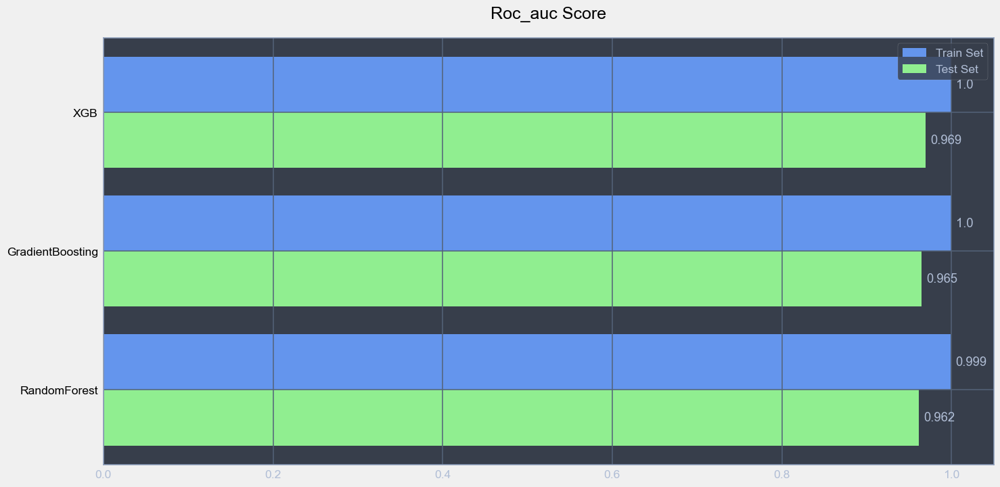

In [110]:
roc_auc_scores_test = dict(sorted(roc_auc_scores_test.items(), key=lambda item: item[1]))
sorted_keys = roc_auc_scores_test.keys()
roc_auc_scores_train = {key:roc_auc_scores_train[key] for key in sorted_keys}

first_bar = list(roc_auc_scores_train.values())
first_bar_label = 'Train Set'
second_bar = list(roc_auc_scores_test.values())
second_bar_label = 'Test Set'
labels = list(roc_auc_scores_train.keys())
width = 0.4
plot_title = 'Roc_auc Score'

show_matrix_results(first_bar, first_bar_label, second_bar, second_bar_label, labels, width, plot_title)   

    It seems that models we trained are not really good. Because they do not generalize well and can not effectivelly predict broken labels because of the lack of data.
    If We had to choose one, I would choose Random Forest because although it does not give the highest results, it gives the most stable and consistent performance. 

# STEP 12: Training ANN (Artificial Neural Networks)

In [111]:
model = tf.keras.Sequential()

model.add(tf.keras.layers.Dense(200, activation = 'relu', input_shape = (input_vector_len, )))
model.add(tf.keras.layers.Dense(40, activation = 'relu'))
model.add(tf.keras.layers.Dense(1, activation = 'sigmoid'))

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 200)               336200    
                                                                 
 dense_1 (Dense)             (None, 40)                8040      
                                                                 
 dense_2 (Dense)             (None, 1)                 41        
                                                                 
Total params: 344,281
Trainable params: 344,281
Non-trainable params: 0
_________________________________________________________________


In [112]:
model.compile(optimizer = 'sgd', loss = tf.keras.losses.MeanSquaredError(), metrics = ['accuracy'])

In [113]:
history = model.fit(X_train, y_train, epochs = 1000)

Epoch 1/1000
32/32 [==============================] - 2s 2ms/step - loss: 0.1748 - accuracy: 0.7770
Epoch 2/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0741 - accuracy: 0.9350
Epoch 3/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0652 - accuracy: 0.9420
Epoch 4/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0610 - accuracy: 0.9410
Epoch 5/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0583 - accuracy: 0.9420
Epoch 6/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0563 - accuracy: 0.9430
Epoch 7/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0549 - accuracy: 0.9430
Epoch 8/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0536 - accuracy: 0.9440
Epoch 9/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0525 - accuracy: 0.9450
Epoch 10/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0515 - accuracy: 0.9470

32/32 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9860
Epoch 163/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9860
Epoch 164/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9860
Epoch 165/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9860
Epoch 166/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9860
Epoch 167/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0154 - accuracy: 0.9860
Epoch 168/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.9860
Epoch 169/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.9860
Epoch 170/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.9860
Epoch 171/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0153 - accuracy: 0.

32/32 [==============================] - 0s 3ms/step - loss: 0.0144 - accuracy: 0.9860
Epoch 323/1000
32/32 [==============================] - 0s 3ms/step - loss: 0.0144 - accuracy: 0.9860
Epoch 324/1000
32/32 [==============================] - 0s 3ms/step - loss: 0.0144 - accuracy: 0.9860
Epoch 325/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0144 - accuracy: 0.9860
Epoch 326/1000
32/32 [==============================] - 0s 3ms/step - loss: 0.0144 - accuracy: 0.9860
Epoch 327/1000
32/32 [==============================] - 0s 3ms/step - loss: 0.0144 - accuracy: 0.9860
Epoch 328/1000
32/32 [==============================] - 0s 3ms/step - loss: 0.0144 - accuracy: 0.9860
Epoch 329/1000
32/32 [==============================] - 0s 3ms/step - loss: 0.0144 - accuracy: 0.9860
Epoch 330/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0144 - accuracy: 0.9860
Epoch 331/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0144 - accuracy: 0.

32/32 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9860
Epoch 483/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9860
Epoch 484/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9860
Epoch 485/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9860
Epoch 486/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9860
Epoch 487/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9860
Epoch 488/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9860
Epoch 489/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9860
Epoch 490/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.9860
Epoch 491/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0142 - accuracy: 0.

32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 643/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 644/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 645/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 646/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 647/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 648/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 649/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 650/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 651/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.

32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 803/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 804/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 805/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 806/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 807/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 808/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 809/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 810/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 811/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.

32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 963/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 964/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 965/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 966/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 967/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 968/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 969/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 970/1000
32/32 [==============================] - 0s 2ms/step - loss: 0.0141 - accuracy: 0.9860
Epoch 971/1000
32/32 [==============================] - 0s 3ms/step - loss: 0.0141 - accuracy: 0.

# STEP 13: Result analysis of ANN

In [114]:
preds = model.predict(X_test)
preds = np.where(preds < 0.5, 0.0, 1.0)

32/32 [==============================] - 0s 1ms/step


In [115]:
ConfusionMatrixDisplay?

## Confusion matrix

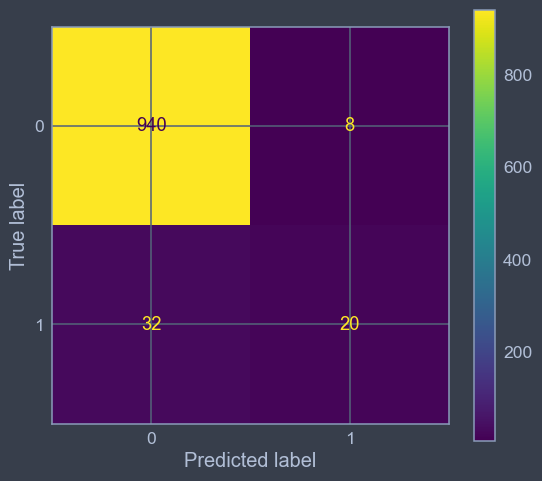

In [116]:
cm = confusion_matrix(y_test, preds)

cm = ConfusionMatrixDisplay(cm)
cm.plot()

## Classification Report

In [117]:
print(classification_report(y_test, preds))

              precision    recall  f1-score   support

         0.0       0.97      0.99      0.98       948
         1.0       0.71      0.38      0.50        52

    accuracy                           0.96      1000
   macro avg       0.84      0.69      0.74      1000
weighted avg       0.95      0.96      0.95      1000



## Loss plot

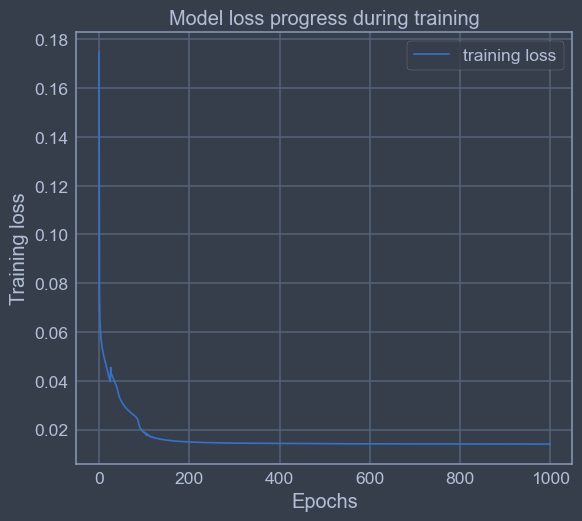

In [118]:
plt.plot(history.history['loss'])
plt.title('Model loss progress during training')
plt.xlabel('Epochs')
plt.ylabel('Training loss')
plt.legend(['training loss'])

    We can see that the loss has dropped to it's minimum about 0.450 almost immidiately and then nothing has changed

## Accuracy plot

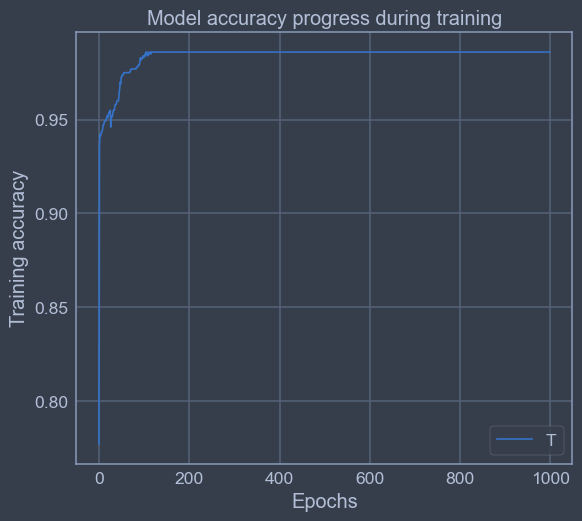

In [119]:
plt.plot(history.history['accuracy'])
plt.title('Model accuracy progress during training')
plt.xlabel('Epochs')
plt.ylabel('Training accuracy')
plt.legend('Training accuracy')

    We can see that the accuracy has reached it's maximum at about 95% almost immidiately and then nothing has changed

# STEP 14: Saving everything

## Saving KNNImputer

In [120]:
dump(KNNImputer, open('knn_imputer.pkl', 'wb'))

## Saving models

In [121]:
dump(XGB, open('XGB.pkl', 'wb'))
dump(GradientBoosting, open('GradientBoosting.pkl', 'wb'))
dump(RandomForest, open('RandomForest.pkl', 'wb'))

## Saving ANN

In [122]:
model_json = model.to_json()
with open(r'C:\Users\Kim Stanislav\OneDrive\Рабочий стол\AI courses KV_DW_JL_5\AI_project_4\pump_failure_ANN_model.json', 'w') as json_file:
    json_file.write(model_json)

# STEP 15: Conclusion

##  Data Analysis

    After completing the data analysis step, we found several insights. 
    
        1. all sensors data are numerical types (float64) and the 'machine_status' variable (target) is categorical

        2. more than 93% of all the datasets the machining status was "NORMAL"

        3. there are only 7 accidents with broken pumps

        4. 'NORMAL' takes more than 93 percent of the 'machine_process' variables, while 'RECOVERING' takes almost 7% and "BROKEN" takes less than 1%

        5. 4 out of 7 breakouts were fixed under the next 24 hours. However the second and fifth breakouts took more than 50 hours (2 days). ESPECIALLY the fifth breakout which took more than 5 days to fix

        6. the amount of missing values in variable 'sensor_15' is 100% which means that there is no point in maintaining this variable, because it has no prediction power. Other variables have less than 45% of missing values which is acceptible and will be imputed in the feature preprocessing steps.

        7. there are plenty of outliers in almost all variables and it might be seen that some variables like "sensor_44" and "sensor_42" are constant, but actually they are not.'

        8. some of the independent variables have high correlation, causing so-called multicollinearity while others are not correlative at all.

        9. sensors from 0 to 10: all sensors record critically low values during July and the majority of sensors has lower values between April and May. The periods are the same with the second and fifth breakouts which took the longest time to fix. It seems that those breakouts were because of some emergancy because a lot of sensors has dropouts during these periods. while the values from sensords during other breakouts seems to be stable and calm.

        10. sensors from 11 to 20: all sensors recorded critically low values during July and the majority of sensors also had lower values in the first half of May. Sensors 10, 11 and 12 also has dropdown in the second half of April. The majority of dropouts seems to happen during the third breakout which took almost 1 day to fix and during the fifth which took 5 days.

        11. sensors from 21 to 30: all sensors recorded critically low values in the first half of May. Also there are dropdowns just before the July. The majority of dropouts seems to happen during the third breakout which took almost 1 day to fix and during the fifth which took 5 days.

        12. sensors from 31 to 40: sensors 31, 32, 33, 34, 35 and recorded critically low values in the first half of May. Some of the dropouts seemed to happen during the third breakout which took almost 1 day to fix and during the fifth which took 5 days.

        13. sensors from 41 to 52: sensor 50 has no records after the July. And sensor 51 has critically high values in the second half of June.

        
   ## Feature Engineering & Selection

    > We used Robust Scaler to handle the difference in magnitude of the variables, because of its simplicity, and because it can theoretically hide the outliers.

    > We used a multivariate type of KNN imputation called KNN imputation. After the imputation of Null values using KNN imputation, the distribution of variables has changed a little bit.

    > For feature selection we used two approaches including: 

        > Filtering methods: 

            * Constant variables

            * Quassi-Constatant variables 

            * Duplicated variables

            * Correlated variables 
            
    The filtering methods helped us to reduce the dataset's dimension because we deleted 23 variables which were correlated

    
   ## Training & Evaluating models
   
     > Because we are working with Timeseries data, it is important to preserve the time sequence and that it why we will use the technique of sliding window to divide the dataset to train and test sets.

     > We have tested 5 popular models with the same data and same preprocessing steps to then compare them and choose only fixed amounts to tune the hyperparameters. 

     > After testing 5 models, we chose only 3 best models according to the accuracy metrics 

     > Then, we used cross-validation and started to fine-tune hyperparameters to boost the performance 

     > Lastly, We have evaluated the models we built using several metrics including: 

         1. F1 score

         2. Roc-auc 

         3. Confusion Matrix 

         4. Precision

         5. Recall 

         6. Accuracy

         
    By analyzing all metrics we can tell that: 

        1. The results for Recall and F1 are really bad and probably happens because of the lack of data of broken machines. We have such low results because the recall and f1 for the broken status is significantly low as there are only 7 broken status.

        2. It seems that the models we trained are not really good. Because they do not generalize well and can not effectivelly predict broken labels because of the lack of data.

        3. If we had to choose one, I would choose Random Forest because although it does not give the highest results, it gives the most stable and consistent resu

                
   ## Training & Evaluating ANN

        1. The loss has dropped to its minimum about 0.450 almost immidiately and then nothing has changed.

        2. The accuracy has reached its maximum at about 95% almost immediately and then nothing has changed.

        3. It seems that ANN is not the best choice here, because the metrics including accuracy and confusion matrix are not the best and not better compared to the ML models. More specifically, the amount of type I and type II error higher.

        
        We tend to think that it would be better to gain more data and may be try to use different approaches to process the time series data and may be use something else for feature selection.

                
   # THANKS!!! :)